# ERA5 Lifecycle Analysis

# Import packages

In [1]:
%load_ext autoreload
%autoreload 2
import xarray as xr
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.path as mpath
import matplotlib.cm as cm
import matplotlib.patches as mpatches
from matplotlib.patches import Rectangle
import matplotlib.gridspec as gridspec
import matplotlib.colors as mcolors
from matplotlib.ticker import MaxNLocator
import seaborn as sns
import numpy as np
import pandas as pd
import scipy
import datetime
import cartopy
import cartopy.feature as cfeature
from metpy.units import units
import cartopy.crs as ccrs
import pickle
import glob
import subprocess
import dask
from joblib import Parallel, delayed
from geopy.distance import distance  
from cartopy.util import add_cyclic_point
import pyproj
from pyproj import Geod
from enum import Enum

import concurrent.futures

### Load MOAAP functions
import sys
sys.path.append('/work/aa0049/a271122/MOAAP/MOAAP/')
from src.utils import *
from src.Corrections import * 
from src.Enumerations import Month, Season, Experiments, Domains
from src.xarray_util import create_obj_from_dict,  ObjectContainer,  load_tracking_objects
from src.plot_funcs import plot_contourf_rotated_grid #, plot_unstructured_rotated_grid

from src.GridPoints import Domain
import cmocean
import os
from moviepy.video.io.ImageSequenceClip import ImageSequenceClip


/work/aa0049/a271122/MOAAP/MOAAP/src/xarray_util.py:28: AccessorRegistrationWarning: registration of accessor <class 'src.xarray_util.Accessor'> under name 'get' for type <class 'xarray.core.dataset.Dataset'> is overriding a preexisting attribute with the same name.
  class Accessor:


In [2]:
%reload_ext autoreload
## Load my functions
from ERA5_utils import *

In [3]:
dask.config.set(**{'array.slicing.split_large_chunks': True})

In [4]:
plt.rcdefaults()

In [5]:
#plt.rcParams.update({
#    'axes.titlesize': 13,        # Title size
#    'axes.labelsize': 12,         # Axis label size
#    'lines.linewidth': 2,         # Line width
#    'lines.markersize': 7,       # Marker size for lines
#    'xtick.labelsize': 14,        # X-tick label size
#    'ytick.labelsize': 14         # Y-tick label size
#})

In [6]:
ERA5_clim_path='/work/aa0049/a271122/ERA5'

In [7]:
def preprocess(ds):
    ds = ds.sel(lat=slice(30, None))
    ds = ds.sel(time=slice("1979-01-01", "2022-12-31"))
    return ds


# Define global variables

In [8]:
# Extract the rotated coordinate system from example file
ds=xr.open_dataset('/work/aa0049/a271041/spice-v2.1/chain/work/run_era5_polarres_wp3_hindcast2/post/yearly/T_2M/T_2M_2020010100-2020123123.ncz')

crs_rot = ccrs.RotatedPole(pole_longitude=ds.rotated_pole.attrs['grid_north_pole_longitude'],\
                           pole_latitude=ds.rotated_pole.attrs['grid_north_pole_latitude'])

In [9]:
class Domains(Enum):
    NORTH_ATLANTIC_JLa = Domain(north=80, south=67, east=60, west=-30)
    BEAUFORT_SIBERIAN_JLa = Domain(north=80, south=70, east=-120, west=120)
    CENTRAL_ARCTIC_JLa = Domain(north=90, south=80, east=180, west=-180)


gridspacing=0.75
lat=np.arange(-90, 90+gridspacing,gridspacing)
lon=np.arange(-180, 180+gridspacing,gridspacing)
ds_dummy = xr.Dataset({"dummy": (("lat", "lon"), np.ones([len(lat), len(lon)]))},coords={"lon": lon,"lat": lat})
dd=ds_dummy.copy()

mask_domain_CentralArctic=dd.dummy.where(dd.lat>80).notnull()
mask_domain_NorthAtlantic=dd.dummy.where((dd.lat<=80) & (dd.lat>67) & (dd.lon>-30) & (dd.lon<60)).notnull()
mask_domain_BeaufortSiberianSea1=dd.dummy.where((dd.lat<=80) & (dd.lat>70) & (dd.lon>120)).notnull()
mask_domain_BeaufortSiberianSea2=dd.dummy.where((dd.lat<=80) & (dd.lat>70) & (dd.lon<-120)).notnull()

mask_domain_BeaufortSiberianSea = mask_domain_BeaufortSiberianSea1 | mask_domain_BeaufortSiberianSea2

mask_domains = {
    "CentralArctic": {"mask": mask_domain_CentralArctic, "color": 'r',"north":90,"south":80,"east":180,"west":-180},
    "NorthAtlantic": {"mask": mask_domain_NorthAtlantic, "color": 'b',"north":80,"south":67,"east":60,"west":-30},
    "BeaufortSiberianSea": {"mask": mask_domain_BeaufortSiberianSea, "color": "gold","north":80,"south":70,"east":120,"west":-120},
}


domains = ["NorthAtlantic","CentralArctic","BeaufortSiberianSea"]

# Load Objects

In [40]:
with open('/work/aa0238/a271093/results/MOAAP/IVT_Tracking/ERA5_ICON_remapped_3x/Object_container_1979-2022_withClusters.pkl', 'rb') as f:
    objs = pickle.load(f)

In [10]:
with open('/work/aa0049/a271122/MOAAP/IVT_Tracking/ERA5/Objects_transarctic_atlantic_ERA5.pkl', 'rb') as f:
   objs_final = pickle.load(f)

In [ ]:
#Load the objects in the Object container 1979-2022 
#objs = load_tracking_objects(
#         input_path = Experiments.ERA5.value.IVTobj_out_path,
#         input_file_name_temp = 'MOAPP_ERA5_100and85ERA5perc_remapped_3x',
#         type_ = 'IVT', 
#         first_year = 1979,
#         last_year  = 2022,
#         load_clusters = True,
#         load_coordinates=True,
#         exp=Experiments.ERA5.value)

In [11]:
df_objs=define_df_objs(objs_final)

In [12]:
df_objs

,id,color
0,1,"(0.2235294117647059, 0.23137254901960785, 0.47..."
1,2,"(0.2235294117647059, 0.23137254901960785, 0.47..."
2,3,"(0.2235294117647059, 0.23137254901960785, 0.47..."
3,4,"(0.2235294117647059, 0.23137254901960785, 0.47..."
4,5,"(0.2235294117647059, 0.23137254901960785, 0.47..."
...,...,...
99783,426438,"(0.8705882352941177, 0.6196078431372549, 0.839..."
99784,426439,"(0.8705882352941177, 0.6196078431372549, 0.839..."
99785,426440,"(0.8705882352941177, 0.6196078431372549, 0.839..."
99786,426441,"(0.8705882352941177, 0.6196078431372549, 0.839..."


## Select Objects with respect to season and/or sector

In [15]:
objs_sel, ids_sel = sel_objs(objs,season='DJF')

## Extract Rotated Coordinates and Transform Coordinates

In [16]:
objs_sel_tc = extract_and_transform_rot_coords(objs_sel)

In [17]:
len(objs_sel)

17

In [ ]:
## Extract times in which track is within domains
#Only select objects that go from the Atlantic towards the Pacific region

In [18]:
objs_final = []
for nr in range(len(objs_sel)):
    NA_time=extract_domain_times(objs_sel[nr],80,67,60,-30)
    BS_time=extract_domain_times(objs_sel[nr],80,70,120,-120,True)
    CA_time=extract_domain_times(objs_sel[nr],90,80,180,-180)

    if NA_time[0] < BS_time[0] and NA_time[0] < CA_time[0] and CA_time[0] < BS_time[0]:
        objs_final.append(objs_sel[nr])

len(objs_final)

13

In [21]:
for i in range(0,13): 
    print(objs_final[i].id_.values)

40554
56275
110498
120433
220464
236303
260541
306324
320482
330480
350573
376396
390547


In [23]:
# Select all wintertime objects
objs_sel_all, ids_sel_all  = sel_all_objects(objs,'DJF')

## Plot selected objects on a map, aggregated over time

### crs_rot projection

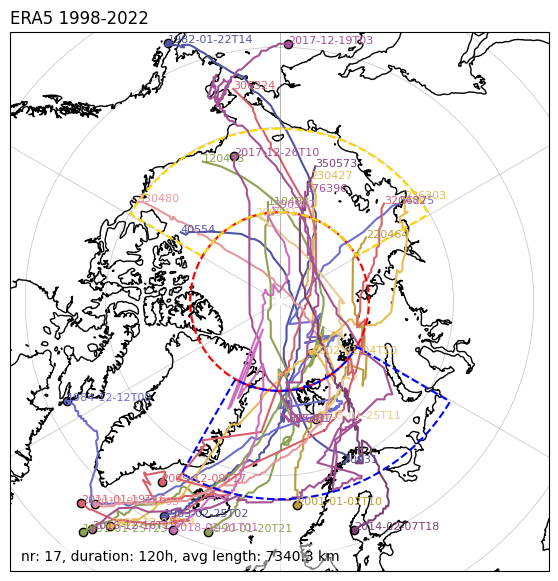

In [36]:
plot_tracks_2(objs_sel,df_objs)

In [37]:
for i in range(len(objs_final)):
    track=objs_final[i].track.values
    
    track_lats = np.array([x.lat for x in track])
    track_lons = np.array([x.lon for x in track]) 
    print(str(objs_final[i]['times'][0].values.astype('datetime64[h]')))

1983-02-25T02
1984-12-12T00
1990-01-20T21
1991-01-25T23
2001-01-02T10
2002-12-04T14
2005-01-25T11
2009-12-09T17
2011-01-19T16
2012-01-12T03
2014-02-07T18
2016-12-16T19
2018-02-21T01


### PlateCarree Projection

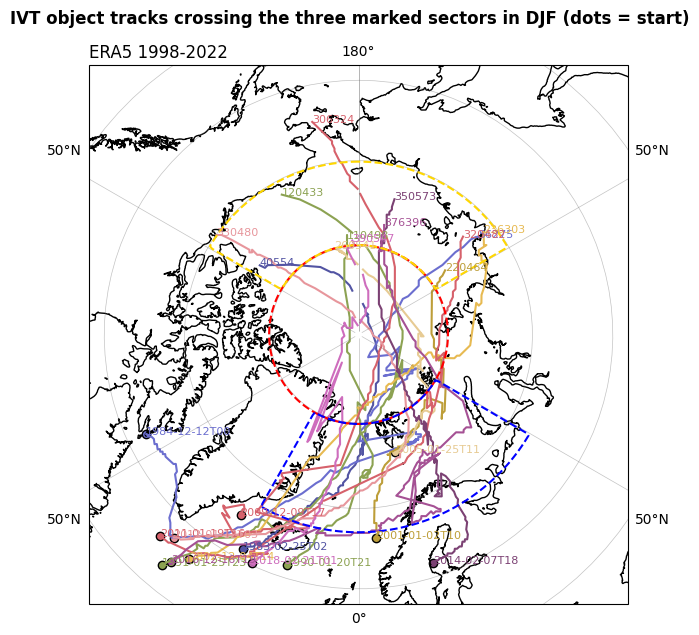

In [34]:
plot_tracks_PC(objs_final,df_objs)

## Load ERA5 Data

In [22]:
#Compute tracks for adding them to plots later 
precomputed_tracks = [split_tracks_180(obj.geo_lon.values, obj.geo_lat.values) for obj in objs_final]

## Select time chunks

In [12]:
#Select all dates in which an event appeared 
objs_times=[ds.times for ds in objs_final]

#Combine all dates in a data array 
objs_all_times = xr.concat(objs_times, dim='times').sortby('times').drop_duplicates(dim='times')

#Select all dates in which objects are in specific domains 
NA_combined_times, CA_combined_times, BS_combined_times = combine_times(objs_final)

In [13]:
month_day = get_month_day(objs_all_times)

In [14]:
NA_month_day, CA_month_day, BS_month_day = get_calendar_days(NA_combined_times, CA_combined_times,BS_combined_times)

## 1979 - 2022

#### sic

In [16]:
# Sea Ice Fraction -> fixed

In [56]:
ds_sic = xr.open_mfdataset("/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/mon/seaIce/sic/r1i1p1/sic_OImon_reanalysis_era5_r1i1p1_*.nc")
ds_sic = ds_sic.sel(time=slice("1979-01-01", "2022-12-31"))
ds_sic_DJF = ds_sic.sel(time=ds_sic.sic.time.dt.month.isin([12,1,2])).mean(dim='time')

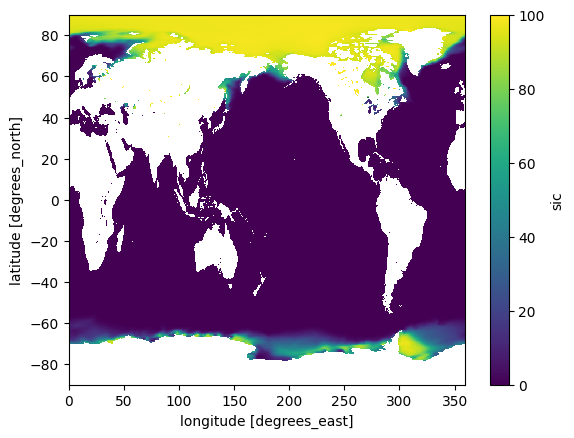

In [57]:
ds_sic_DJF.sic.plot()

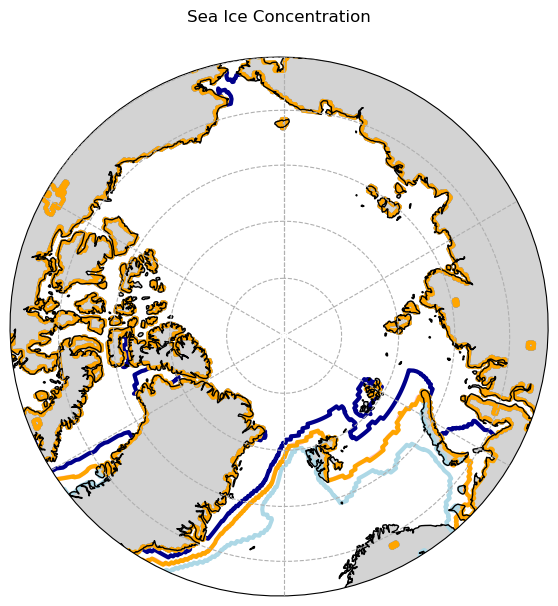

In [94]:
fig, ax = plt.subplots(1,1,figsize=(7,7),subplot_kw={'projection': ccrs.Orthographic(0,90)})

#ds_sic_DJF.sic.plot(ax=ax, transform = ccrs.PlateCarree(),cmap='Blues')
(ds_sic_DJF.sic>85).plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='darkblue',linewidths=3)
(ds_sic_DJF.sic>15).plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='lightblue',linewidths=3)
ds_sic_DJF.sic.plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='pink',linewidths=3)
(ds_sic_DJF.sic>50).plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='orange',linewidths=3)

#ds_sic_DJF.sic.plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='pink',linewidths=3)

ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
ax.gridlines(linestyle='--',zorder=3)
ax.coastlines(zorder=2)
ax.add_feature(cartopy.feature.LAND, color='lightgray',zorder=0, edgecolor='None') 

    
center, radius = [0.5, 0.5], 0.5
circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)), np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
ax.set_boundary(circle, transform = ax.transAxes)
ax.set_title("Sea Ice Concentration",y=1.05)

plt.show()

In [ ]:
(sea_ice_edge>0.85)

#### zg

In [36]:
#Load combined geopotential height dataset at 850hPa
ds_zg = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/zg/r1i1p1-085000Pa/zg_1hr_reanalysis_era5_r1i1p1-085000Pa_*.nc', chunks={"time":10})#,preprocess=preprocess)

In [37]:
ds_zg = ds_zg.sel(lat=slice(30,None))
ds_zg = ds_zg.sel(time=slice("1979-01-01","2022-12-31"))

In [38]:
# Select zg data for speficic events
zg_sel = ds_zg['zg'].sel(time=objs_all_times,method='nearest')

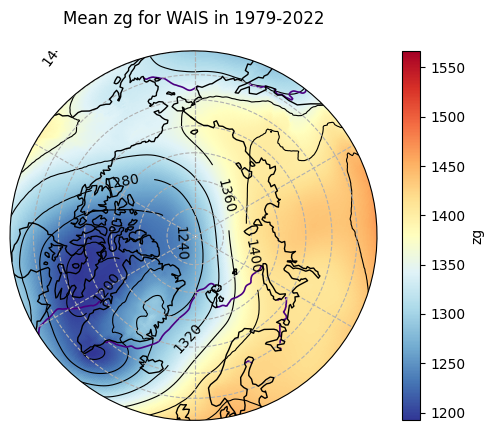

In [47]:
plot_var_and_contour(zg_sel,zg_sel,'zg')

In [48]:
## Select zg for different domains
## NA
zg_sel_NA = ds_zg['zg'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
zg_sel_CA = ds_zg['zg'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
zg_sel_BS = ds_zg['zg'].sel(time=BS_combined_times,method='nearest').mean(dim='time')

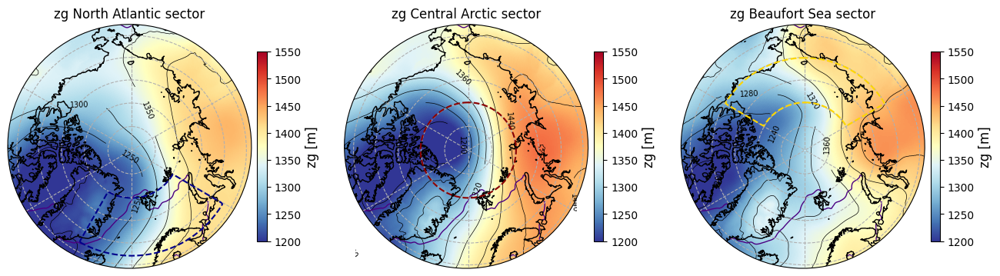

In [53]:
plot_all_domain_means(objs_final,zg_sel_NA,zg_sel_CA,zg_sel_BS,zg_sel_NA,zg_sel_CA,zg_sel_BS,"zg",f"zg [{ds_zg['zg'].units}]",vmin=1200,vmax=1550,tracks_on=False,anomaly=False,sic=True)

In [54]:
### Load Climatology

In [55]:
zg_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/zg/clim/zg_clim_day_DJF.nc')

In [56]:
#Select climatology for all combined times and domain times
zg_clim_all_times = zg_clim_DJF.where(zg_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
zg_clim_NA = zg_clim_DJF.where(zg_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
zg_clim_CA = zg_clim_DJF.where(zg_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
zg_clim_BS = zg_clim_DJF.where(zg_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)

In [57]:
zg_anomaly = zg_sel.mean(dim='times') - zg_clim_all_times['zg'].mean(dim='time')

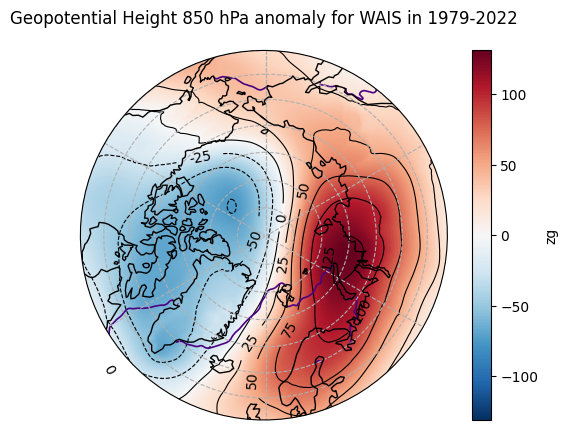

In [58]:
plot_anom_and_contour(zg_sel,zg_clim_all_times['zg'].mean(dim='time'),zg_anomaly,'Geopotential Height 850 hPa')

In [59]:
zg_NA_anom = (zg_sel_NA - zg_clim_NA['zg'].mean(dim='time'))
zg_CA_anom = (zg_sel_CA - zg_clim_CA['zg'].mean(dim='time'))
zg_BS_anom = (zg_sel_BS - zg_clim_BS['zg'].mean(dim='time'))

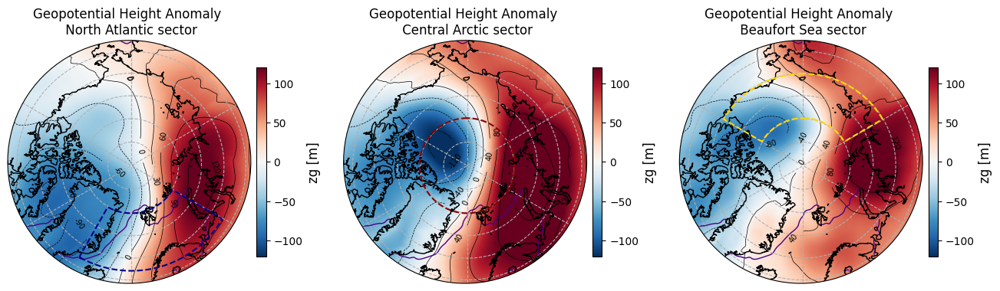

In [61]:
plot_all_domain_means(objs_final,zg_NA_anom,zg_CA_anom,zg_BS_anom,zg_NA_anom,zg_CA_anom,zg_BS_anom,"Geopotential Height Anomaly \n",f"zg [{ds_zg['zg'].units}]",vmin=-120,vmax=120,tracks_on=False,contour_on=True,sic=True)

#### tas

In [56]:
ds_tas = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/tas/r1i1p1/tas_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_tas = ds_tas.sel(lat=slice(30,None))
ds_tas = ds_tas.sel(time=slice("1998-01-01","2022-12-31"))

In [58]:
tas_sel = ds_tas['tas'].sel(time=objs_all_times,method='nearest')

In [59]:
## Select tas for domains
## NA
tas_sel_NA = ds_tas['tas'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
tas_sel_CA = ds_tas['tas'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
tas_sel_BS = ds_tas['tas'].sel(time=BS_combined_times,method='nearest').mean(dim='time')

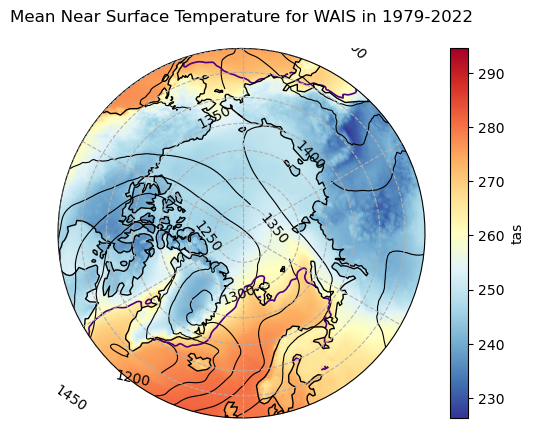

In [60]:
#Total tas for all object times (filtered) 
plot_var_and_contour(tas_sel,zg_sel,'Near Surface Temperature')

In [ ]:
#### Load Climatology

In [84]:
tas_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/tas/clim/clim_day_DJF_noHist.nc')

In [62]:
#Select climatology for all combined times and domain times
clim_all_times = tas_clim_DJF.where(tas_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
clim_NA = tas_clim_DJF.where(tas_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
clim_CA = tas_clim_DJF.where(tas_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
clim_BS = tas_clim_DJF.where(tas_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)

In [65]:
# Compute Anomaly for the times in which tracks exist
tas_anomaly_new = tas_sel.mean(dim='times') - clim_all_times['tas'].mean(dim='time')

# Compute Anomaly for the domain times
tas_NA_anom = tas_sel_NA - clim_NA['tas'].mean(dim='time')
tas_CA_anom = tas_sel_CA - clim_CA['tas'].mean(dim='time')
tas_BS_anom = tas_sel_BS - clim_BS['tas'].mean(dim='time')

In [ ]:
plot_anom_and_contour(tas_sel,clim_all_times['tas'].mean(dim='time'),zg_sel.mean(dim='times'),'Near Surface Temperature')

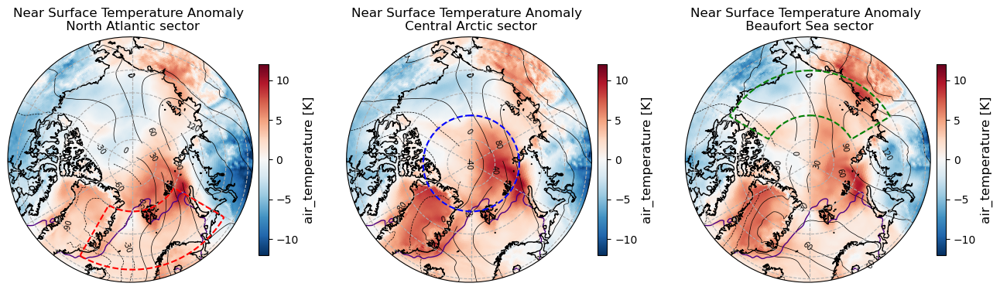

In [67]:
plot_all_domain_means(objs_final,tas_NA_anom,tas_CA_anom,tas_BS_anom,zg_NA_anom,zg_CA_anom,zg_BS_anom,"Near Surface Temperature Anomaly \n",f"air_temperature [{ds_tas['tas'].units}]",vmin=-12,vmax=12,tracks_on=False,contour_on=True,sic = True)

#### pr

In [47]:
#precipitation
ds_pr = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/pr/r1i1p1/pr_1hr_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_pr = ds_pr.sel(lat=slice(30,None))
ds_pr = ds_pr.sel(time=slice("1979-01-01","2022-12-31"))

In [114]:
pr_sel = ds_pr['pr'].sel(time=objs_all_times,method='nearest')

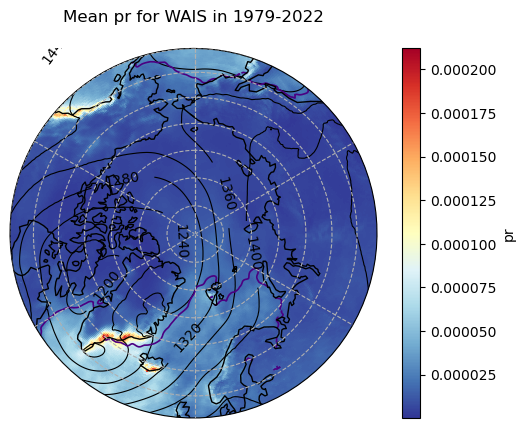

In [128]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(pr_sel,zg_sel,'pr')

In [129]:
## Select pr for domains
## NA
pr_sel_NA = ds_pr['pr'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
pr_sel_CA = ds_pr['pr'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
pr_sel_BS = ds_pr['pr'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [130]:
###Load Climatology

pr_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/pr/clim/pr_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
pr_clim_all_times = pr_clim_DJF.where(pr_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
pr_clim_NA = pr_clim_DJF.where(pr_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
pr_clim_CA = pr_clim_DJF.where(pr_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
pr_clim_BS = pr_clim_DJF.where(pr_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [131]:
# Compute Anomaly for the times in which tracks exist
pr_anomaly = pr_sel.mean(dim='times') - pr_clim_all_times['pr'].mean(dim='time')

# Compute Anomaly for the domain times
pr_anom_NA = pr_sel_NA - pr_clim_NA['pr'].mean(dim='time')
pr_anom_CA = pr_sel_CA - pr_clim_CA['pr'].mean(dim='time')
pr_anom_BS = pr_sel_BS - pr_clim_BS['pr'].mean(dim='time')

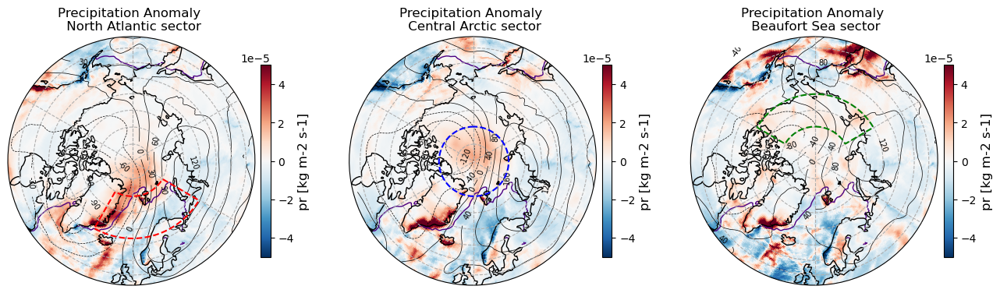

In [132]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,pr_anom_NA,pr_anom_CA,pr_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Precipitation Anomaly \n',f"pr [{ds_pr['pr'].units}]",vmin=-0.00005,vmax=0.00005,tracks_on=False,sic = True)

#### rlds

In [69]:
# Surface Down Longwave Radiation
ds_rlds = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/rlds/r1i1p1/rlds_1hr_reanalysis_era5_r1i1p1_*.nc',chunks={"time":10})#,preprocess=preprocess)
ds_rlds = ds_rlds.sel(lat=slice(30,None))
ds_rlds = ds_rlds.sel(time=slice("1998-01-01","2022-12-31"))

In [70]:
rlds_sel = ds_rlds['rlds'].sel(time=objs_all_times,method='nearest')

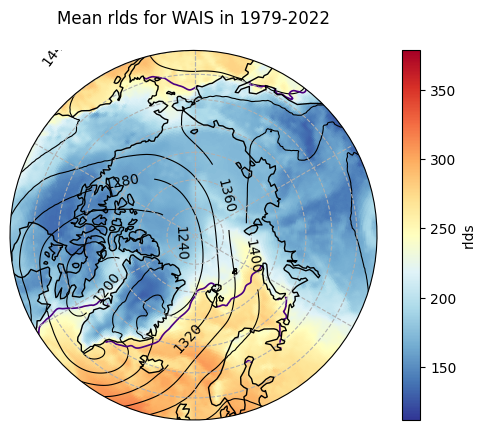

In [71]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(rlds_sel,zg_sel,'rlds')

In [72]:
## Select pr for domains
## NA
rlds_sel_NA = ds_rlds['rlds'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
rlds_sel_CA = ds_rlds['rlds'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
rlds_sel_BS = ds_rlds['rlds'].sel(time=BS_combined_times,method='nearest').mean(dim='time')



In [73]:
###Load Climatology

rlds_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/rlds/clim/rlds_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
rlds_clim_all_times = rlds_clim_DJF.where(rlds_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
rlds_clim_NA = rlds_clim_DJF.where(rlds_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
rlds_clim_CA = rlds_clim_DJF.where(rlds_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
rlds_clim_BS = rlds_clim_DJF.where(rlds_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)


In [74]:

# Compute Anomaly for the times in which tracks exist
rlds_anomaly = rlds_sel.mean(dim='times') - rlds_clim_all_times['rlds'].mean(dim='time')

# Compute Anomaly for the domain times
rlds_anom_NA = rlds_sel_NA - rlds_clim_NA['rlds'].mean(dim='time')
rlds_anom_CA = rlds_sel_CA - rlds_clim_CA['rlds'].mean(dim='time')
rlds_anom_BS = rlds_sel_BS - rlds_clim_BS['rlds'].mean(dim='time')

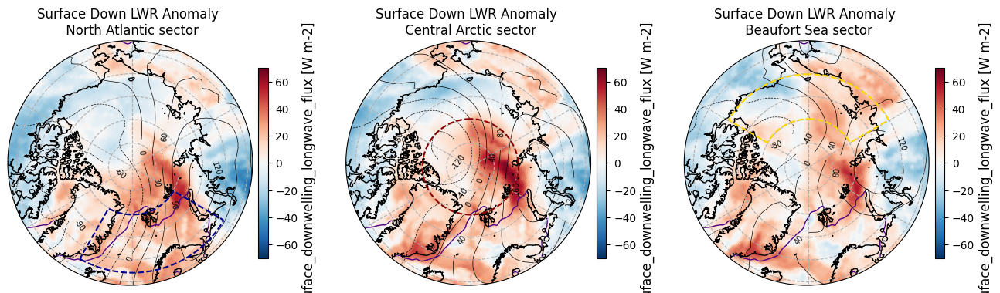

In [75]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,rlds_anom_NA,rlds_anom_CA,rlds_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Surface Down LWR Anomaly \n',f"suface_downwelling_longwave_flux [{ds_rlds['rlds'].units}]",vmin=-70,vmax=70,tracks_on=False,anomaly=True,sic=True)

#### hfls

In [ ]:
#surface upward latent heat flux
ds_hfls = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hfls/r1i1p1/hfls_1hr_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_hfls = ds_hfls.sel(lat=slice(30,None))
ds_hfls = ds_hfls.sel(time=slice("1979-01-01","2022-12-31"))

In [ ]:
hfls_sel = ds_hfls['hfls'].sel(time=objs_all_times,method='nearest')

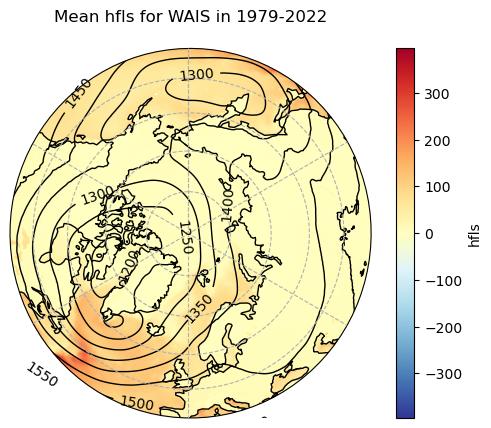

In [56]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(hfls_sel,zg_sel,'hfls')

In [188]:
## Select hfls for domains
## NA
hfls_sel_NA = ds_hfls['hfls'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
hfls_sel_CA = ds_hfls['hfls'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
hfls_sel_BS = ds_hfls['hfls'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [189]:
###Load Climatology

hfls_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/hfls/clim/hfls_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
hfls_clim_all_times = hfls_clim_DJF.where(hfls_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
hfls_clim_NA = hfls_clim_DJF.where(hfls_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
hfls_clim_CA = hfls_clim_DJF.where(hfls_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
hfls_clim_BS = hfls_clim_DJF.where(hfls_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [190]:
# Compute Anomaly for the times in which tracks exist
hfls_anomaly = hfls_sel.mean(dim='times') - hfls_clim_all_times['hfls'].mean(dim='time')

# Compute Anomaly for the domain times
hfls_anom_NA = hfls_sel_NA - hfls_clim_NA['hfls'].mean(dim='time')
hfls_anom_CA = hfls_sel_CA - hfls_clim_CA['hfls'].mean(dim='time')
hfls_anom_BS = hfls_sel_BS - hfls_clim_BS['hfls'].mean(dim='time')


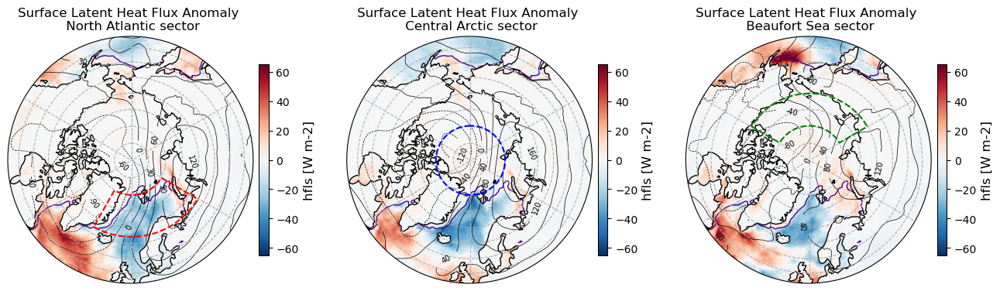

In [159]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,hfls_anom_NA,hfls_anom_CA,hfls_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Surface Latent Heat Flux Anomaly \n',f"hfls [{ds_hfls['hfls'].units}]",vmin=-65,vmax=65,tracks_on=False,sic = True)

#### hfss

In [159]:
#surface upward sensible heat flux
ds_hfss = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hfss/r1i1p1/hfss_1hr_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":1000}) 
ds_hfss = ds_hfss.sel(lat=slice(30,None))
ds_hfss = ds_hfss.sel(time=slice("1979-01-01","2022-12-31"))

In [160]:
hfss_sel = ds_hfss['hfss'].sel(time=objs_all_times,method='nearest')

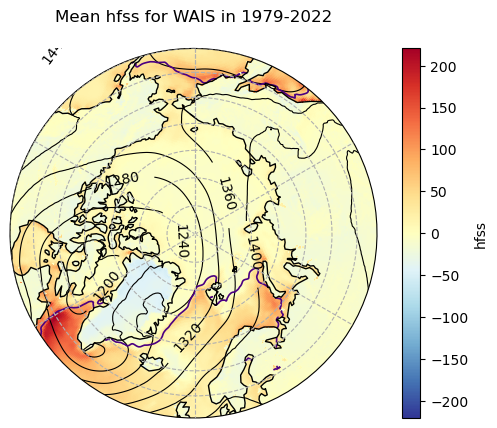

In [169]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(hfss_sel,zg_sel,'hfss')

In [171]:
## Select hfss for domains
## NA
hfss_sel_NA = ds_hfss['hfss'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
hfss_sel_CA = ds_hfss['hfss'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
hfss_sel_BS = ds_hfss['hfss'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [173]:
###Load Climatology

hfss_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/hfss/clim/clim_day_DJF.nc')

#Select climatology for all combined times and domain times
hfss_clim_all_times = hfss_clim_DJF.where(hfss_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
hfss_clim_NA = hfss_clim_DJF.where(hfss_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
hfss_clim_CA = hfss_clim_DJF.where(hfss_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
hfss_clim_BS = hfss_clim_DJF.where(hfss_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [174]:
# Compute Anomaly for the times in which tracks exist
hfss_anomaly = hfss_sel.mean(dim='times') - hfss_clim_all_times['hfss'].mean(dim='time')

# Compute Anomaly for the domain times
hfss_anom_NA = hfss_sel_NA - hfss_clim_NA['hfss'].mean(dim='time')
hfss_anom_CA = hfss_sel_CA - hfss_clim_CA['hfss'].mean(dim='time')
hfss_anom_BS = hfss_sel_BS - hfss_clim_BS['hfss'].mean(dim='time')


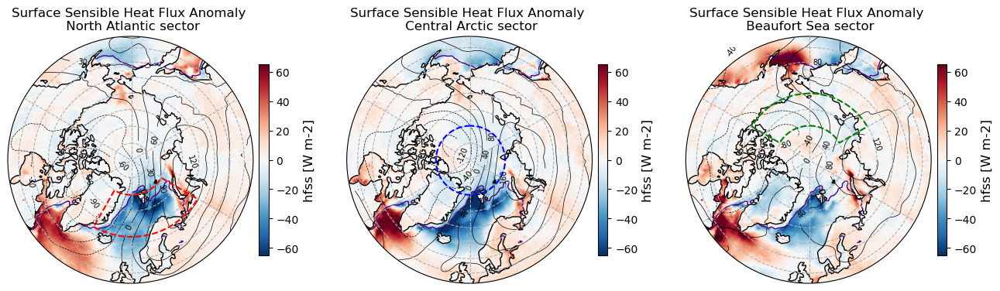

In [175]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,hfss_anom_NA,hfss_anom_CA,hfss_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Surface Sensible Heat Flux Anomaly \n',f"hfss [{ds_hfss['hfss'].units}]",vmin=-65,vmax=65,tracks_on=False,sic = True)

#### psl

In [177]:
#sea level pressure
ds_psl = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/psl/r1i1p1/psl_1hr_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_psl = ds_psl.sel(lat=slice(30,None))
ds_psl = ds_psl.sel(time=slice("1979-01-01","2022-12-31"))

In [178]:
psl_sel = ds_psl['psl'].sel(time=objs_all_times,method='nearest')

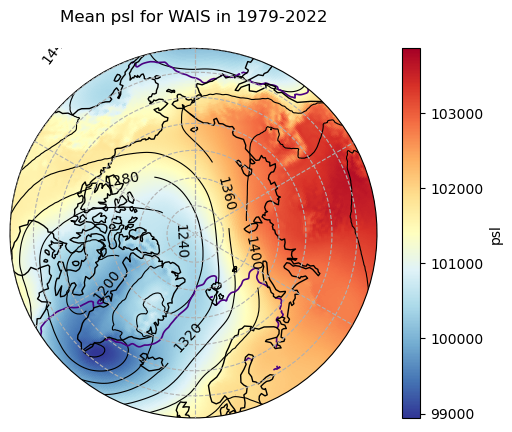

In [179]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(psl_sel,zg_sel,'psl')

In [181]:
## Select psl for domains
## NA
psl_sel_NA = ds_psl['psl'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
psl_sel_CA = ds_psl['psl'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
psl_sel_BS = ds_psl['psl'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [182]:
###Load Climatology

psl_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/psl/clim/clim_day_DJF.nc')

#Select climatology for all combined times and domain times
psl_clim_all_times = psl_clim_DJF.where(psl_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
psl_clim_NA = psl_clim_DJF.where(psl_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
psl_clim_CA = psl_clim_DJF.where(psl_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
psl_clim_BS = psl_clim_DJF.where(psl_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [183]:
# Compute Anomaly for the times in which tracks exist
psl_anomaly = psl_sel.mean(dim='times') - psl_clim_all_times['psl'].mean(dim='time')

# Compute Anomaly for the domain times
psl_anom_NA = psl_sel_NA - psl_clim_NA['psl'].mean(dim='time')
psl_anom_CA = psl_sel_CA - psl_clim_CA['psl'].mean(dim='time')
psl_anom_BS = psl_sel_BS - psl_clim_BS['psl'].mean(dim='time')


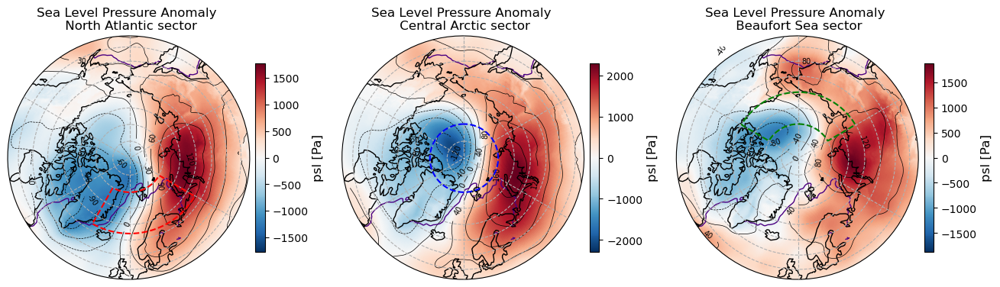

In [184]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,psl_anom_NA,psl_anom_CA,psl_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Sea Level Pressure Anomaly \n',f"psl [{ds_psl['psl'].units}]",tracks_on=False,sic = True)

#### evspsbl 

In [97]:
#evaporation including sublimation and transpiration
ds_evspsbl = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/evspsbl/r1i1p1/evspsbl_1hr_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel='True',chunks={"time":10})
ds_evspsbl = ds_evspsbl.sel(lat=slice(30,None))
ds_evspsbl = ds_evspsbl.sel(time=slice("1979-01-01", "2023-12-31"))

In [98]:
evspsbl_sel = ds_evspsbl['evspsbl'].sel(time=objs_all_times,method='nearest')

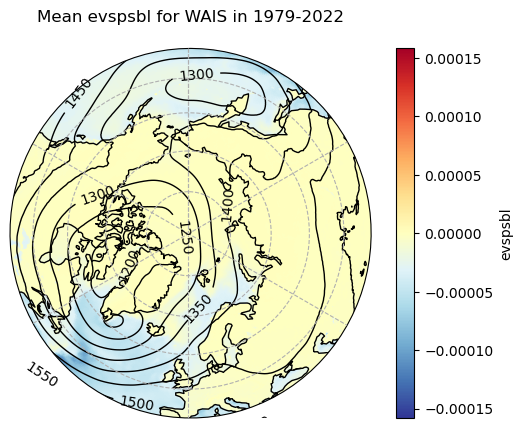

In [76]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(evspsbl_sel,zg_sel,'evspsbl')

In [99]:
## Select pr for domains
## NA
evspsbl_sel_NA = ds_evspsbl['evspsbl'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
evspsbl_sel_CA = ds_evspsbl['evspsbl'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
evspsbl_sel_BS = ds_evspsbl['evspsbl'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [49]:
###Load Climatology

evspsbl_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/evspsbl/clim/evspsbl_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
evspsbl_clim_all_times = evspsbl_clim_DJF.where(evspsbl_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
evspsbl_clim_NA = evspsbl_clim_DJF.where(evspsbl_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
evspsbl_clim_CA = evspsbl_clim_DJF.where(evspsbl_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
evspsbl_clim_BS = evspsbl_clim_DJF.where(evspsbl_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)


In [100]:
# Compute Anomaly for the times in which tracks exist
evspsbl_anomaly = evspsbl_sel.mean(dim='times') - evspsbl_clim_all_times['evspsbl'].mean(dim='time')

# Compute Anomaly for the domain times
evspsbl_anom_NA = evspsbl_sel_NA - evspsbl_clim_NA['evspsbl'].mean(dim='time')
evspsbl_anom_CA = evspsbl_sel_CA - evspsbl_clim_CA['evspsbl'].mean(dim='time')
evspsbl_anom_BS = evspsbl_sel_BS - evspsbl_clim_BS['evspsbl'].mean(dim='time')


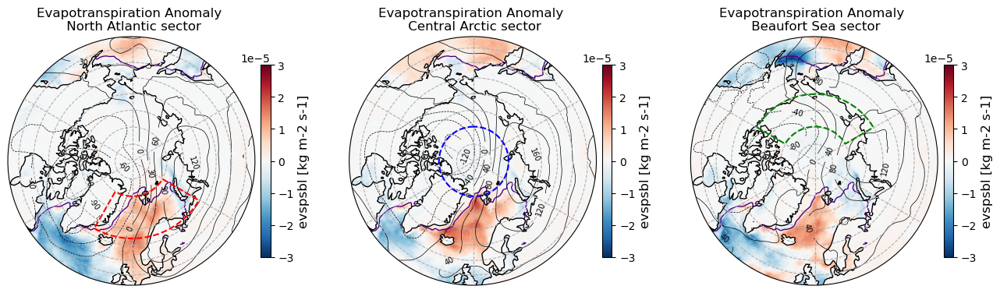

In [157]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,evspsbl_anom_NA,evspsbl_anom_CA,evspsbl_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Evapotranspiration Anomaly \n',f"evspsbl [{ds_evspsbl['evspsbl'].units}]",tracks_on=False,vmin=-0.00003,vmax=0.00003,sic = True)

#### hurs

In [102]:
#near surface relative humidity
ds_hurs = xr.open_mfdataset('/work/aa0049/a271122/ERA5/hurs/hurs_1hr_reanalysis_era5_r1i1p1_*_processed.nc') 

In [103]:
hurs_sel = ds_hurs['hurs'].sel(time=objs_all_times,method='nearest')

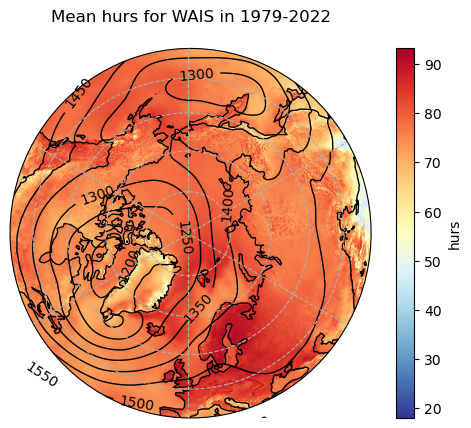

In [82]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(hurs_sel,zg_sel,'hurs')

In [104]:
## Select pr for domains
## NA
hurs_sel_NA = ds_hurs['hurs'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
hurs_sel_CA = ds_hurs['hurs'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
hurs_sel_BS = ds_hurs['hurs'].sel(time=BS_combined_times,method='nearest').mean(dim='time')



In [50]:
###Load Climatology

hurs_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/hurs/clim/hurs_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
hurs_clim_all_times = hurs_clim_DJF.where(hurs_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
hurs_clim_NA = hurs_clim_DJF.where(hurs_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
hurs_clim_CA = hurs_clim_DJF.where(hurs_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
hurs_clim_BS = hurs_clim_DJF.where(hurs_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [ ]:
# Compute Anomaly for the times in which tracks exist
hurs_anomaly = hurs_sel.mean(dim='times') - hurs_clim_all_times['hurs'].mean(dim='time')

# Compute Anomaly for the domain times
hurs_anom_NA = hurs_sel_NA - hurs_clim_NA['hurs'].mean(dim='time')
hurs_anom_CA = hurs_sel_CA - hurs_clim_CA['hurs'].mean(dim='time')
hurs_anom_BS = hurs_sel_BS - hurs_clim_BS['hurs'].mean(dim='time')


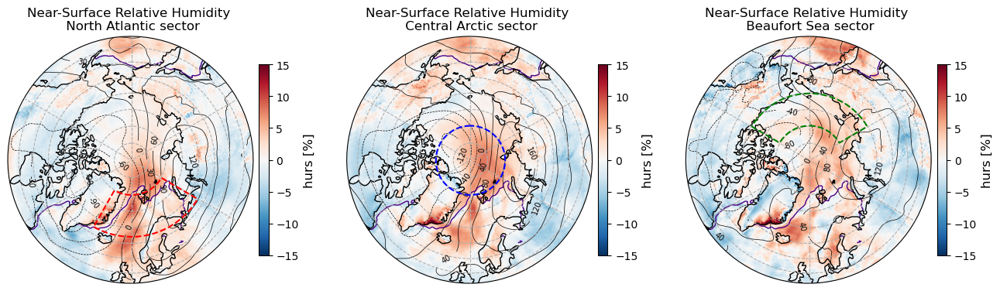

In [160]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,hurs_anom_NA,hurs_anom_CA,hurs_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Near-Surface Relative Humidity \n',f"hurs [{ds_hurs['hurs'].units}]",vmin=-15,vmax=15,tracks_on=False,sic=True)

#### prw

In [62]:
#Water vapor path = iwv 
ds_prw = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/prw/r1i1p1/prw_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_prw = ds_prw.sel(lat=slice(50,None))
ds_prw = ds_prw.sel(time=slice("1979-01-01","2022-12-31"))

In [63]:
prw_sel = ds_prw['prw'].sel(time=objs_all_times,method='nearest')

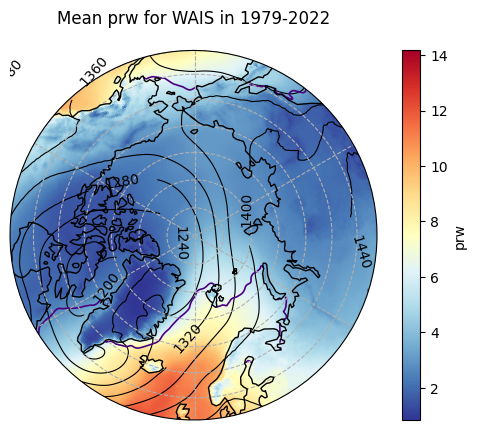

In [64]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(prw_sel,zg_sel,'prw')

In [65]:
## Select pr for domains
## NA
prw_sel_NA = ds_prw['prw'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
prw_sel_CA = ds_prw['prw'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
prw_sel_BS = ds_prw['prw'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [66]:
###Load Climatology

prw_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/prw/clim/prw_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
prw_clim_all_times = prw_clim_DJF.where(prw_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
prw_clim_NA = prw_clim_DJF.where(prw_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
prw_clim_CA = prw_clim_DJF.where(prw_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
prw_clim_BS = prw_clim_DJF.where(prw_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [67]:
# Compute Anomaly for the times in which tracks exist
prw_anomaly = prw_sel.mean(dim='times') - prw_clim_all_times['prw'].mean(dim='time')

# Compute Anomaly for the domain times
prw_anom_NA = prw_sel_NA - prw_clim_NA['prw'].mean(dim='time')
prw_anom_CA = prw_sel_CA - prw_clim_CA['prw'].mean(dim='time')
prw_anom_BS = prw_sel_BS - prw_clim_BS['prw'].mean(dim='time')


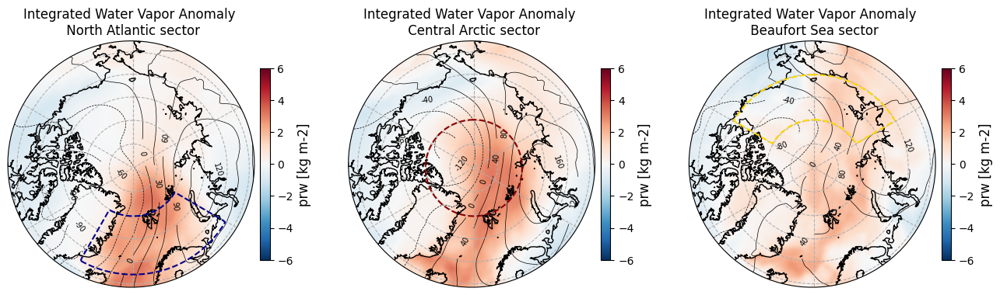

In [68]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,prw_anom_NA,prw_anom_CA,prw_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Integrated Water Vapor Anomaly \n',f"prw [{ds_prw['prw'].units}]",vmin=-6,vmax=6,tracks_on=False,sic=False)

#### clivi

In [112]:
#ice water path
ds_clivi = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/clivi/r1i1p1/clivi_1hr_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_clivi = ds_clivi.sel(lat=slice(30,None))
ds_clivi = ds_clivi.sel(time=slice("1979-01-01","2022-12-31")) 

In [113]:
clivi_sel = ds_clivi['clivi'].sel(time=objs_all_times,method='nearest')

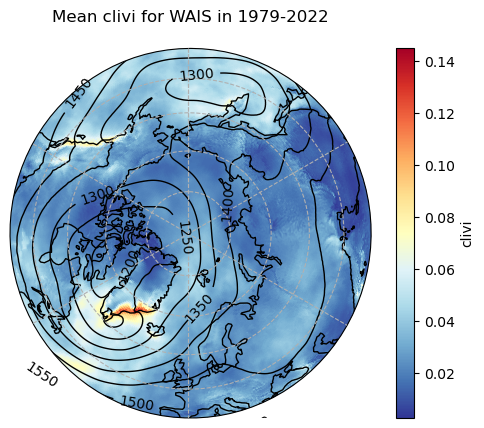

In [95]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(clivi_sel,zg_sel,'clivi')

In [114]:
## Select pr for domains
## NA
clivi_sel_NA = ds_clivi['clivi'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
clivi_sel_CA = ds_clivi['clivi'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
clivi_sel_BS = ds_clivi['clivi'].sel(time=BS_combined_times,method='nearest').mean(dim='time')



In [52]:
###Load Climatology

clivi_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/clivi/clim/clivi_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
clivi_clim_all_times = clivi_clim_DJF.where(clivi_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
clivi_clim_NA = clivi_clim_DJF.where(clivi_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
clivi_clim_CA = clivi_clim_DJF.where(clivi_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
clivi_clim_BS = clivi_clim_DJF.where(clivi_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [115]:

# Compute Anomaly for the times in which tracks exist
clivi_anomaly = clivi_sel.mean(dim='times') - clivi_clim_all_times['clivi'].mean(dim='time')

# Compute Anomaly for the domain times
clivi_anom_NA = clivi_sel_NA - clivi_clim_NA['clivi'].mean(dim='time')
clivi_anom_CA = clivi_sel_CA - clivi_clim_CA['clivi'].mean(dim='time')
clivi_anom_BS = clivi_sel_BS - clivi_clim_BS['clivi'].mean(dim='time')


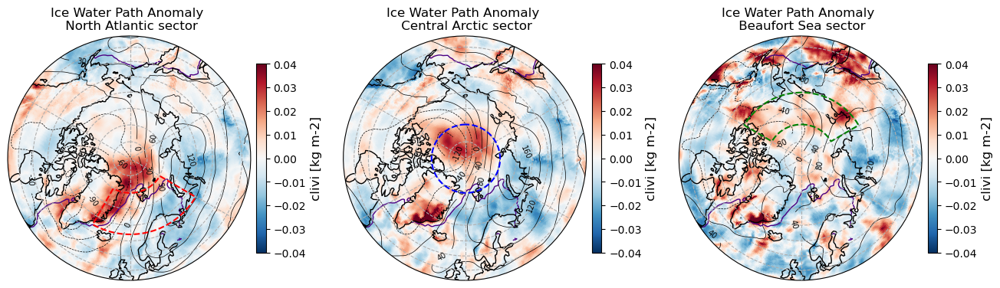

In [165]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,clivi_anom_NA,clivi_anom_CA,clivi_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Ice Water Path Anomaly \n',f"clivi [{ds_clivi['clivi'].units}]",vmin=-0.04,vmax=0.04,tracks_on=False,sic=True)

#### tcw

In [117]:
#water path 
ds_tcw = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/tcw/r1i1p1/tcw_1hr-cf_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_tcw = ds_tcw.sel(lat=slice(30,None))
ds_tcw = ds_tcw.sel(time=slice("1979-01-01","2022-12-31"))

In [118]:
tcw_sel = ds_tcw['tcw'].sel(time=objs_all_times,method='nearest')

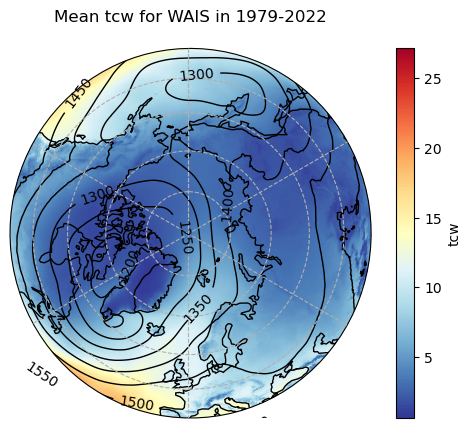

In [98]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(tcw_sel,zg_sel,'tcw')

In [119]:
## Select pr for domains
## NA
tcw_sel_NA = ds_tcw['tcw'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
tcw_sel_CA = ds_tcw['tcw'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
tcw_sel_BS = ds_tcw['tcw'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [53]:
###Load Climatology

tcw_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/tcw/clim/tcw_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
tcw_clim_all_times = tcw_clim_DJF.where(tcw_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
tcw_clim_NA = tcw_clim_DJF.where(tcw_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
tcw_clim_CA = tcw_clim_DJF.where(tcw_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
tcw_clim_BS = tcw_clim_DJF.where(tcw_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [120]:
# Compute Anomaly for the times in which tracks exist
tcw_anomaly = tcw_sel.mean(dim='times') - tcw_clim_all_times['tcw'].mean(dim='time')

# Compute Anomaly for the domain times
tcw_anom_NA = tcw_sel_NA - tcw_clim_NA['tcw'].mean(dim='time')
tcw_anom_CA = tcw_sel_CA - tcw_clim_CA['tcw'].mean(dim='time')
tcw_anom_BS = tcw_sel_BS - tcw_clim_BS['tcw'].mean(dim='time')


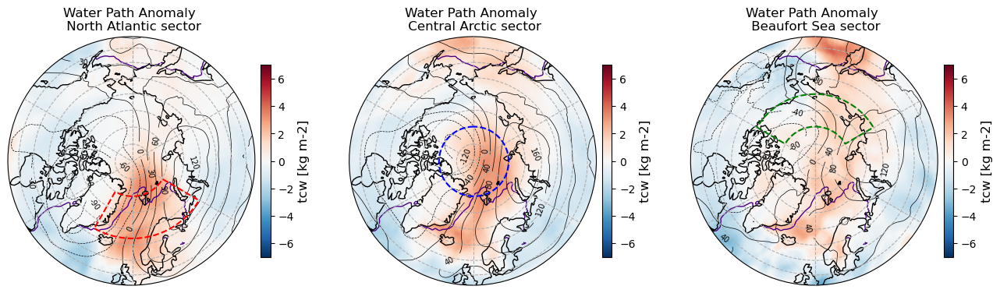

In [166]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,tcw_anom_NA,tcw_anom_CA,tcw_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Water Path Anomaly \n',f"tcw [{ds_tcw['tcw'].units}]",vmin=-7,vmax=7,tracks_on=False,sic=True)

#### clwvi

In [122]:
#condensed water path
ds_clwvi = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/clwvi/r1i1p1/clwvi_1hr_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":1000}) 
ds_clwvi = ds_clwvi.sel(lat=slice(30,None))
ds_clwvi = ds_clwvi.sel(time=slice("1979-01-01","2022-12-31")) 

In [123]:
clwvi_sel = ds_clwvi['clwvi'].sel(time=objs_all_times,method='nearest')

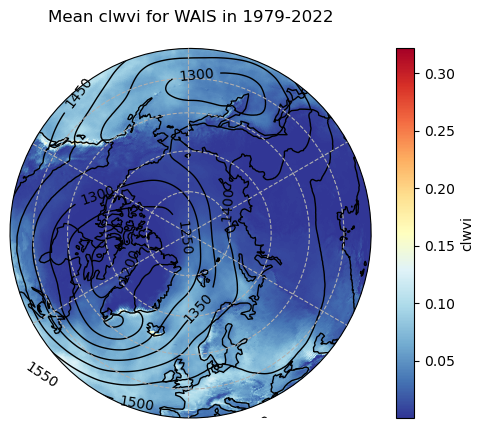

In [104]:
#Total value - plot for the whole time selection (using time selected by WAIS events)
plot_var_and_contour(clwvi_sel,zg_sel,'clwvi')

In [124]:
## Select pr for domains
## NA
clwvi_sel_NA = ds_clwvi['clwvi'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
clwvi_sel_CA = ds_clwvi['clwvi'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
clwvi_sel_BS = ds_clwvi['clwvi'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [54]:
###Load Climatology

clwvi_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/clwvi/clim/clwvi_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
clwvi_clim_all_times = clwvi_clim_DJF.where(clwvi_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
clwvi_clim_NA = clwvi_clim_DJF.where(clwvi_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
clwvi_clim_CA = clwvi_clim_DJF.where(clwvi_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
clwvi_clim_BS = clwvi_clim_DJF.where(clwvi_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)


In [125]:
# Compute Anomaly for the times in which tracks exist
clwvi_anomaly = clwvi_sel.mean(dim='times') - clwvi_clim_all_times['clwvi'].mean(dim='time')

# Compute Anomaly for the domain times
clwvi_anom_NA = clwvi_sel_NA - clwvi_clim_NA['clwvi'].mean(dim='time')
clwvi_anom_CA = clwvi_sel_CA - clwvi_clim_CA['clwvi'].mean(dim='time')
clwvi_anom_BS = clwvi_sel_BS - clwvi_clim_BS['clwvi'].mean(dim='time')


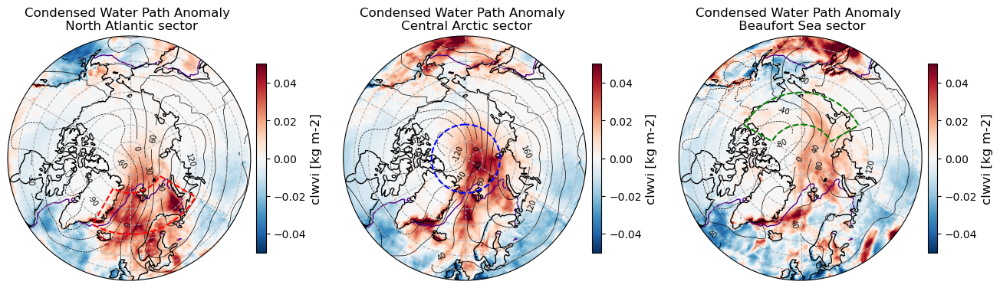

In [167]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,clwvi_anom_NA,clwvi_anom_CA,clwvi_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Condensed Water Path Anomaly \n',f"clwvi [{ds_clwvi['clwvi'].units}]",vmin=-0.05,vmax=0.05,tracks_on=False,sic=True)

#### sfcwind

In [127]:
#Near Surface Wind Speed
ds_sfcwind = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/sfcWind/r1i1p1/sfcWind_1hr_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_sfcwind = ds_sfcwind.sel(lat=slice(30,None))
ds_sfcwind = ds_sfcwind.sel(time=slice("1979-01-01","2022-12-31"))

In [128]:
sfcwind_sel = ds_sfcwind['sfcWind'].sel(time=objs_all_times,method='nearest')

In [129]:
## Select sfcWind for domains
## NA
sfcwind_sel_NA = ds_sfcwind['sfcWind'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
sfcwind_sel_CA = ds_sfcwind['sfcWind'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
sfcwind_sel_BS = ds_sfcwind['sfcWind'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [55]:
###Load Climatology

sfcwind_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/sfcwind/clim/sfcWind_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
sfcwind_clim_all_times = sfcwind_clim_DJF.where(sfcwind_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
sfcwind_clim_NA = sfcwind_clim_DJF.where(sfcwind_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
sfcwind_clim_CA = sfcwind_clim_DJF.where(sfcwind_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
sfcwind_clim_BS = sfcwind_clim_DJF.where(sfcwind_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)


In [131]:
# Compute Anomaly for the times in which tracks exist
sfcwind_anomaly = sfcwind_sel.mean(dim='times') - sfcwind_clim_all_times['sfcWind'].mean(dim='time')

# Compute Anomaly for the domain times
sfcwind_anom_NA = sfcwind_sel_NA - sfcwind_clim_NA['sfcWind'].mean(dim='time')
sfcwind_anom_CA = sfcwind_sel_CA - sfcwind_clim_CA['sfcWind'].mean(dim='time')
sfcwind_anom_BS = sfcwind_sel_BS - sfcwind_clim_BS['sfcWind'].mean(dim='time')


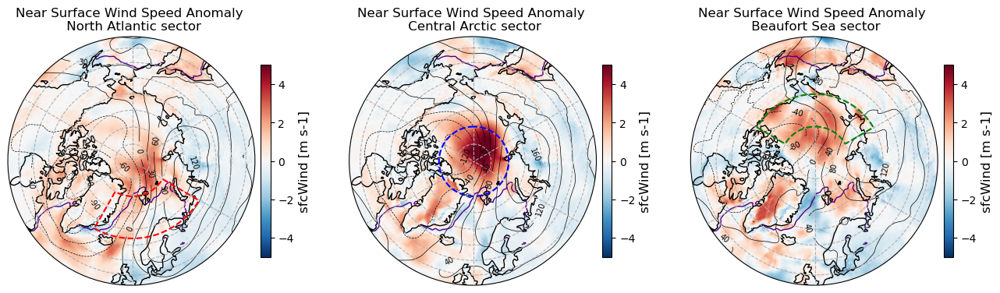

In [168]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,sfcwind_anom_NA,sfcwind_anom_CA,sfcwind_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Near Surface Wind Speed Anomaly \n',f"sfcWind [{ds_sfcwind['sfcWind'].units}]",vmin=-5,vmax=5,tracks_on=False,sic=True)

#### lcc

In [135]:
#Near Surface Wind Speed
ds_lcc = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/lcc/r1i1p1/lcc_1hr-cf_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_lcc = ds_lcc.sel(lat=slice(30,None))
ds_lcc = ds_lcc.sel(time=slice("1979-01-01","2022-12-31")) 

In [136]:
lcc_sel = ds_lcc['lcc'].sel(time=objs_all_times,method='nearest')

In [137]:
## Select pr for domains
## NA
lcc_sel_NA = ds_lcc['lcc'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
lcc_sel_CA = ds_lcc['lcc'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
lcc_sel_BS = ds_lcc['lcc'].sel(time=BS_combined_times,method='nearest').mean(dim='time')



In [56]:
###Load Climatology

lcc_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/lcc/clim/lcc_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
lcc_clim_all_times = lcc_clim_DJF.where(lcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
lcc_clim_NA = lcc_clim_DJF.where(lcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
lcc_clim_CA = lcc_clim_DJF.where(lcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
lcc_clim_BS = lcc_clim_DJF.where(lcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)



In [138]:
# Compute Anomaly for the times in which tracks exist
lcc_anomaly = lcc_sel.mean(dim='times') - lcc_clim_all_times['lcc'].mean(dim='time')

# Compute Anomaly for the domain times
lcc_anom_NA = lcc_sel_NA - lcc_clim_NA['lcc'].mean(dim='time')
lcc_anom_CA = lcc_sel_CA - lcc_clim_CA['lcc'].mean(dim='time')
lcc_anom_BS = lcc_sel_BS - lcc_clim_BS['lcc'].mean(dim='time')


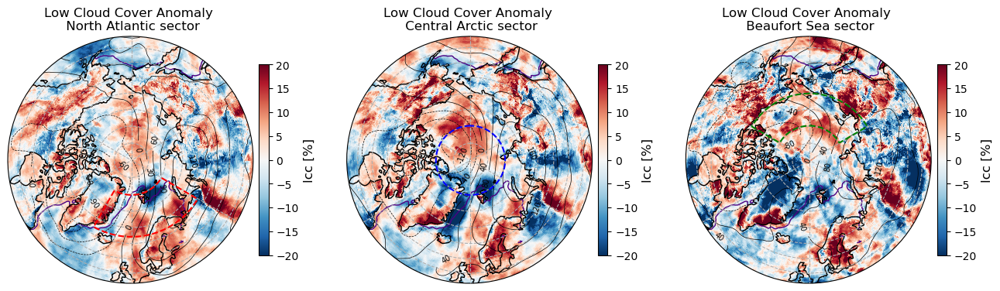

In [139]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,lcc_anom_NA,lcc_anom_CA,lcc_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Low Cloud Cover Anomaly \n',f"lcc [{ds_lcc['lcc'].units}]",vmin=-20,vmax=20,tracks_on=False,sic=True)

#### mcc

In [140]:
#Mid-level cloud cover
ds_mcc = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/mcc/r1i1p1/mcc_1hr-cf_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_mcc = ds_mcc.sel(lat=slice(30,None))
ds_mcc = ds_mcc.sel(time=slice("1979-01-01","2022-12-31")) 

In [141]:
mcc_sel = ds_mcc['mcc'].sel(time=objs_all_times,method='nearest')

In [142]:
## Select pr for domains
## NA
mcc_sel_NA = ds_mcc['mcc'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
mcc_sel_CA = ds_mcc['mcc'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
mcc_sel_BS = ds_mcc['mcc'].sel(time=BS_combined_times,method='nearest').mean(dim='time')



In [57]:
###Load Climatology

mcc_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/mcc/clim/mcc_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
mcc_clim_all_times = mcc_clim_DJF.where(mcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
mcc_clim_NA = mcc_clim_DJF.where(mcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
mcc_clim_CA = mcc_clim_DJF.where(mcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
mcc_clim_BS = mcc_clim_DJF.where(mcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)


In [143]:
# Compute Anomaly for the times in which tracks exist
mcc_anomaly = mcc_sel.mean(dim='times') - mcc_clim_all_times['mcc'].mean(dim='time')

# Compute Anomaly for the domain times
mcc_anom_NA = mcc_sel_NA - mcc_clim_NA['mcc'].mean(dim='time')
mcc_anom_CA = mcc_sel_CA - mcc_clim_CA['mcc'].mean(dim='time')
mcc_anom_BS = mcc_sel_BS - mcc_clim_BS['mcc'].mean(dim='time')


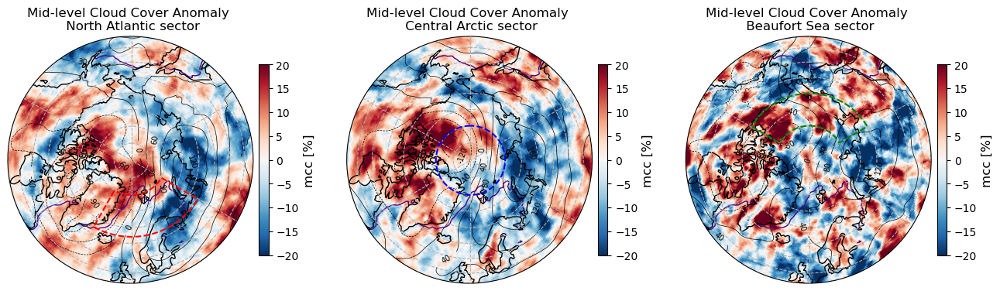

In [144]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,mcc_anom_NA,mcc_anom_CA,mcc_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Mid-level Cloud Cover Anomaly \n',f"mcc [{ds_mcc['mcc'].units}]",vmin=-20,vmax=20,tracks_on=False,sic=True)

#### hcc

In [145]:
#High-level cloud cover
ds_hcc = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hcc/r1i1p1/hcc_1hr-cf_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":1000}) 
ds_hcc = ds_hcc.sel(lat=slice(30,None))
ds_hcc = ds_hcc.sel(time=slice("1979-01-01","2022-12-31")) 

In [146]:
hcc_sel = ds_hcc['hcc'].sel(time=objs_all_times,method='nearest')

In [147]:
## Select pr for domains
## NA
hcc_sel_NA = ds_hcc['hcc'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
hcc_sel_CA = ds_hcc['hcc'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
hcc_sel_BS = ds_hcc['hcc'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [58]:
###Load Climatology

hcc_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/hcc/clim/hcc_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
hcc_clim_all_times = hcc_clim_DJF.where(hcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
hcc_clim_NA = hcc_clim_DJF.where(hcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
hcc_clim_CA = hcc_clim_DJF.where(hcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
hcc_clim_BS = hcc_clim_DJF.where(hcc_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)


In [204]:
# Compute Anomaly for the times in which tracks exist
hcc_anomaly = hcc_sel.mean(dim='times') - hcc_clim_all_times['hcc'].mean(dim='time')

# Compute Anomaly for the domain times
hcc_anom_NA = hcc_sel_NA - hcc_clim_NA['hcc'].mean(dim='time')
hcc_anom_CA = hcc_sel_CA - hcc_clim_CA['hcc'].mean(dim='time')
hcc_anom_BS = hcc_sel_BS - hcc_clim_BS['hcc'].mean(dim='time')


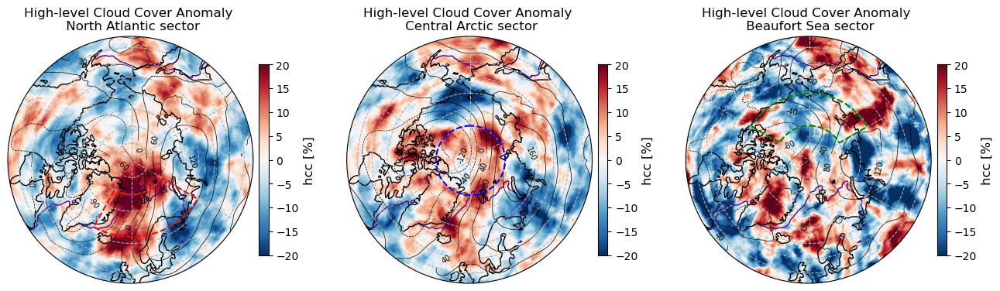

In [149]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,hcc_anom_NA,hcc_anom_CA,hcc_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'High-level Cloud Cover Anomaly \n',f"hcc [{ds_hcc['hcc'].units}]",vmin=-20,vmax=20,tracks_on=False,sic=True)

#### sic

In [43]:
ds_sic2 = xr.open_mfdataset('/work/aa0049/a271122/ERA5/031/merged_*.nc',combine="by_coords",parallel=True, chunks={"time":10})

In [44]:
sic2_sel = ds_sic2['var31'].sel(time=objs_all_times,method='nearest')

In [46]:
## Select pr for domains
## NA
sic2_sel_NA = ds_sic2['var31'].sel(time=NA_combined_times,method='nearest').mean(dim='time')
## CA
sic2_sel_CA = ds_sic2['var31'].sel(time=CA_combined_times,method='nearest').mean(dim='time')
## BS
sic2_sel_BS = ds_sic2['var31'].sel(time=BS_combined_times,method='nearest').mean(dim='time')


In [47]:
###Load Climatology

sic_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/031/clim/031_clim_day_DJF.nc')

#Select climatology for all combined times and domain times
sic_clim_all_times = sic_clim_DJF.where(sic_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in month_day]), drop=True)
sic_clim_NA = sic_clim_DJF.where(sic_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in NA_month_day]), drop=True)
sic_clim_CA = sic_clim_DJF.where(sic_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in CA_month_day]), drop=True)
sic_clim_BS = sic_clim_DJF.where(sic_clim_DJF['time'].dt.strftime('%m-%d').isin([f"{month:02d}-{day:02d}" for month,day in BS_month_day]), drop=True)


In [48]:
# Compute Anomaly for the times in which tracks exist
sic_anomaly = sic2_sel.mean(dim='times') - sic_clim_all_times['var31'].mean(dim='time')

# Compute Anomaly for the domain times
sic_anom_NA = sic2_sel_NA - sic_clim_NA['var31'].mean(dim='time')
sic_anom_CA = sic2_sel_CA - sic_clim_CA['var31'].mean(dim='time')
sic_anom_BS = sic2_sel_BS - sic_clim_BS['var31'].mean(dim='time')


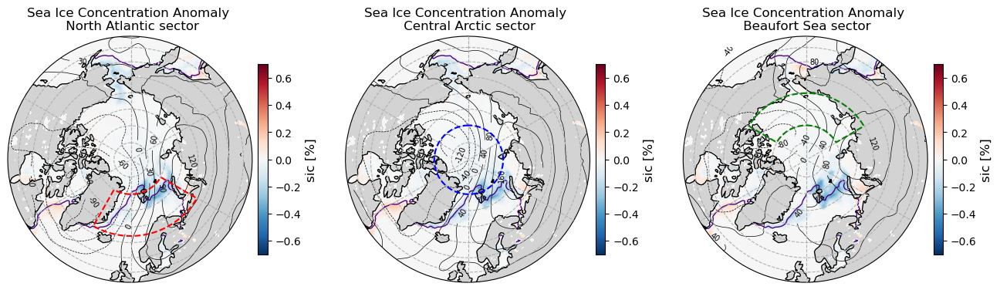

In [61]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,sic_anom_NA,sic_anom_CA,sic_anom_BS,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Sea Ice Concentration Anomaly \n',f"sic [%]",vmin=-0.7,vmax=0.7,tracks_on=False,sic=True)

In [62]:
# Compute Anomaly for the domain times
sic_anom_NA_2 = sic2_sel_NA - sic_clim_all_times['var31'].mean(dim='time')
sic_anom_CA_2 = sic2_sel_CA - sic_clim_all_times['var31'].mean(dim='time')
sic_anom_BS_2 = sic2_sel_BS - sic_clim_all_times['var31'].mean(dim='time')


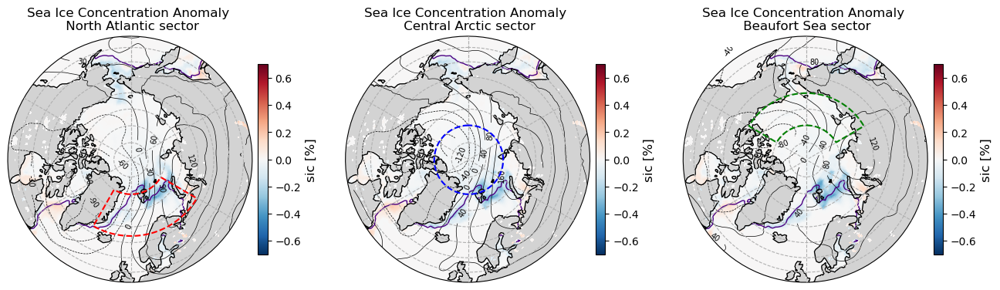

In [64]:
#Plot anomaly for different sectors 
plot_all_domain_means(objs_final,sic_anom_NA_2,sic_anom_CA_2,sic_anom_BS_2,zg_NA_anom,zg_CA_anom,zg_BS_anom,'Sea Ice Concentration Anomaly \n',f"sic [%]",vmin=-0.7,vmax=0.7,tracks_on=False,sic=True)

##### daily sic 

In [72]:
ds_sic_daily = xr.open_mfdataset('/work/aa0049/a271122/ERA5/031/1D/E5sf00_1D_*.nc',combine="by_coords",parallel=True, chunks={"time":10})

# MOAAP Objects

In [15]:
test_weights = xr.open_dataset('/work/aa0049/a271122/ERA5/031/new_weights2.nc')

In [16]:
test_weights=test_weights.assign_coords(lon=((test_weights.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [17]:
#Select weights from nc-file 
ds_weights = xr.open_dataset('/work/aa0049/a271122/ERA5/weights.nc')

In [18]:
weights = ds_weights.cell_weights

In [19]:
weights=weights.assign_coords(lon=((weights.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [20]:
#Open moaap objects 
ds_moaap = xr.open_mfdataset('/work/aa0238/a271093/results/MOAAP/IVT_Tracking/ERA5_ICON_remapped_3x/ObjectMasks_MOAPP_ERA5_100and85controlperc_remapped_3x_*_corrected.nc',chunks={'time': 10})

# Extract 2D latitude and longitude values
lat_tmp = ds_moaap.rlat.isel(time=0,x=0, yc=0, xc=0).values  # 2D latitude array
lon_tmp = ds_moaap.rlon.isel(time=0,y=0, yc=0, xc=0).values  # 2D longitude array

# Drop original variables and assignlat/lon as coordinates
ds_moaap = ds_moaap.drop(['rlat', 'rlon']) \
                   .rename_dims({'y': 'rlat', 'x': 'rlon'}) \
                   .assign_coords(rlat=('rlat', lat_tmp), 
                                  rlon=('rlon', lon_tmp))

ds_moaap = ds_moaap.isel(yc=0, xc=0).squeeze()



In [21]:
ds_moaap_DJF = ds_moaap.where(ds_moaap['time'].dt.month.isin([12, 1, 2]), drop=True)

In [ ]:
all_times_np = np.array(objs_all_times, dtype='datetime64[ns]')

# Select only matching times
ds_moaap_DJF_filtered = ds_moaap_DJF.sel(time=ds_moaap_DJF.time[np.isin(ds_moaap_DJF.time.values, all_times_np)])


#### Trans-Arctic WAIs

In [79]:
list_ids_int = np.array([objs_final[i]['id_'].item() for i in range(len(objs_final))],dtype=int)

In [80]:
ivt_objects = ds_moaap_DJF_filtered.IVT_Objects.values 

In [81]:
mask = np.isin(ivt_objects, list_ids_int)

#apply mask
ivt_masked = np.where(mask, ivt_objects, 0)

# For each grid cell, find the number of unique objects (ignoring 0)
TA_WAIs = np.apply_along_axis(lambda x: len(np.unique(x[x != 0])), axis=0, arr=ivt_masked)


#### All Moisture Transport Objects 

In [ ]:
list_ids_int_all = np.array([objs_sel_all[i]['id_'].item() for i in range(len(objs_sel_all))],dtype=int)

In [ ]:
ivt_objects_all = ds_moaap_DJF.IVT_Objects.values 

In [ ]:

# For each grid cell, find the number of unique objects (ignoring 0)
all_WAIs = np.apply_along_axis(lambda x: len(np.unique(x[x != 0])), axis=0, arr=ivt_objects_all)


In [70]:
'''plt.rcParams.update({
    'axes.titlesize': 13,        # Title size
    'axes.labelsize': 12,         # Axis label size
    'lines.linewidth': 2,         # Line width
    'lines.markersize': 7,       # Marker size for lines
    'xtick.labelsize': 10,        # X-tick label size
    'ytick.labelsize': 10         # Y-tick label size
})'''

fig_width = 7.0 #3.4   # or 7.0
golden_ratio = (5**0.5 - 1) / 2 
fig_height = fig_width * golden_ratio

plt.rcParams.update({
    "figure.figsize": (fig_width, fig_height),
    "font.size": 10,               
    "axes.labelsize": 10,
    "xtick.labelsize": 9,
    "ytick.labelsize": 9,
    "legend.fontsize": 9,
    "savefig.dpi": 300,
})

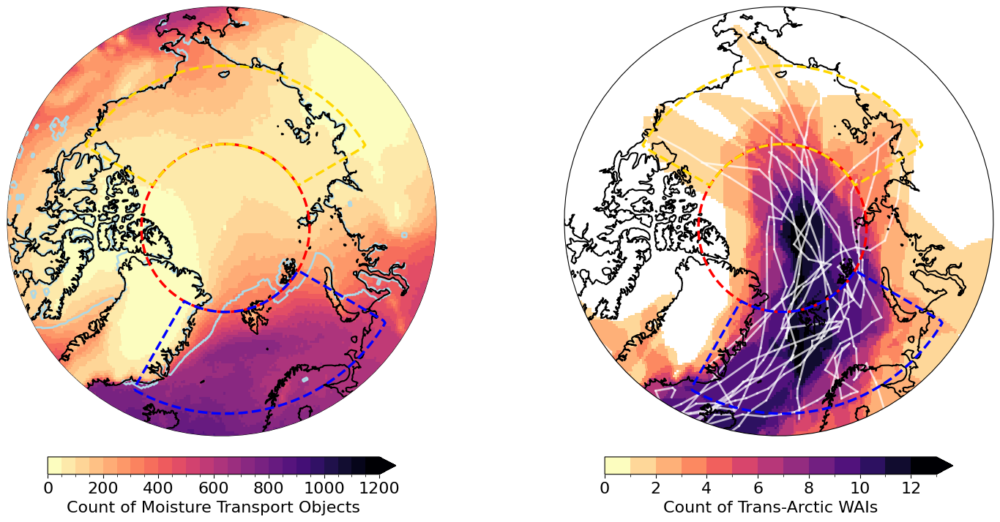

In [77]:
fig, axs = plt.subplots(1, 2,subplot_kw={'projection': ccrs.Orthographic(0,90)},figsize=(18,9))
ax = axs.flatten()

lats = ds_moaap_DJF_filtered.rlat
lons = ds_moaap_DJF_filtered.rlon

##Create Colormap (stepwise)
cmap =  matplotlib.colormaps.get_cmap('magma_r')
cmaplist = [cmap(i) for i in range(cmap.N)]

#create new colormap
custom_cmap = mcolors.LinearSegmentedColormap.from_list('custom_topo', cmaplist, N=cmap.N)
custom_cmap.set_bad(color='white')

# Define bin edges (adjust to your needs)
bounds = [0,1,2,3, 4,5, 6,7, 8,9, 10,11, 12,13]
norm = mcolors.BoundaryNorm(boundaries=bounds, ncolors=custom_cmap.N)


bounds_all = [0,50, 100,150,200,250,300,350, 400,450,500, 550,600,650,700,750, 800,850,900,950, 1000,1050,1100,1150,1200]
norm_all = mcolors.BoundaryNorm(boundaries=bounds_all, ncolors=custom_cmap.N)


#Plot First Axis
count_all = ax[0].pcolormesh(lons, lats, all_WAIs_masked, cmap=custom_cmap,norm=norm_all,transform=crs_rot,zorder=3)#,vmin=0,vmax=1100)#,cbar_kwargs={'extend':'neither','pad':0.01})

# Add the colorbar
cbar_all = fig.colorbar(count_all, ax=ax[0], orientation='horizontal', shrink=0.75, pad=0.08,extend='max')
cbar_all.set_ticks([0,200, 400, 600, 800, 1000, 1200])
cbar_all.ax.tick_params(labelsize=16) 
cbar_all.set_label('Count of Moisture Transport Objects',fontsize=16)

#Add sea ice
(ds_sic_DJF.sic>85).plot.contour(levels=1,ax=ax[0],transform=ccrs.PlateCarree(),colors='lightblue',linewidths=2,zorder=3)



#Second Axis
count = ax[1].pcolormesh(lons, lats, TA_WAIs_masked, cmap=custom_cmap,norm=norm,transform=crs_rot)#,vmin=0,vmax=14)#,cbar_kwargs={'extend':'neither','pad':0.01})

# Add the colorbar
cbar = fig.colorbar(count, ax=ax[1], orientation='horizontal', shrink=0.75, pad=0.08,extend='max')
cbar.set_ticks([0,2,4,6,8,10,12])
cbar.ax.tick_params(labelsize=16) 
cbar.set_label('Count of Trans-Arctic WAIs',fontsize=16)


for ii in range(len(objs_final)):
    track=objs_final[ii].track.values
    
    track_lats = np.array([x.lat for x in track])
    track_lons = np.array([x.lon for x in track])    
    
    # Now draw the lines
    for j in range(0, len(track_lats) - 6, 6):
        lat_start = track_lats[j]
        lon_start = track_lons[j]
        lat_end = track_lats[j + 6]
        lon_end = track_lons[j + 6]
        ax[1].plot([lon_start, lon_end], [lat_start, lat_end],
                color='white',alpha=0.7, transform=crs_rot, linewidth=2)



for axes in ax: 
    axes.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())

    center, radius = [0.5, 0.5], 0.55
    circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)),
                                   np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
    axes.set_boundary(circle, transform=axes.transAxes)

    for domain_name, domain_data in mask_domains.items():
        domain_data["mask"].plot.contour(levels=1,colors=domain_data["color"],linewidths=2.5,linestyles='--',zorder=4,ax=axes,transform=ccrs.PlateCarree())


    axes.coastlines(zorder=3,linewidth=1.5)
    axes.add_feature(cartopy.feature.LAND, color='lightgray',zorder=0, edgecolor='None') 


#ax[0].set_title('Moisture Transport Objects Occurrence',y=1.1)
#ax[1].set_title('Trans-Arctic WAIs Occurrence',y=1.1)
#ax.gridlines(linestyle='--',zorder=3)

#plt.tight_layout()
plt.savefig('/work/aa0049/a271122/ERA5/Occurrence_ERA5_newfit.png',dpi=100,bbox_inches='tight')
plt.show()



In [ ]:
import matplotlib
fig, axs = plt.subplots(1, 2,subplot_kw={'projection': ccrs.Orthographic(0,90)},figsize=(18,9))
ax = axs.flatten()

lats = ds_moaap_DJF_filtered.rlat
lons = ds_moaap_DJF_filtered.rlon

##Create Colormap (stepwise)
cmap =  matplotlib.colormaps.get_cmap('magma_r')
cmaplist = [cmap(i) for i in range(cmap.N)]

#create new colormap
custom_cmap = mcolors.LinearSegmentedColormap.from_list('custom_topo', cmaplist, N=cmap.N)
custom_cmap.set_bad(color='white')

# Define bin edges (adjust to your needs)
bounds = [0,1,2,3, 4,5, 6,7, 8,9, 10,11, 12,13]
norm = mcolors.BoundaryNorm(boundaries=bounds, ncolors=custom_cmap.N)


bounds_all = [0,100,200,300, 400,500,600,700,800,900,1000,1100,1200]
norm_all = mcolors.BoundaryNorm(boundaries=bounds_all, ncolors=custom_cmap.N)


#Plot First Axis
count_all = ax[0].pcolormesh(lons, lats, all_WAIs_masked, cmap=custom_cmap,norm=norm_all,transform=crs_rot,zorder=3)#,vmin=0,vmax=1100)#,cbar_kwargs={'extend':'neither','pad':0.01})

# Add the colorbar
cbar_all = fig.colorbar(count_all, ax=ax[0], orientation='horizontal', shrink=0.75, pad=0.08,extend='max')
cbar_all.set_ticks([0,200, 400, 600, 800, 1000, 1200])
cbar_all.ax.tick_params(labelsize=16) 
cbar_all.set_label('Count of Moisture Transport Objects',fontsize=16)

#Add sea ice
(ds_sic_DJF.sic>85).plot.contour(levels=1,ax=ax[0],transform=ccrs.PlateCarree(),colors='lightblue',linewidths=2,zorder=3)



#Second Axis
count = ax[1].pcolormesh(lons, lats, TA_WAIs_masked, cmap=custom_cmap,norm=norm,transform=crs_rot)#,vmin=0,vmax=14)#,cbar_kwargs={'extend':'neither','pad':0.01})

# Add the colorbar
cbar = fig.colorbar(count, ax=ax[1], orientation='horizontal', shrink=0.75, pad=0.08,extend='max')
cbar.set_ticks([0,2,4,6,8,10,12])
cbar.ax.tick_params(labelsize=16) 
cbar.set_label('Count of Trans-Arctic WAIs',fontsize=16)


for ii in range(len(objs_final)):
    track=objs_final[ii].track.values
    
    track_lats = np.array([x.lat for x in track])
    track_lons = np.array([x.lon for x in track])    
    
    # Now draw the lines
    for j in range(0, len(track_lats) - 6, 6):
        lat_start = track_lats[j]
        lon_start = track_lons[j]
        lat_end = track_lats[j + 6]
        lon_end = track_lons[j + 6]
        ax[1].plot([lon_start, lon_end], [lat_start, lat_end],
                color='white',alpha=0.7, transform=crs_rot, linewidth=2)



for axes in ax: 
    axes.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())

    center, radius = [0.5, 0.5], 0.55
    circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)),
                                   np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
    axes.set_boundary(circle, transform=axes.transAxes)

    for domain_name, domain_data in mask_domains.items():
        domain_data["mask"].plot.contour(levels=1,colors=domain_data["color"],linewidths=2.5,linestyles='--',zorder=4,ax=axes,transform=ccrs.PlateCarree())


    axes.coastlines(zorder=3,linewidth=1.5)
    axes.add_feature(cartopy.feature.LAND, color='lightgray',zorder=0, edgecolor='None') 


#ax[0].set_title('Moisture Transport Objects Occurrence',y=1.1)
#ax[1].set_title('Trans-Arctic WAIs Occurrence',y=1.1)
#ax.gridlines(linestyle='--',zorder=3)

#plt.tight_layout()
plt.savefig('/work/aa0049/a271122/ERA5/Occurrence_ERA5_newfit_2.png',dpi=100,bbox_inches='tight')
plt.show()



In [72]:
all_WAIs_masked = np.ma.masked_equal(all_WAIs, 0)
TA_WAIs_masked = np.ma.masked_equal(TA_WAIs, 0)

# Lifecycle MOAAP Objects trans-Arctic

In [95]:
# Create list ids 
list_ids = [objs_final[i]['id_'].item() for i in range(1,13)]

### Plot variables

#### tas

In [88]:
ds_tas = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/tas/r1i1p1/tas_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_tas = ds_tas.sel(lat=slice(30,None))
ds_tas = ds_tas.sel(time=slice("1979-01-01","2022-12-31"))

In [89]:
data_in = ds_tas['tas']-273.15
data_out = transform_coords_to_rot(data_in)

In [92]:
# Create shapes for each domain using the center of mass approach
NA_shapes = create_masked_lists(objs_final,ds_moaap,data_out,80, 67, 60, -30)
CA_shapes = create_masked_lists(objs_final,ds_moaap,data_out,90, 80, 180, -180)
BS_shapes = create_masked_lists(objs_final,ds_moaap,data_out,80, 70, 120, -120, True)

In [93]:
NA_shapes = [NA_shapes[i].compute() for i in range(len(NA_shapes))]
CA_shapes = [CA_shapes[i].compute() for i in range(len(CA_shapes))]
BS_shapes = [BS_shapes[i].compute() for i in range(len(BS_shapes))]

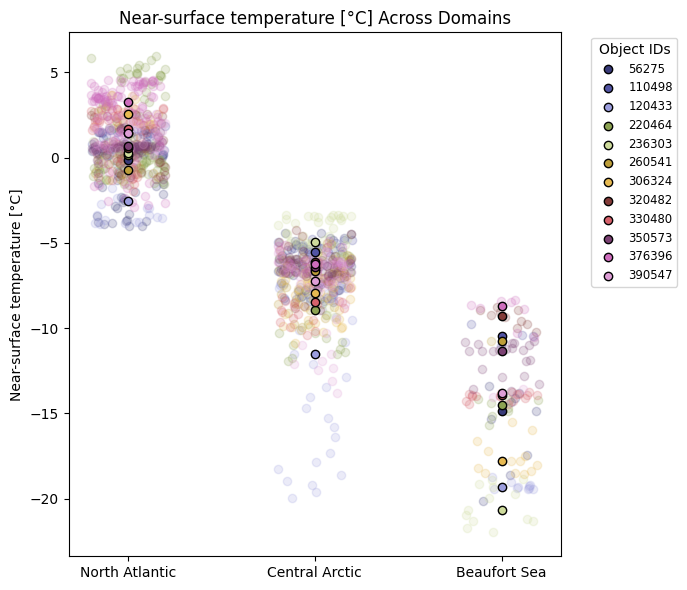

In [96]:
plot_scatter_domains(NA_shapes,CA_shapes,BS_shapes,list_ids,f'Near-surface temperature [°C]',f'Near-surface temperature [°C] Across Domains') 

In [98]:
tas_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/tas/clim/clim_day_DJF_noHist.nc')

In [99]:
tas_clim_DJF_sd = tas_clim_DJF.assign_coords(lon=((tas_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [100]:
tas_NA_clim_sd = tas_clim_DJF_sd.where((tas_clim_DJF_sd.lat>=67) & (tas_clim_DJF_sd.lat<=80) & (tas_clim_DJF_sd.lon>=-30) & (tas_clim_DJF_sd.lon<=60))
tas_CA_clim_sd = tas_clim_DJF_sd.where((tas_clim_DJF_sd.lat>=80) & (tas_clim_DJF_sd.lat<=90) & (tas_clim_DJF_sd.lon>=-180) & (tas_clim_DJF_sd.lon<=180))
tas_BS_clim_sd = tas_clim_DJF_sd.where(
    ((tas_clim_DJF_sd.lat >= 70) & (tas_clim_DJF_sd.lat <= 80)) &  ((tas_clim_DJF_sd.lon >= -180) & (tas_clim_DJF_sd.lon <= -120)) |  ((tas_clim_DJF_sd.lat >= 70) & (tas_clim_DJF_sd.lat <= 80)) & ((tas_clim_DJF_sd.lon >= 120) & (tas_clim_DJF_sd.lon <= 180)))

/tmp/ipykernel_3972083/4265348551.py:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap("tab20b", len(list_ids))


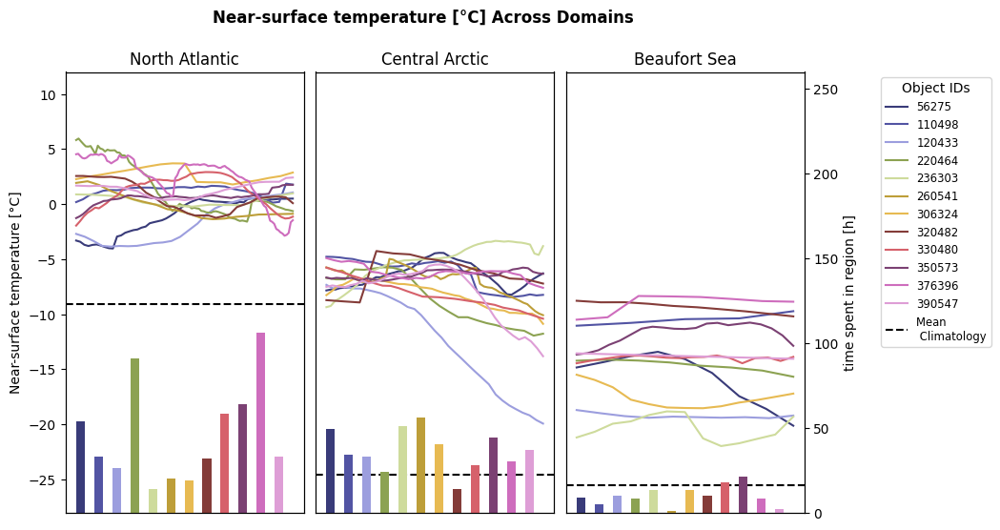

In [108]:
plot_masked_shapes_clim(NA_shapes, CA_shapes, BS_shapes,
                                   tas_NA_clim_sd['tas'].mean(dim=("lat","lon"))-273.15,tas_CA_clim_sd['tas'].mean(dim=("lat","lon"))-273.15,tas_BS_clim_sd['tas'].mean(dim=("lat","lon"))-273.15,
                                   list_ids,f'Near-surface temperature [°C]', f'Near-surface temperature [°C] Across Domains',vmin=-28,vmax=12,clim=True)

In [110]:
# Create shapes for each domain using the shape approach
list_domains = create_masked_lists_shapes(objs_final,ds_moaap,data_out,domains)

In [ ]:
with open(f'{ICON_clim_path}/shapelists/{var}_anomaly_list.pkl', 'wb') as f:
        pickle.dump(anomaly_list, f)


In [ ]:
plot_masked_shapes_clim(list_domains[0], list_domains[1], list_domains[2],
                                   tas_NA_clim_sd['tas'].mean(dim=("lat","lon"))-273.15,tas_CA_clim_sd['tas'].mean(dim=("lat","lon"))-273.15,tas_BS_clim_sd['tas'].mean(dim=("lat","lon"))-273.15,
                                   list_ids,f'Near-surface temperature [°C]', f'Near-surface temperature [°C] Across Domains',vmin=-30,vmax=12,clim=True)

In [ ]:
plot_masked_shapes_clim(NA_shapes_anomalies, CA_shapes_anomalies, BS_shapes_anomalies,
                                   clim_NA['tas'].mean(dim=("lat","lon"))-273,clim_CA['tas'].mean(dim=("lat","lon"))-273,clim_BS['tas'].mean(dim=("lat","lon"))-273,
                                   list_ids,f'Near-surface temperature anomaly [°C]', f'Near-surface temperature Anomalies[°C] Across Domains',vmin=-10,vmax=25,bars=False)

##### NEW APPROACH

In [79]:
ds_tas = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/tas/r1i1p1/tas_1hr_reanalysis_era5_r1i1p1_*.nc',chunks={"time":10}) 
ds_tas = ds_tas.sel(lat=slice(50,None))
ds_tas = ds_tas.sel(time=slice("1979-01-01","2022-12-31"))

In [100]:
data_in = ds_tas['tas']-273.15
data_out = transform_coords_to_rot(data_in)

In [101]:
#tas_shape_list, tas_clim_list = get_shapes_and_clim(data_out,'tas','tas',domains)

In [102]:
#tas_anomaly_list = get_anomaly_shapes(data_out,'tas','tas',domains)

##### Anomalies

In [103]:
tas_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/tas/clim/clim_day_DJF_noHist.nc')

In [115]:
NA_shapes_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out,tas_clim_DJF["tas"]-273.15,80, 67, 60, -30)
CA_shapes_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out,tas_clim_DJF["tas"]-273.15,90, 80, 180, -180)
BS_shapes_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out,tas_clim_DJF["tas"]-273.15,80, 70, 120, -120, True)

In [116]:
NA_shapes_anomalies = [NA_shapes_anomalies[i].compute() for i in range(len(NA_shapes_anomalies))]
CA_shapes_anomalies = [CA_shapes_anomalies[i].compute() for i in range(len(CA_shapes_anomalies))]
BS_shapes_anomalies = [BS_shapes_anomalies[i].compute() for i in range(len(BS_shapes_anomalies))]


In [119]:
with open(f'{ERA5_clim_path}/shapelists/tas_clim_list.pkl', 'rb') as f:
        tas_clim_list = pickle.load(f)

clim_NA = tas_clim_list[0]['tas'].mean(dim='time').mean(dim=('lat','lon')).values
clim_CA = tas_clim_list[1]['tas'].mean(dim='time').mean(dim=('lat','lon')).values
clim_BS = tas_clim_list[2]['tas'].mean(dim='time').mean(dim=('lat','lon')).values
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')      

 Clim NA: 264.04 
 CA: 248.58 
 BS: 247.66


In [ ]:
plot_masked_shapes_clim(NA_shapes_anomalies, CA_shapes_anomalies, BS_shapes_anomalies,
                        clim_NA-273,clim_CA-273,clim_BS-273,
                        list_ids,f'Near-surface temperature anomaly [°C]', f'Near-surface temperature Anomalies[°C] Across Domains',vmin=-10,vmax=25,bars=False)

In [122]:
NA_shapes_anomalies_new = np.concatenate([da.values.flatten() for da in NA_shapes_anomalies if da is not None])
CA_shapes_anomalies_new = np.concatenate([da.values.flatten() for da in CA_shapes_anomalies if da is not None])
BS_shapes_anomalies_new = np.concatenate([da.values.flatten() for da in BS_shapes_anomalies if da is not None])

In [ ]:
plot_box_years(NA_shapes_anomalies_new,CA_shapes_anomalies_new,BS_shapes_anomalies_new,f'Near-Surface Temperature Anomalies (°C)',f'Near-Surface Temperature Anomaly (°C)',-5,25)

 Clim NA: 264.04 
 CA: 248.58 
 BS: 247.66
NA — Mean: 7.1798, Median: 7.1659, Min: 1.6324, Max: 12.9110, Std Dev: 1.9851
CA — Mean: 16.0397, Median: 16.6272, Min: 4.9360, Max: 19.5063, Std Dev: 2.4666
BS — Mean: 10.9402, Median: 11.4472, Min: 2.9144, Max: 16.7280, Std Dev: 3.7702


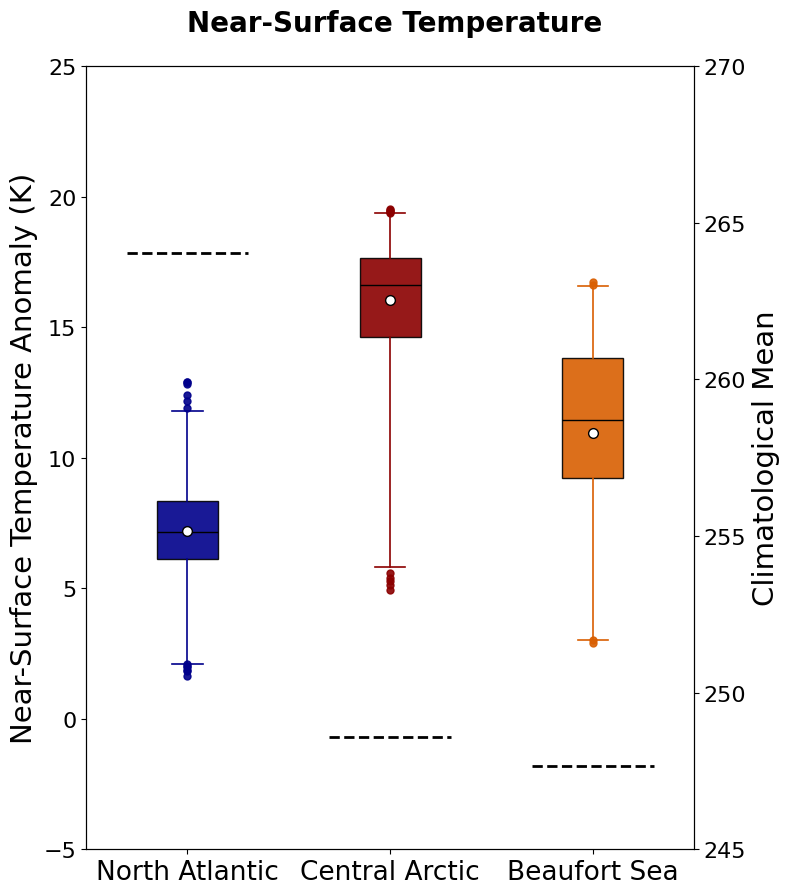

In [128]:
plot_box_years_new(NA_shapes_anomalies_new,CA_shapes_anomalies_new,BS_shapes_anomalies_new,tas_clim_list,'tas',f'Near-Surface Temperature',f'Near-Surface Temperature Anomaly (K)',-5,25,245,270)

#### prw

In [24]:
#Water vapor path = iwv 
ds_prw = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/prw/r1i1p1/prw_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_prw = ds_prw.sel(lat=slice(50,None))
ds_prw = ds_prw.sel(time=slice("1979-01-01","2022-12-31"))
#ds_prw = ds_prw.sel(time=slice("1983-01-01","2014-12-31"))

In [25]:
data_in_prw = ds_prw['prw']
data_out_prw = transform_coords_to_rot(data_in_prw)

In [26]:
# Create shapes for each domain
NA_shapes_prw = create_masked_lists(objs_final,ds_moaap,data_out_prw,80, 67, 60, -30)
CA_shapes_prw = create_masked_lists(objs_final,ds_moaap,data_out_prw,90, 80, 180, -180)
BS_shapes_prw = create_masked_lists(objs_final,ds_moaap,data_out_prw,80, 70, 120, -120, True)

In [27]:
NA_shapes_prw = [NA_shapes_prw[i].compute() for i in range(len(NA_shapes_prw))]
CA_shapes_prw = [CA_shapes_prw[i].compute() for i in range(len(CA_shapes_prw))]
BS_shapes_prw = [BS_shapes_prw[i].compute() for i in range(len(BS_shapes_prw))]

In [ ]:
plot_scatter_domains(NA_shapes_prw,CA_shapes_prw,BS_shapes_prw,list_ids,f'prw [{data_in_prw.units}]',f'Integrated Water Vapor [{data_in_prw.units}] Across Domains')

In [28]:
#Climatology
prw_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/prw/clim/prw_clim_day_DJF.nc')

prw_clim_DJF_sd = prw_clim_DJF.assign_coords(lon=((prw_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [154]:
prw_NA_clim_sd = prw_clim_DJF_sd.where((prw_clim_DJF_sd.lat>=67) & (prw_clim_DJF_sd.lat<=80) & (prw_clim_DJF_sd.lon>=-30) & (prw_clim_DJF_sd.lon<=60))
prw_CA_clim_sd = prw_clim_DJF_sd.where((prw_clim_DJF_sd.lat>=80) & (prw_clim_DJF_sd.lat<=90) & (prw_clim_DJF_sd.lon>=-180) & (prw_clim_DJF_sd.lon<=180))
prw_BS_clim_sd = prw_clim_DJF_sd.where(
    ((prw_clim_DJF_sd.lat >= 70) & (prw_clim_DJF_sd.lat <= 80)) &  ((prw_clim_DJF_sd.lon >= -180) & (prw_clim_DJF_sd.lon <= -120)) |  ((prw_clim_DJF_sd.lat >= 70) & (prw_clim_DJF_sd.lat <= 80)) & ((prw_clim_DJF_sd.lon >= 120) & (prw_clim_DJF_sd.lon <= 180)))

In [ ]:
#Plot Lifecycle over time
plot_masked_shapes_clim(NA_shapes_prw,CA_shapes_prw,BS_shapes_prw,
                                   prw_NA_clim_sd['prw'].mean(dim=("lat","lon")),prw_CA_clim_sd['prw'].mean(dim=("lat","lon")),prw_NA_clim_sd['prw'].mean(dim=("lat","lon")),
                                   list_ids,f'prw [{data_in_prw.units}]',f'Integrated Water Vapor [{data_in_prw.units}] Across Domains',vmin =-1,vmax = 22.5,clim=True)

In [156]:
# Create mean values for each domain using the shape approach
prw_list_domains = create_masked_lists_shapes(objs_final,ds_moaap,data_out_prw,domains)

In [ ]:
plot_masked_shapes_clim(prw_list_domains[0], prw_list_domains[1], prw_list_domains[2],
                                   prw_NA_clim_sd['prw'].mean(dim=("lat","lon")),prw_CA_clim_sd['prw'].mean(dim=("lat","lon")),prw_BS_clim_sd['prw'].mean(dim=("lat","lon")),
                                   list_ids,f'prw [{data_in_prw.units}]',f'Integrated Water Vapor [{data_in_prw.units}] Across Domains',vmin =-1,vmax = 22.5,clim=True)

##### Anomalies

In [29]:
NA_prw_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_prw,prw_clim_DJF["prw"],80, 67, 60, -30)
CA_prw_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_prw,prw_clim_DJF["prw"],90, 80, 180, -180)
BS_prw_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_prw,prw_clim_DJF["prw"],80, 70, 120, -120, True)

In [30]:
NA_prw_anomalies = [NA_prw_anomalies[i].compute() for i in range(len(NA_prw_anomalies))]
CA_prw_anomalies = [CA_prw_anomalies[i].compute() for i in range(len(CA_prw_anomalies))]
BS_prw_anomalies = [BS_prw_anomalies[i].compute() for i in range(len(BS_prw_anomalies))]


In [ ]:
plot_scatter_domains(NA_prw_anomalies,CA_prw_anomalies,BS_prw_anomalies, list_ids, f'prw anomaly [{data_in_prw.units}]', f'Integrated Water Vapor Anomalies [{data_in_prw.units}] Across Domains', savefig = False)
    #Colormap

In [ ]:
plot_masked_shapes_clim(NA_prw_anomalies,CA_prw_anomalies,BS_prw_anomalies,
                                   prw_NA_clim_sd['prw'].mean(dim=("lat","lon")),prw_CA_clim_sd ['prw'].mean(dim=("lat","lon")),prw_BS_clim_sd['prw'].mean(dim=("lat","lon")),
                                   list_ids,f'prw anomaly [{data_in_prw.units}]',f'Integrated Water Vapor Anomalies [{data_in_prw.units}] Across Domains',vmin =-5, vmax = 15,bars=False)

In [31]:
NA_anomalies_prw_new = np.concatenate([da.values.flatten() for da in NA_prw_anomalies if da is not None])
CA_anomalies_prw_new = np.concatenate([da.values.flatten() for da in CA_prw_anomalies if da is not None])
BS_anomalies_prw_new = np.concatenate([da.values.flatten() for da in BS_prw_anomalies if da is not None])

NA — Mean: 5.4564, Median: 4.7775, Min: 1.7639, Max: 13.2136, Std Dev: 1.8818
CA — Mean: 4.4521, Median: 4.5723, Min: 1.9251, Max: 6.8492, Std Dev: 1.1349
BS — Mean: 2.8865, Median: 3.0938, Min: 0.4895, Max: 4.6412, Std Dev: 0.9662


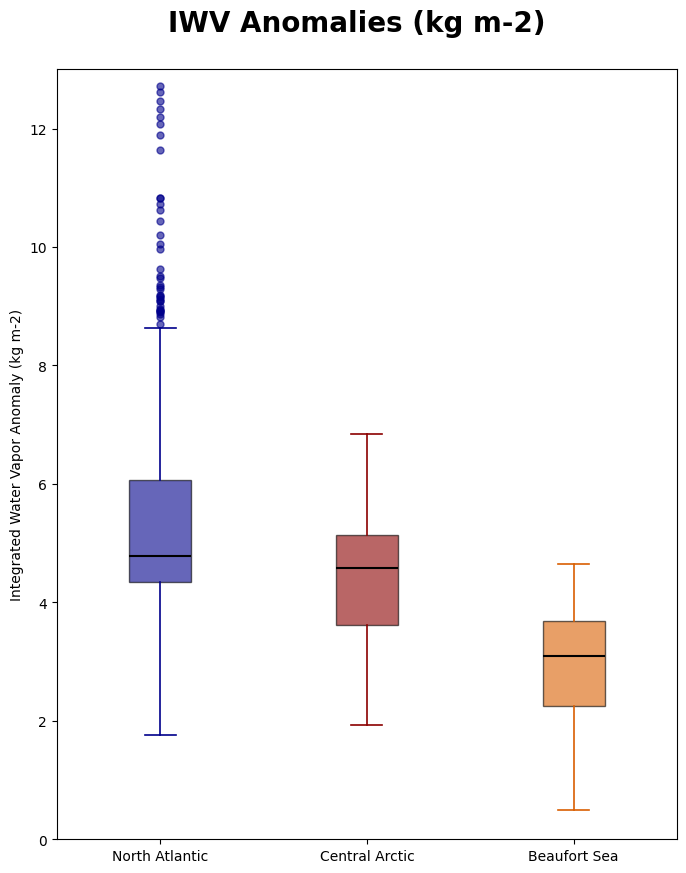

In [32]:
plot_box_years(NA_anomalies_prw_new,CA_anomalies_prw_new,BS_anomalies_prw_new,f'IWV Anomalies ({data_in_prw.units})',f'Integrated Water Vapor Anomaly ({data_in_prw.units})',0,13)

In [33]:
with open(f'{ERA5_clim_path}/shapelists/prw_clim_list.pkl', 'rb') as f:
        prw_clim_list = pickle.load(f)

clim_NA = prw_clim_list[0]['prw'].mean(dim='time').mean(dim=('lat','lon')).values
clim_CA = prw_clim_list[1]['prw'].mean(dim='time').mean(dim=('lat','lon')).values
clim_BS = prw_clim_list[2]['prw'].mean(dim='time').mean(dim=('lat','lon')).values
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')  

 Clim NA: 4.58 
 CA: 2.20 
 BS: 2.40


 Clim NA: 4.58 
 CA: 2.20 
 BS: 2.40
NA — Mean: 5.4564, Median: 4.7775, Min: 1.7639, Max: 13.2136, Std Dev: 1.8818
CA — Mean: 4.4521, Median: 4.5723, Min: 1.9251, Max: 6.8492, Std Dev: 1.1349
BS — Mean: 2.8865, Median: 3.0938, Min: 0.4895, Max: 4.6412, Std Dev: 0.9662


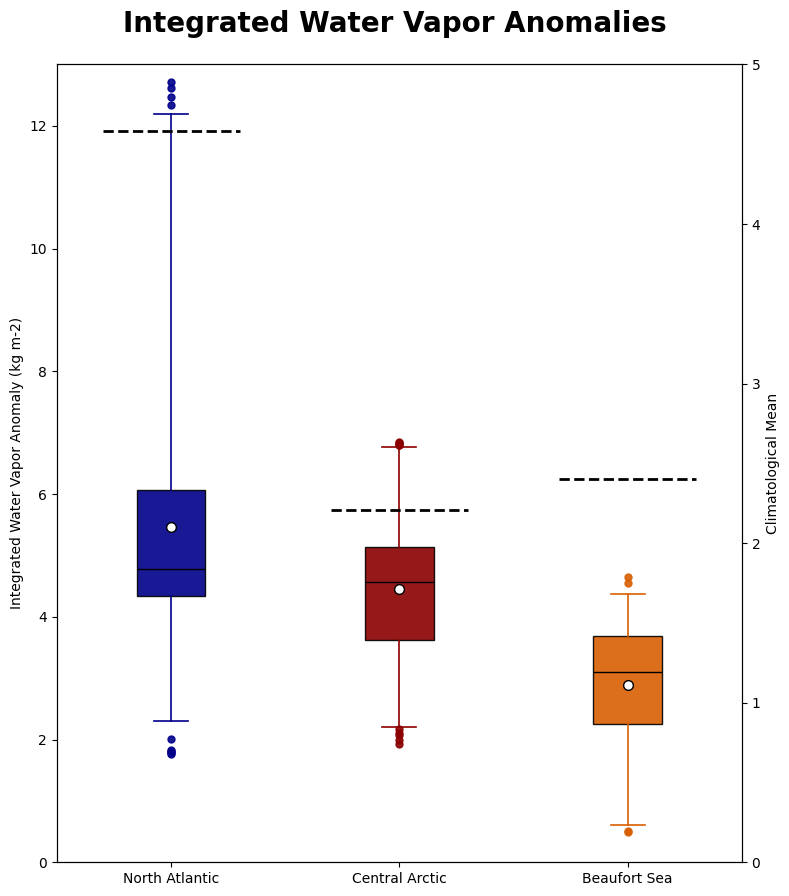

In [34]:
with open(f'{ERA5_clim_path}/shapelists/prw_clim_list.pkl', 'rb') as f:
        prw_clim_list = pickle.load(f)
plot_box_years_new(NA_anomalies_prw_new,CA_anomalies_prw_new,BS_anomalies_prw_new,prw_clim_list,'prw',f'Integrated Water Vapor Anomalies',f'Integrated Water Vapor Anomaly (kg m-2)',0,13,0,5)

 Clim NA: 4.58 
 CA: 2.20 
 BS: 2.40
NA — Mean: 5.4564, Median: 4.7775, Min: 1.7639, Max: 13.2136, Std Dev: 1.8818
CA — Mean: 4.4521, Median: 4.5723, Min: 1.9251, Max: 6.8492, Std Dev: 1.1349
BS — Mean: 2.8865, Median: 3.0938, Min: 0.4895, Max: 4.6412, Std Dev: 0.9662


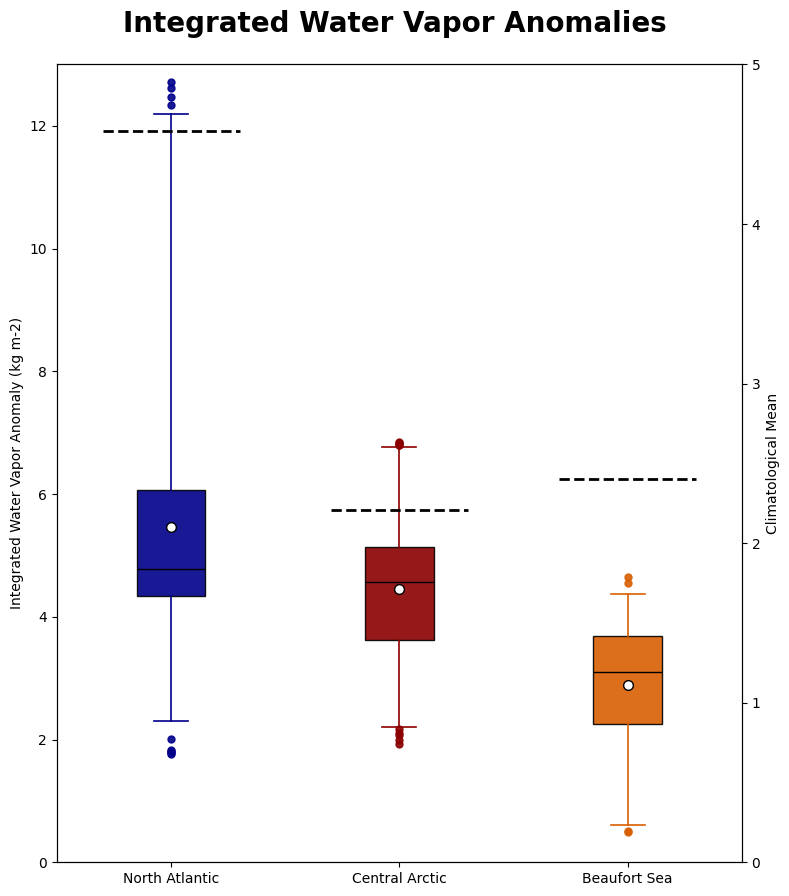

In [35]:
plot_box_years_new(NA_anomalies_prw_new,CA_anomalies_prw_new,BS_anomalies_prw_new,prw_clim_list,'prw',f'Integrated Water Vapor Anomalies',f'Integrated Water Vapor Anomaly (kg m-2)',0,13,0,5)

In [ ]:
plot_violin_years(NA_anomalies_prw_new,CA_anomalies_prw_new,BS_anomalies_prw_new,'','',0,15)

#### pr

In [36]:
#precipitation
ds_pr = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/pr/r1i1p1/pr_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_pr = ds_pr.sel(lat=slice(50,None))
ds_pr = ds_pr.sel(time=slice("1979-01-01","2022-12-31"))

In [37]:
data_in_pr = ds_pr['pr']*3600 #1kg/m2 = 1mm to change unit from [kg m-2 s-1] to [mm h-1]
data_out_pr = transform_coords_to_rot(data_in_pr)

In [38]:
# Create shapes for each domain
NA_shapes_pr = create_masked_lists(objs_final,ds_moaap,data_out_pr,80, 67, 60, -30)
CA_shapes_pr = create_masked_lists(objs_final,ds_moaap,data_out_pr,90, 80, 180, -180)
BS_shapes_pr = create_masked_lists(objs_final,ds_moaap,data_out_pr,80, 70, 120, -120, True)

In [39]:
NA_shapes_pr = [NA_shapes_pr[i].compute() for i in range(len(NA_shapes_pr))]
CA_shapes_pr = [CA_shapes_pr[i].compute() for i in range(len(CA_shapes_pr))]
BS_shapes_pr = [BS_shapes_pr[i].compute() for i in range(len(BS_shapes_pr))]

In [ ]:
plot_scatter_domains(NA_shapes_pr,CA_shapes_pr,BS_shapes_pr,list_ids,f'pr [{data_in_pr.units}]',f'Precipitation [{data_in_pr.units}] Across Domains')

In [40]:
pr_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/pr/clim/pr_clim_day_DJF.nc')

pr_clim_DJF_sd = pr_clim_DJF.assign_coords(lon=((pr_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [ ]:
pr_NA_clim_sd = pr_clim_DJF_sd.where((pr_clim_DJF_sd.lat>=67) & (pr_clim_DJF_sd.lat<=80) & (pr_clim_DJF_sd.lon>=-30) & (pr_clim_DJF_sd.lon<=60))
pr_CA_clim_sd = pr_clim_DJF_sd.where((pr_clim_DJF_sd.lat>=80) & (pr_clim_DJF_sd.lat<=90) & (pr_clim_DJF_sd.lon>=-180) & (pr_clim_DJF_sd.lon<=180))
pr_BS_clim_sd = pr_clim_DJF_sd.where(
    ((pr_clim_DJF_sd.lat >= 70) & (pr_clim_DJF_sd.lat <= 80)) &  ((pr_clim_DJF_sd.lon >= -180) & (pr_clim_DJF_sd.lon <= -120)) |  ((pr_clim_DJF_sd.lat >= 70) & (pr_clim_DJF_sd.lat <= 80)) & ((pr_clim_DJF_sd.lon >= 120) & (pr_clim_DJF_sd.lon <= 180)))

In [ ]:
plot_masked_shapes_clim(NA_shapes_pr,CA_shapes_pr,BS_shapes_pr,
                                   (pr_NA_clim_sd['pr']*3600).mean(dim=("lat","lon")),(pr_CA_clim_sd['pr']*3600).mean(dim=("lat","lon")),(pr_BS_clim_sd['pr']*3600).mean(dim=("lat","lon")),
                                    list_ids,f'Precipitation [{data_in_pr.units}]', f'Precipitation [mm h-1] Across Domains',vmin=-3,vmax=10,clim=True)

In [ ]:
# Create mean values for each domain using the shape approach
pr_list_domains = create_masked_lists_shapes(data_out_pr,domains)

In [ ]:
plot_masked_shapes_clim(pr_list_domains[0], pr_list_domains[1], pr_list_domains[2],
                                   pr_NA_clim_sd['pr'].mean(dim=("lat","lon")),pr_CA_clim_sd['pr'].mean(dim=("lat","lon")),pr_BS_clim_sd['pr'].mean(dim=("lat","lon")),
                                   list_ids,f'Precipitation [{data_in_pr.units}]', f'Precipitation [mm h-1] Across Domains',vmin=-3,vmax=10,clim=True)

##### Anomalies

In [41]:
NA_pr_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_pr,pr_clim_DJF["pr"]*3600,80, 67, 60, -30)
CA_pr_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_pr,pr_clim_DJF["pr"]*3600,90, 80, 180, -180)
BS_pr_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_pr,pr_clim_DJF["pr"]*3600,80, 70, 120, -120, True)

In [42]:
NA_pr_anomalies = [NA_pr_anomalies[i].compute() for i in range(len(NA_pr_anomalies))]
CA_pr_anomalies = [CA_pr_anomalies[i].compute() for i in range(len(CA_pr_anomalies))]
BS_pr_anomalies = [BS_pr_anomalies[i].compute() for i in range(len(BS_pr_anomalies))]

In [43]:
plot_masked_shapes_clim(NA_pr_anomalies,CA_pr_anomalies,BS_pr_anomalies,
                                   pr_NA_clim_sd['pr'].mean(dim=("lat","lon")),pr_CA_clim_sd ['pr'].mean(dim=("lat","lon")),pr_BS_clim_sd['pr'].mean(dim=("lat","lon")),
                                   list_ids,f'pr anomaly [{data_in_pr.units}]',f'Precipitation Anomalies[{data_in_pr.units}] Across Domains',vmin =-0.0005, vmax = 0.0005,bars=False)

NameError: name 'pr_NA_clim_sd' is not defined

In [67]:
NA_anomalies_pr_new = np.concatenate([da.values.flatten() for da in NA_pr_anomalies if da is not None])
CA_anomalies_pr_new = np.concatenate([da.values.flatten() for da in CA_pr_anomalies if da is not None])
BS_anomalies_pr_new = np.concatenate([da.values.flatten() for da in BS_pr_anomalies if da is not None])

NA — Mean: 0.2004, Median: 0.1464, Min: -0.0426, Max: 1.5561, Std Dev: 0.2348
CA — Mean: 0.1015, Median: 0.0867, Min: -0.0160, Max: 0.4689, Std Dev: 0.0837
BS — Mean: 0.0659, Median: 0.0638, Min: -0.0076, Max: 0.1867, Std Dev: 0.0351


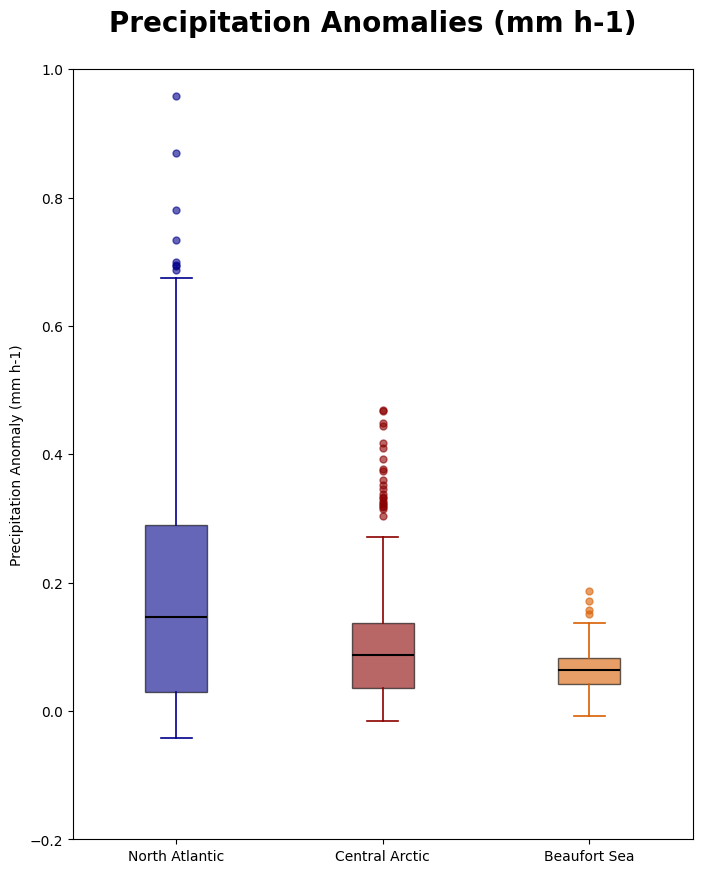

In [68]:
plot_box_years(NA_anomalies_pr_new,CA_anomalies_pr_new,BS_anomalies_pr_new,f'Precipitation Anomalies (mm h-1)',f'Precipitation Anomaly (mm h-1)',-0.2,1)

In [69]:
#Get list of climatology for each domain 
var = 'pr'
ds_clim = pr_clim_DJF

NA_clim = ds_clim.where((ds_clim.lat>=67) & (ds_clim.lat<=80) & (ds_clim.lon>=-30) & (ds_clim.lon<=60))
CA_clim = ds_clim.where((ds_clim.lat>=80) & (ds_clim.lat<=90) & (ds_clim.lon>=-180) & (ds_clim.lon<=180))
BS_clim = ds_clim.where(
((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) &  ((ds_clim.lon >= -180) & (ds_clim.lon <= -120)) |
    ((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) & ((ds_clim.lon >= 120) & (ds_clim.lon <= 180)))

clim_list = [NA_clim, CA_clim, BS_clim]

#Save the lists as pkl files once


with open(f'{ERA5_clim_path}/shapelists/{var}_clim_list.pkl', 'wb') as f:
    pickle.dump(clim_list, f)

with open(f'{ERA5_clim_path}/shapelists/pr_clim_list.pkl', 'rb') as f:
        pr_clim_list = pickle.load(f)

In [70]:
with open(f'{ERA5_clim_path}/shapelists/pr_clim_list.pkl', 'rb') as f:
        pr_clim_list = pickle.load(f)

In [71]:
with open(f'{ERA5_clim_path}/shapelists/pr_clim_list.pkl', 'rb') as f:
        pr_clim_list = pickle.load(f)

clim_NA = pr_clim_list[0]['pr'].mean(dim='time').mean(dim=('lat','lon')).values*3600
clim_CA = pr_clim_list[1]['pr'].mean(dim='time').mean(dim=('lat','lon')).values*3600
clim_BS = pr_clim_list[2]['pr'].mean(dim='time').mean(dim=('lat','lon')).values*3600
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')  

 Clim NA: 0.09 
 CA: 0.02 
 BS: 0.02


 Clim NA: 0.09 
 CA: 0.02 
 BS: 0.02
NA — Mean: 0.2004, Median: 0.1464, Min: -0.0426, Max: 1.5561, Std Dev: 0.2348
CA — Mean: 0.1015, Median: 0.0867, Min: -0.0160, Max: 0.4689, Std Dev: 0.0837
BS — Mean: 0.0659, Median: 0.0638, Min: -0.0076, Max: 0.1867, Std Dev: 0.0351


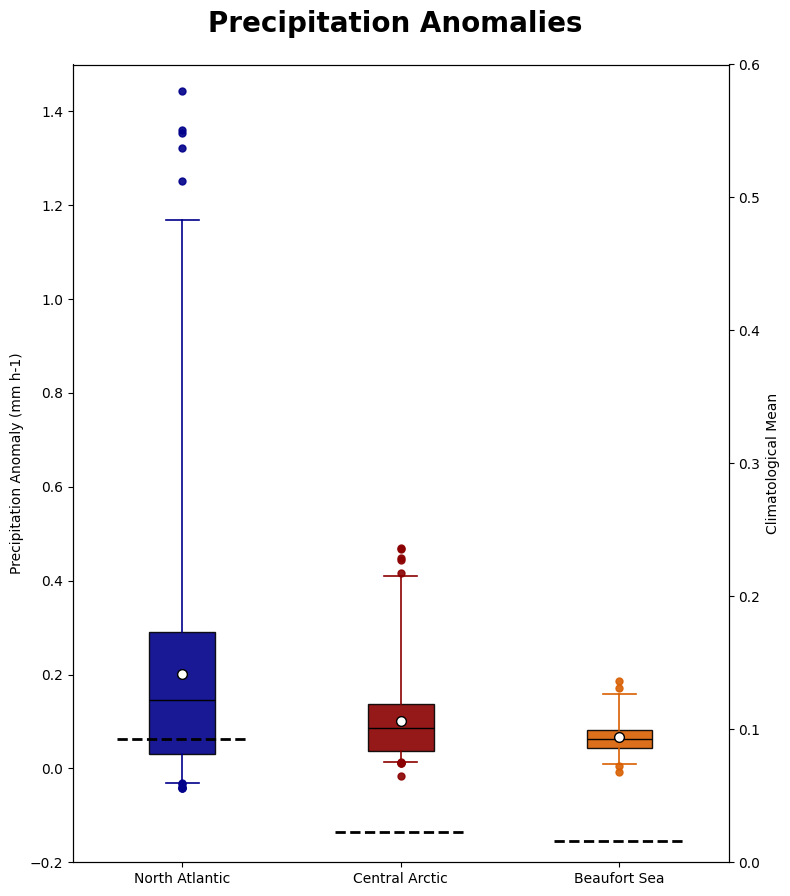

In [72]:
plot_box_years_new(NA_anomalies_pr_new,CA_anomalies_pr_new,BS_anomalies_pr_new,pr_clim_list,'pr',f'Precipitation Anomalies',f'Precipitation Anomaly (mm h-1)',-0.2,1.5,0,0.6)

#### rlds

In [73]:
# Surface Down Longwave Radiation
ds_rlds = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/rlds/r1i1p1/rlds_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_rlds = ds_rlds.sel(lat=slice(50,None))
ds_rlds = ds_rlds.sel(time=slice("1979-01-01","2022-12-31"))

In [74]:
data_in_rlds = ds_rlds['rlds']
data_out_rlds = transform_coords_to_rot(data_in_rlds)

In [75]:
# Create shapes for each domain
NA_shapes_rlds = create_masked_lists(objs_final,ds_moaap,data_out_rlds,80, 67, 60, -30)
CA_shapes_rlds = create_masked_lists(objs_final,ds_moaap,data_out_rlds,90, 80, 180, -180)
BS_shapes_rlds = create_masked_lists(objs_final,ds_moaap,data_out_rlds,80, 70, 120, -120, True)

In [76]:
NA_shapes_rlds = [NA_shapes_rlds[i].compute() for i in range(len(NA_shapes_rlds))]
CA_shapes_rlds = [CA_shapes_rlds[i].compute() for i in range(len(CA_shapes_rlds))]
BS_shapes_rlds = [BS_shapes_rlds[i].compute() for i in range(len(BS_shapes_rlds))]

In [ ]:
plot_scatter_domains(NA_shapes_rlds,CA_shapes_rlds,BS_shapes_rlds,list_ids,'rlds [W/m²]',f'Surface Down Longwave Radiation [{data_in_rlds.units}] Across Domains')

In [77]:
rlds_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/rlds/clim/rlds_clim_day_DJF.nc')

rlds_clim_DJF_sd = rlds_clim_DJF.assign_coords(lon=((rlds_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [82]:
rlds_NA_clim_sd = rlds_clim_DJF_sd.where((rlds_clim_DJF_sd.lat>=67) & (rlds_clim_DJF_sd.lat<=80) & (rlds_clim_DJF_sd.lon>=-30) & (rlds_clim_DJF_sd.lon<=60))
rlds_CA_clim_sd = rlds_clim_DJF_sd.where((rlds_clim_DJF_sd.lat>=80) & (rlds_clim_DJF_sd.lat<=90) & (rlds_clim_DJF_sd.lon>=-180) & (rlds_clim_DJF_sd.lon<=180))
rlds_BS_clim_sd = rlds_clim_DJF_sd.where(
    ((rlds_clim_DJF_sd.lat >= 70) & (rlds_clim_DJF_sd.lat <= 80)) &  ((rlds_clim_DJF_sd.lon >= -180) & (rlds_clim_DJF_sd.lon <= -120)) |  ((rlds_clim_DJF_sd.lat >= 70) & (rlds_clim_DJF_sd.lat <= 80)) & ((rlds_clim_DJF_sd.lon >= 120) & (rlds_clim_DJF_sd.lon <= 180)))

In [ ]:
#Only those times were considered, in which center of mass of object was in domain
plot_masked_shapes_clim(NA_shapes_rlds, CA_shapes_rlds, BS_shapes_rlds,
                                   rlds_NA_clim_sd['rlds'].mean(dim=("lat","lon")),rlds_CA_clim_sd['rlds'].mean(dim=("lat","lon")),rlds_BS_clim_sd['rlds'].mean(dim=("lat","lon")),
                                   list_ids,f'Surface Down Longwave Radiation [{data_in_rlds.units}]', f'Surface Down Longwave Radiation[{data_in_rlds.units}] Across Domains',vmin=150,vmax=350,clim=True)

In [ ]:
# Create mean values for each domain using the shape approach -> not center of mass (10% of all 
rlds_list_domains = create_masked_lists_shapes(data_out_rlds,domains)

#Plot
plot_masked_shapes_clim(rlds_list_domains[0], rlds_list_domains[1], rlds_list_domains[2],
                                   rlds_NA_clim_sd['rlds'].mean(dim=("lat","lon")),rlds_CA_clim_sd['rlds'].mean(dim=("lat","lon")),rlds_BS_clim_sd['rlds'].mean(dim=("lat","lon")),
                                   list_ids,f'Surface Down Longwave Radiation [{data_in_rlds.units}]', f'Surface Down Longwave Radiation[{data_in_rlds.units}] Across Domains',vmin=150,vmax=350,clim=True)


##### Anomalies

In [78]:
NA_rlds_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_rlds,rlds_clim_DJF["rlds"],80, 67, 60, -30)
CA_rlds_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_rlds,rlds_clim_DJF["rlds"],90, 80, 180, -180)
BS_rlds_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_rlds,rlds_clim_DJF["rlds"],80, 70, 120, -120, True)

In [79]:
NA_rlds_anomalies = [NA_rlds_anomalies[i].compute() for i in range(len(NA_rlds_anomalies))]
CA_rlds_anomalies = [CA_rlds_anomalies[i].compute() for i in range(len(CA_rlds_anomalies))]
BS_rlds_anomalies = [BS_rlds_anomalies[i].compute() for i in range(len(BS_rlds_anomalies))]

In [ ]:
plot_masked_shapes_clim(NA_rlds_anomalies,CA_rlds_anomalies,BS_rlds_anomalies,
                                   rlds_NA_clim_sd['rlds'].mean(dim=("lat","lon")),rlds_CA_clim_sd['rlds'].mean(dim=("lat","lon")),rlds_BS_clim_sd['rlds'].mean(dim=("lat","lon")),
                                   list_ids,f'rlds anomaly [{data_in_rlds.units}]',f'Surface Down Longwave Radiation Anomalies [{data_in_rlds.units}] Across Domains',vmin =0, vmax = 110,bars=False)

In [80]:
NA_anomalies_rlds_new = np.concatenate([da.values.flatten() for da in NA_rlds_anomalies if da is not None])
CA_anomalies_rlds_new = np.concatenate([da.values.flatten() for da in CA_rlds_anomalies if da is not None])
BS_anomalies_rlds_new = np.concatenate([da.values.flatten() for da in BS_rlds_anomalies if da is not None])

NA — Mean: 52.6428, Median: 52.0690, Min: 33.1621, Max: 75.3415, Std Dev: 9.1632
CA — Mean: 91.4537, Median: 92.5319, Min: 53.4733, Max: 107.6404, Std Dev: 8.8719
BS — Mean: 72.1633, Median: 76.1484, Min: 23.7563, Max: 94.7191, Std Dev: 17.0379


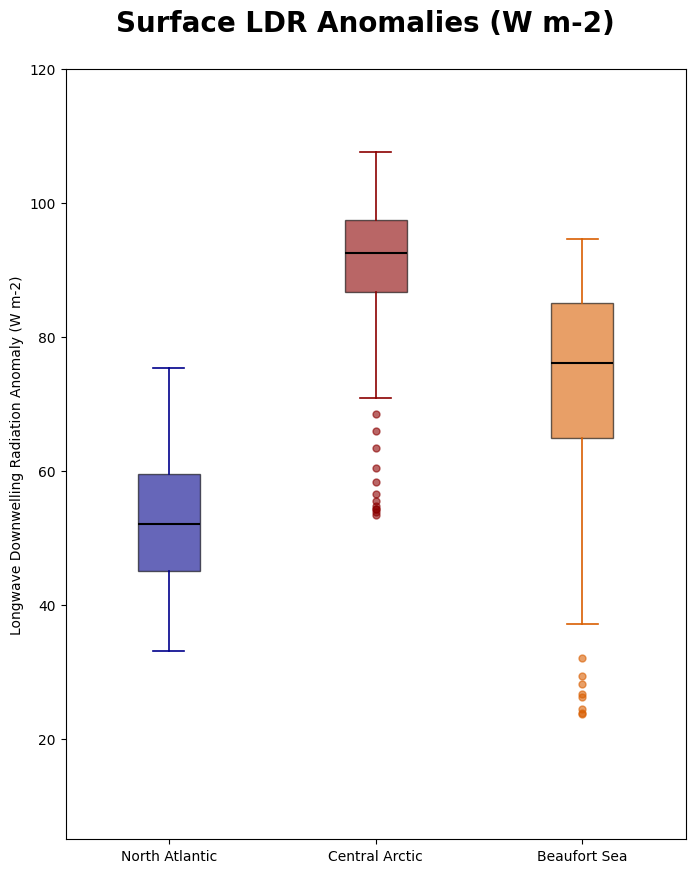

In [81]:
plot_box_years(NA_anomalies_rlds_new,CA_anomalies_rlds_new,BS_anomalies_rlds_new,f'Surface LDR Anomalies ({data_in_rlds.units})',f'Longwave Downwelling Radiation Anomaly ({data_in_rlds.units})',5,120)

In [82]:
with open(f'{ERA5_clim_path}/shapelists/rlds_clim_list.pkl', 'rb') as f:
        rlds_clim_list = pickle.load(f)

In [83]:
with open(f'{ERA5_clim_path}/shapelists/rlds_clim_list.pkl', 'rb') as f:
        rlds_clim_list = pickle.load(f)

clim_NA = rlds_clim_list[0]['rlds'].mean(dim='time').mean(dim=('lat','lon')).values
clim_CA = rlds_clim_list[1]['rlds'].mean(dim='time').mean(dim=('lat','lon')).values
clim_BS = rlds_clim_list[2]['rlds'].mean(dim='time').mean(dim=('lat','lon')).values
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')  

 Clim NA: 233.67 
 CA: 174.68 
 BS: 172.61


 Clim NA: 233.67 
 CA: 174.68 
 BS: 172.61
NA — Mean: 52.6428, Median: 52.0690, Min: 33.1621, Max: 75.3415, Std Dev: 9.1632
CA — Mean: 91.4537, Median: 92.5319, Min: 53.4733, Max: 107.6404, Std Dev: 8.8719
BS — Mean: 72.1633, Median: 76.1484, Min: 23.7563, Max: 94.7191, Std Dev: 17.0379


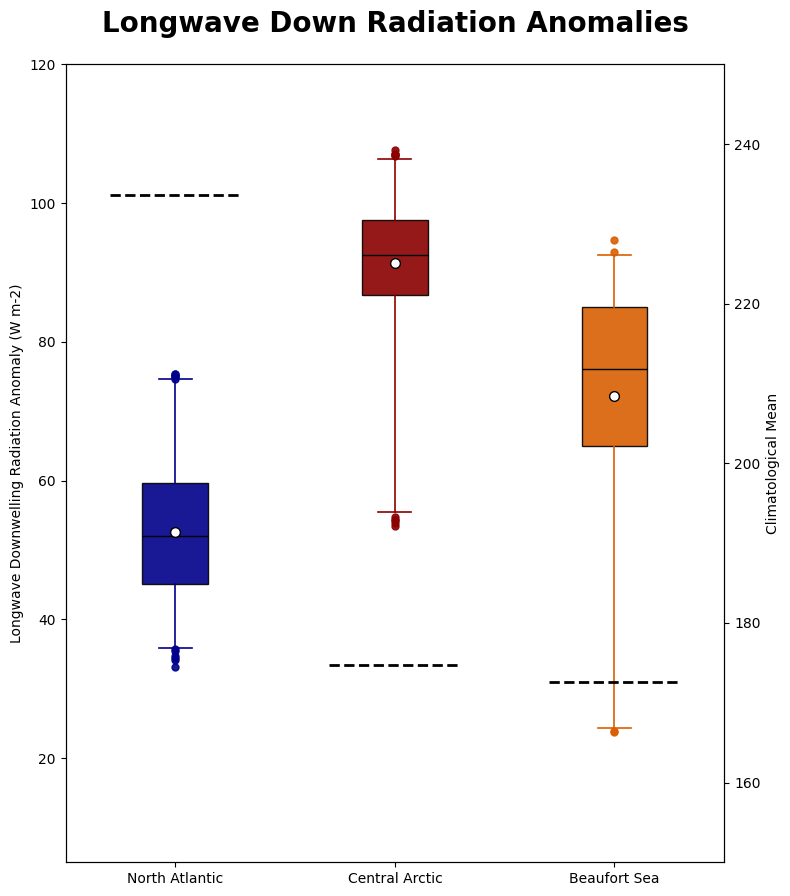

In [84]:
plot_box_years_new(NA_anomalies_rlds_new,CA_anomalies_rlds_new,BS_anomalies_rlds_new,rlds_clim_list,'rlds',f'Longwave Down Radiation Anomalies',f'Longwave Downwelling Radiation Anomaly (W m-2)',5,120,150,250)

#### sfcWind

In [85]:
#Near Surface Wind Speed
ds_sfcwind = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/sfcWind/r1i1p1/sfcWind_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_sfcwind = ds_sfcwind.sel(lat=slice(50,None))
ds_sfcwind = ds_sfcwind.sel(time=slice("1979-01-01","2022-12-31"))

In [86]:
#Near Surface Wind Speed
data_in_sfcwind = ds_sfcwind['sfcWind']
data_out_sfcwind = transform_coords_to_rot(data_in_sfcwind)

In [87]:
# Create shapes for each domain
NA_shapes_sfcwind = create_masked_lists(objs_final,ds_moaap,data_out_sfcwind,80, 67, 60, -30)
CA_shapes_sfcwind = create_masked_lists(objs_final,ds_moaap,data_out_sfcwind,90, 80, 180, -180)
BS_shapes_sfcwind = create_masked_lists(objs_final,ds_moaap,data_out_sfcwind,80, 70, 120, -120, True)

In [88]:
NA_shapes_sfcwind = [NA_shapes_sfcwind[i].compute() for i in range(len(NA_shapes_sfcwind))]
CA_shapes_sfcwind = [CA_shapes_sfcwind[i].compute() for i in range(len(CA_shapes_sfcwind))]
BS_shapes_sfcwind = [BS_shapes_sfcwind[i].compute() for i in range(len(BS_shapes_sfcwind))]

In [ ]:
plot_scatter_domains(NA_shapes_sfcwind,CA_shapes_sfcwind,BS_shapes_sfcwind,list_ids,f'sfcwind [{data_in_sfcwind.units}]',f'Near-Surface Wind Speed [{data_in_sfcwind.units}] Across Domains')

In [89]:
sfcwind_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/sfcWind/clim/sfcWind_clim_day_DJF.nc')
#sfcwind_clim_DJF_sd = sfcwind_clim_DJF.assign_coords(lon=((sfcwind_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [ ]:
sfcwind_NA_clim_sd = sfcwind_clim_DJF_sd.where((sfcwind_clim_DJF_sd.lat>=67) & (sfcwind_clim_DJF_sd.lat<=80) & (sfcwind_clim_DJF_sd.lon>=-30) & (sfcwind_clim_DJF_sd.lon<=60))
sfcwind_CA_clim_sd = sfcwind_clim_DJF_sd.where((sfcwind_clim_DJF_sd.lat>=80) & (sfcwind_clim_DJF_sd.lat<=90) & (sfcwind_clim_DJF_sd.lon>=-180) & (sfcwind_clim_DJF_sd.lon<=180))
sfcwind_BS_clim_sd = sfcwind_clim_DJF_sd.where(
    ((sfcwind_clim_DJF_sd.lat >= 70) & (sfcwind_clim_DJF_sd.lat <= 80)) &  ((sfcwind_clim_DJF_sd.lon >= -180) & (sfcwind_clim_DJF_sd.lon <= -120)) |  ((sfcwind_clim_DJF_sd.lat >= 70) & (sfcwind_clim_DJF_sd.lat <= 80)) & ((sfcwind_clim_DJF_sd.lon >= 120) & (sfcwind_clim_DJF_sd.lon <= 180)))


In [ ]:
plot_masked_shapes_clim(NA_shapes_sfcwind, CA_shapes_sfcwind, BS_shapes_sfcwind,
                                   sfcwind_NA_clim_sd['sfcWind'].mean(dim=("lat","lon")),sfcwind_CA_clim_sd['sfcWind'].mean(dim=("lat","lon")),sfcwind_BS_clim_sd['sfcWind'].mean(dim=("lat","lon")),
                                   list_ids,f'Near-surface Wind Speed [{data_in_sfcwind.units}]', f'Near-surface Wind Speed [{data_in_sfcwind.units}] Across Domains',vmin=0,vmax=22,clim=True)

In [ ]:
# Create mean values for each domain using the shape apsfcwindoach
sfcwind_list_domains = create_masked_lists_shapes(data_out_sfcwind,domains)

#Plot
plot_masked_shapes_clim(sfcwind_list_domains[0], sfcwind_list_domains[1], sfcwind_list_domains[2],
                                   sfcwind_NA_clim_sd['sfcWind'].mean(dim=("lat","lon")),sfcwind_CA_clim_sd['sfcWind'].mean(dim=("lat","lon")),sfcwind_BS_clim_sd['sfcWind'].mean(dim=("lat","lon")),
                                   list_ids,f'Near-surface Wind Speed [{data_in_sfcwind.units}]', f'Near-surface Wind Speed [{data_in_sfcwind.units}] Across Domains',vmin=0,vmax=22,clim=True)


##### Anomalies

In [90]:
NA_sfcwind_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_sfcwind,sfcwind_clim_DJF["sfcWind"],80, 67, 60, -30)
CA_sfcwind_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_sfcwind,sfcwind_clim_DJF["sfcWind"],90, 80, 180, -180)
BS_sfcwind_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_sfcwind,sfcwind_clim_DJF["sfcWind"],80, 70, 120, -120, True)

In [91]:
NA_sfcwind_anomalies = [NA_sfcwind_anomalies[i].compute() for i in range(len(NA_sfcwind_anomalies))]
CA_sfcwind_anomalies = [CA_sfcwind_anomalies[i].compute() for i in range(len(CA_sfcwind_anomalies))]
BS_sfcwind_anomalies = [BS_sfcwind_anomalies[i].compute() for i in range(len(BS_sfcwind_anomalies))]

In [ ]:
plot_masked_shapes_clim(NA_sfcwind_anomalies, CA_sfcwind_anomalies, BS_sfcwind_anomalies,
                                   sfcwind_NA_clim_sd['sfcWind'].mean(dim=("lat","lon")),sfcwind_CA_clim_sd['sfcWind'].mean(dim=("lat","lon")),sfcwind_BS_clim_sd['sfcWind'].mean(dim=("lat","lon")),
                                   list_ids,f'sfcWind anomaly [{data_in_sfcwind.units}]', f'Near-surface Wind Speed Anomalies [{data_in_sfcwind.units}] Across Domains',vmin=-3,vmax=18,bars=False)

In [92]:
NA_anomalies_sfcwind_new = np.concatenate([da.values.flatten() for da in NA_sfcwind_anomalies if da is not None])
CA_anomalies_sfcwind_new = np.concatenate([da.values.flatten() for da in CA_sfcwind_anomalies if da is not None])
BS_anomalies_sfcwind_new = np.concatenate([da.values.flatten() for da in BS_sfcwind_anomalies if da is not None])

NA — Mean: 2.8297, Median: 2.7545, Min: -1.9871, Max: 7.3037, Std Dev: 1.9566
CA — Mean: 5.8151, Median: 5.5320, Min: -2.0183, Max: 14.1265, Std Dev: 2.7463
BS — Mean: 5.9269, Median: 4.9513, Min: 2.4584, Max: 12.6058, Std Dev: 2.8953


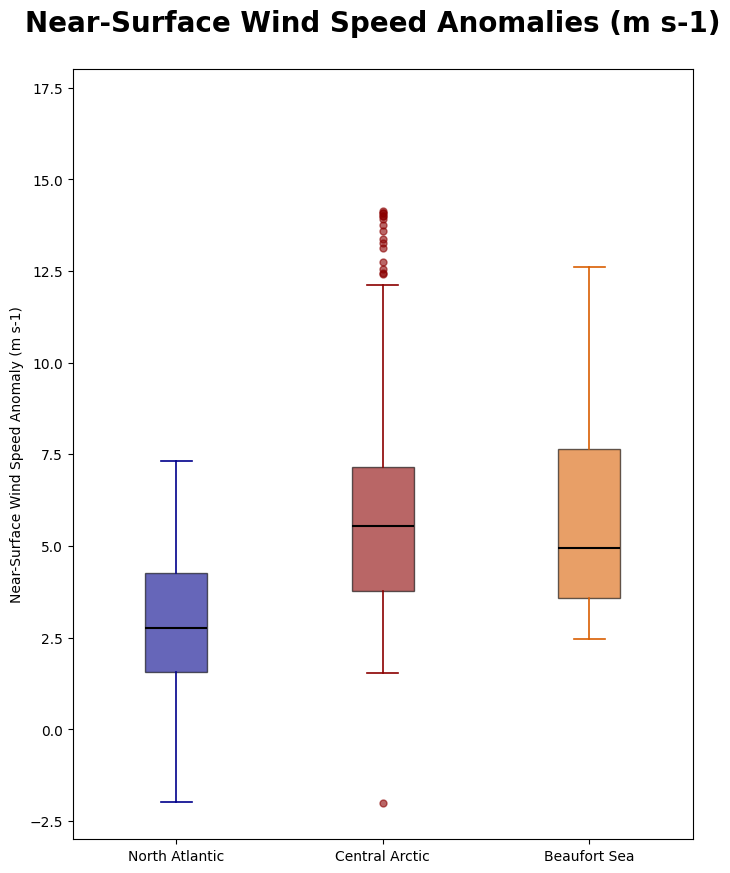

In [93]:
plot_box_years(NA_anomalies_sfcwind_new,CA_anomalies_sfcwind_new,BS_anomalies_sfcwind_new,f'Near-Surface Wind Speed Anomalies ({data_in_sfcwind.units})',f'Near-Surface Wind Speed Anomaly ({data_in_sfcwind.units})',-3,18)

In [94]:
#Get list of climatology for each domain 
var = 'sfcWind'
ds_clim = sfcwind_clim_DJF

NA_clim = ds_clim.where((ds_clim.lat>=67) & (ds_clim.lat<=80) & (ds_clim.lon>=-30) & (ds_clim.lon<=60))
CA_clim = ds_clim.where((ds_clim.lat>=80) & (ds_clim.lat<=90) & (ds_clim.lon>=-180) & (ds_clim.lon<=180))
BS_clim = ds_clim.where(
((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) &  ((ds_clim.lon >= -180) & (ds_clim.lon <= -120)) |
    ((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) & ((ds_clim.lon >= 120) & (ds_clim.lon <= 180)))

clim_list = [NA_clim, CA_clim, BS_clim]

#Save the lists as pkl files once


with open(f'{ERA5_clim_path}/shapelists/{var}_clim_list.pkl', 'wb') as f:
    pickle.dump(clim_list, f)

In [95]:
with open(f'{ERA5_clim_path}/shapelists/sfcWind_clim_list.pkl', 'rb') as f:
        sfcWind_clim_list = pickle.load(f)

In [96]:
with open(f'{ERA5_clim_path}/shapelists/sfcWind_clim_list.pkl', 'rb') as f:
        sfcWind_clim_list = pickle.load(f)

clim_NA = sfcWind_clim_list[0]['sfcWind'].mean(dim='time').mean(dim=('lat','lon')).values
clim_CA = sfcWind_clim_list[1]['sfcWind'].mean(dim='time').mean(dim=('lat','lon')).values
clim_BS = sfcWind_clim_list[2]['sfcWind'].mean(dim='time').mean(dim=('lat','lon')).values
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')  

 Clim NA: 8.01 
 CA: 6.60 
 BS: 5.61


 Clim NA: 8.01 
 CA: 6.60 
 BS: 5.61
NA — Mean: 2.8297, Median: 2.7545, Min: -1.9871, Max: 7.3037, Std Dev: 1.9566
CA — Mean: 5.8151, Median: 5.5320, Min: -2.0183, Max: 14.1265, Std Dev: 2.7463
BS — Mean: 5.9269, Median: 4.9513, Min: 2.4584, Max: 12.6058, Std Dev: 2.8953


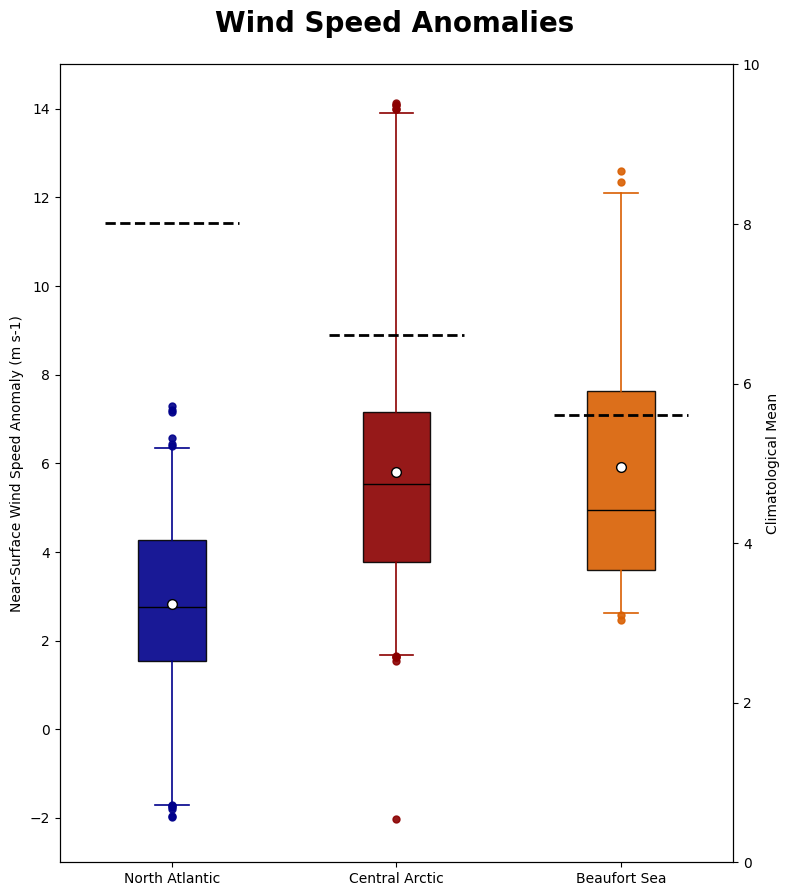

In [97]:
plot_box_years_new(NA_anomalies_sfcwind_new,CA_anomalies_sfcwind_new,BS_anomalies_sfcwind_new,sfcWind_clim_list,'sfcWind',f'Wind Speed Anomalies',f'Near-Surface Wind Speed Anomaly (m s-1)',-3,15,0,10)

#### lcc

In [98]:
#Near Surface Wind Speed
ds_lcc = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/lcc/r1i1p1/lcc_1hr-cf_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_lcc = ds_lcc.sel(lat=slice(30,None))
ds_lcc = ds_lcc.sel(time=slice("1979-01-01","2022-12-31")) 

In [266]:
#Low level cloud cover
data_in_lcc = ds_lcc['lcc']
data_out_lcc = transform_coords_to_rot(data_in_lcc)

In [267]:
# Create shapes for each domain
NA_shapes_lcc = create_masked_lists(objs_final,ds_moaap,data_out_lcc,80, 67, 60, -30)
CA_shapes_lcc = create_masked_lists(objs_final,ds_moaap,data_out_lcc,90, 80, 180, -180)
BS_shapes_lcc = create_masked_lists(objs_final,ds_moaap,data_out_lcc,80, 70, 120, -120, True)

In [268]:
NA_shapes_lcc = [NA_shapes_lcc[i].compute() for i in range(len(NA_shapes_lcc))]
CA_shapes_lcc = [CA_shapes_lcc[i].compute() for i in range(len(CA_shapes_lcc))]
BS_shapes_lcc = [BS_shapes_lcc[i].compute() for i in range(len(BS_shapes_lcc))]

In [ ]:
plot_scatter_domains(NA_shapes_lcc,CA_shapes_lcc,BS_shapes_lcc,list_ids,f'lcc [{data_in_lcc.units}]',f'Low Level Clouds [{data_in_lcc.units}] Across Domains')

In [276]:
lcc_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/lcc/clim/lcc_clim_day_DJF.nc')
lcc_clim_DJF_sd = lcc_clim_DJF.assign_coords(lon=((lcc_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [273]:
lcc_NA_clim_sd = lcc_clim_DJF_sd.where((lcc_clim_DJF_sd.lat>=67) & (lcc_clim_DJF_sd.lat<=80) & (lcc_clim_DJF_sd.lon>=-30) & (lcc_clim_DJF_sd.lon<=60))
lcc_CA_clim_sd = lcc_clim_DJF_sd.where((lcc_clim_DJF_sd.lat>=80) & (lcc_clim_DJF_sd.lat<=90) & (lcc_clim_DJF_sd.lon>=-180) & (lcc_clim_DJF_sd.lon<=180))
lcc_BS_clim_sd = lcc_clim_DJF_sd.where(
    ((lcc_clim_DJF_sd.lat >= 70) & (lcc_clim_DJF_sd.lat <= 80)) &  ((lcc_clim_DJF_sd.lon >= -180) & (lcc_clim_DJF_sd.lon <= -120)) |  ((lcc_clim_DJF_sd.lat >= 70) & (lcc_clim_DJF_sd.lat <= 80)) & ((lcc_clim_DJF_sd.lon >= 120) & (lcc_clim_DJF_sd.lon <= 180)))


In [ ]:
plot_masked_shapes_clim(NA_shapes_lcc, CA_shapes_lcc, BS_shapes_lcc,
                                   lcc_NA_clim_sd['lcc'].mean(dim=("lat","lon")),lcc_CA_clim_sd['lcc'].mean(dim=("lat","lon")),lcc_BS_clim_sd['lcc'].mean(dim=("lat","lon")),
                                   list_ids,f'lcc [{data_in_lcc.units}]', f'Low-Level Clouds [{data_in_lcc.units}] Across Domains',vmin=0,vmax=100,clim=True)

In [ ]:
# Create mean values for each domain using the shape aplccoach
lcc_list_domains = create_masked_lists_shapes(data_out_lcc,domains)

#Plot
plot_masked_shapes_clim(lcc_list_domains[0], lcc_list_domains[1], lcc_list_domains[2],
                                   lcc_NA_clim_sd['lcc'].mean(dim=("lat","lon")),lcc_CA_clim_sd['lcc'].mean(dim=("lat","lon")),lcc_BS_clim_sd['lcc'].mean(dim=("lat","lon")),
                                   list_ids,f'lcc [{data_in_lcc.units}]', f'Low-Level Clouds [{data_in_lcc.units}] Across Domains',vmin=0,vmax=100,clim=True)


##### Anomalies

In [277]:
NA_lcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_lcc,lcc_clim_DJF["lcc"],80, 67, 60, -30)
CA_lcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_lcc,lcc_clim_DJF["lcc"],90, 80, 180, -180)
BS_lcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_lcc,lcc_clim_DJF["lcc"],80, 70, 120, -120, True)

In [278]:
NA_lcc_anomalies = [NA_lcc_anomalies[i].compute() for i in range(len(NA_lcc_anomalies))]
CA_lcc_anomalies = [CA_lcc_anomalies[i].compute() for i in range(len(CA_lcc_anomalies))]
BS_lcc_anomalies = [BS_lcc_anomalies[i].compute() for i in range(len(BS_lcc_anomalies))]

In [ ]:
plot_masked_shapes_clim(NA_lcc_anomalies, CA_lcc_anomalies, BS_lcc_anomalies,
                                   lcc_NA_clim_sd['lcc'].mean(dim=("lat","lon")),lcc_CA_clim_sd['lcc'].mean(dim=("lat","lon")),lcc_BS_clim_sd['lcc'].mean(dim=("lat","lon")),
                                   list_ids,f'lcc anomaly [{data_in_lcc.units}]', f'Low-Level Clouds Anomalies [{data_in_lcc.units}] Across Domains',vmin=-40,vmax=80,bars=False)


#### mcc

In [280]:
#Mid-level cloud cover
ds_mcc = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/mcc/r1i1p1/mcc_1hr-cf_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_mcc = ds_mcc.sel(lat=slice(30,None))
ds_mcc = ds_mcc.sel(time=slice("1979-01-01","2022-12-31")) 

In [281]:
data_in_mcc = ds_mcc['mcc']
data_out_mcc = transform_coords_to_rot(data_in_mcc)

In [282]:
# Create shapes for each domain
NA_shapes_mcc = create_masked_lists(objs_final,ds_moaap,data_out_mcc,80, 67, 60, -30)
CA_shapes_mcc = create_masked_lists(objs_final,ds_moaap,data_out_mcc,90, 80, 180, -180)
BS_shapes_mcc = create_masked_lists(objs_final,ds_moaap,data_out_mcc,80, 70, 120, -120, True)

In [283]:
NA_shapes_mcc = [NA_shapes_mcc[i].compute() for i in range(len(NA_shapes_mcc))]
CA_shapes_mcc = [CA_shapes_mcc[i].compute() for i in range(len(CA_shapes_mcc))]
BS_shapes_mcc = [BS_shapes_mcc[i].compute() for i in range(len(BS_shapes_mcc))]

In [ ]:
plot_scatter_domains(NA_shapes_mcc,CA_shapes_mcc,BS_shapes_mcc,list_ids,f'mcc [{data_in_mcc.units}]',f'Mid Level Clouds [{data_in_mcc.units}] Across Domains')

In [285]:
mcc_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/mcc/clim/mcc_clim_day_DJF.nc')
mcc_clim_DJF_sd = mcc_clim_DJF.assign_coords(lon=((mcc_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [286]:
mcc_NA_clim_sd = mcc_clim_DJF_sd.where((mcc_clim_DJF_sd.lat>=67) & (mcc_clim_DJF_sd.lat<=80) & (mcc_clim_DJF_sd.lon>=-30) & (mcc_clim_DJF_sd.lon<=60))
mcc_CA_clim_sd = mcc_clim_DJF_sd.where((mcc_clim_DJF_sd.lat>=80) & (mcc_clim_DJF_sd.lat<=90) & (mcc_clim_DJF_sd.lon>=-180) & (mcc_clim_DJF_sd.lon<=180))
mcc_BS_clim_sd = mcc_clim_DJF_sd.where(
    ((mcc_clim_DJF_sd.lat >= 70) & (mcc_clim_DJF_sd.lat <= 80)) &  ((mcc_clim_DJF_sd.lon >= -180) & (mcc_clim_DJF_sd.lon <= -120)) |  ((mcc_clim_DJF_sd.lat >= 70) & (mcc_clim_DJF_sd.lat <= 80)) & ((mcc_clim_DJF_sd.lon >= 120) & (mcc_clim_DJF_sd.lon <= 180)))


In [ ]:
plot_masked_shapes_clim(NA_shapes_mcc, CA_shapes_mcc, BS_shapes_mcc,
                                   mcc_NA_clim_sd['mcc'].mean(dim=("lat","lon")),mcc_CA_clim_sd['mcc'].mean(dim=("lat","lon")),mcc_BS_clim_sd['mcc'].mean(dim=("lat","lon")),
                                   list_ids,f'Mid Level Clouds [{data_in_mcc.units}]', f'Mid Level Clouds [{data_in_mcc.units}] Across Domains',vmin=0,vmax=100,clim=True)

In [ ]:
# Create mean values for each domain using the shape apmccoach
mcc_list_domains = create_masked_lists_shapes(data_out_mcc,domains)

#Plot
plot_masked_shapes_clim(mcc_list_domains[0], mcc_list_domains[1], mcc_list_domains[2],
                                   mcc_NA_clim_sd['mcc'].mean(dim=("lat","lon")),mcc_CA_clim_sd['mcc'].mean(dim=("lat","lon")),mcc_BS_clim_sd['mcc'].mean(dim=("lat","lon")),
                                   list_ids,f'Mid Level Clouds [{data_in_mcc.units}]', f'Mid Level Clouds [{data_in_mcc.units}] Across Domains',vmin=0,vmax=100,clim=True)


##### Anomalies

In [288]:
NA_mcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_mcc,mcc_clim_DJF["mcc"],80, 67, 60, -30)
CA_mcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_mcc,mcc_clim_DJF["mcc"],90, 80, 180, -180)
BS_mcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_mcc,mcc_clim_DJF["mcc"],80, 70, 120, -120, True)


In [289]:
NA_mcc_anomalies = [NA_mcc_anomalies[i].compute() for i in range(len(NA_mcc_anomalies))]
CA_mcc_anomalies = [CA_mcc_anomalies[i].compute() for i in range(len(CA_mcc_anomalies))]
BS_mcc_anomalies = [BS_mcc_anomalies[i].compute() for i in range(len(BS_mcc_anomalies))]

In [ ]:
plot_masked_shapes_clim(NA_mcc_anomalies, CA_mcc_anomalies, BS_mcc_anomalies,
                                   mcc_NA_clim_sd['mcc'].mean(dim=("lat","lon")),mcc_CA_clim_sd['mcc'].mean(dim=("lat","lon")),mcc_BS_clim_sd['mcc'].mean(dim=("lat","lon")),
                                   list_ids,f'mcc anomaly [{data_in_mcc.units}]', f'Mid-Level Clouds Anomalies [{data_in_mcc.units}] Across Domains',vmin=-40,vmax=80,bars=False)


#### hcc

In [291]:
#High-level cloud cover
ds_hcc = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hcc/r1i1p1/hcc_1hr-cf_reanalysis_era5_r1i1p1_*.nc',combine="by_coords",parallel=True, chunks={"time":10}) 
ds_hcc = ds_hcc.sel(lat=slice(50,None))
ds_hcc = ds_hcc.sel(time=slice("1979-01-01","2022-12-31")) 

In [292]:
data_in_hcc = ds_hcc['hcc']
data_out_hcc = transform_coords_to_rot(data_in_hcc)

In [293]:
# Create shapes for each domain
NA_shapes_hcc = create_masked_lists(objs_final,ds_moaap,data_out_hcc,80, 67, 60, -30)
CA_shapes_hcc = create_masked_lists(objs_final,ds_moaap,data_out_hcc,90, 80, 180, -180)
BS_shapes_hcc = create_masked_lists(objs_final,ds_moaap,data_out_hcc,80, 70, 120, -120, True)

In [294]:
NA_shapes_hcc = [NA_shapes_hcc[i].compute() for i in range(len(NA_shapes_hcc))]
CA_shapes_hcc = [CA_shapes_hcc[i].compute() for i in range(len(CA_shapes_hcc))]
BS_shapes_hcc = [BS_shapes_hcc[i].compute() for i in range(len(BS_shapes_hcc))]

In [ ]:
plot_scatter_domains(NA_shapes_hcc,CA_shapes_hcc,BS_shapes_hcc,list_ids,f'hcc [{data_in_hcc.units}]',f'High Level Clouds [{data_in_hcc.units}] Across Domains')

In [296]:
#Climatology 
hcc_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/hcc/clim/hcc_clim_day_DJF.nc')
hcc_clim_DJF_sd = hcc_clim_DJF.assign_coords(lon=((hcc_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [297]:
hcc_NA_clim_sd = hcc_clim_DJF_sd.where((hcc_clim_DJF_sd.lat>=67) & (hcc_clim_DJF_sd.lat<=80) & (hcc_clim_DJF_sd.lon>=-30) & (hcc_clim_DJF_sd.lon<=60))
hcc_CA_clim_sd = hcc_clim_DJF_sd.where((hcc_clim_DJF_sd.lat>=80) & (hcc_clim_DJF_sd.lat<=90) & (hcc_clim_DJF_sd.lon>=-180) & (hcc_clim_DJF_sd.lon<=180))
hcc_BS_clim_sd = hcc_clim_DJF_sd.where(
    ((hcc_clim_DJF_sd.lat >= 70) & (hcc_clim_DJF_sd.lat <= 80)) &  ((hcc_clim_DJF_sd.lon >= -180) & (hcc_clim_DJF_sd.lon <= -120)) |  ((hcc_clim_DJF_sd.lat >= 70) & (hcc_clim_DJF_sd.lat <= 80)) & ((hcc_clim_DJF_sd.lon >= 120) & (hcc_clim_DJF_sd.lon <= 180)))


In [ ]:
plot_masked_shapes_clim(NA_shapes_hcc, CA_shapes_hcc, BS_shapes_hcc,
                                   hcc_NA_clim_sd['hcc'].mean(dim=("lat","lon")),hcc_CA_clim_sd['hcc'].mean(dim=("lat","lon")),hcc_BS_clim_sd['hcc'].mean(dim=("lat","lon")),
                                   list_ids,f'High Level Clouds [{data_in_hcc.units}]', f'High Level Clouds [{data_in_hcc.units}] Across Domains',vmin=0,vmax=100,clim=True)


In [ ]:
# Create mean values for each domain using the shape aphccoach
hcc_list_domains = create_masked_lists_shapes(data_out_hcc,domains)

#Plot
plot_masked_shapes_clim(hcc_list_domains[0], hcc_list_domains[1], hcc_list_domains[2],
                                   hcc_NA_clim_sd['hcc'].mean(dim=("lat","lon")),hcc_CA_clim_sd['hcc'].mean(dim=("lat","lon")),hcc_BS_clim_sd['hcc'].mean(dim=("lat","lon")),
                                   list_ids,f'High Level Clouds [{data_in_hcc.units}]', f'High Level Clouds [{data_in_hcc.units}] Across Domains',vmin=0,vmax=100,clim=True)


##### Anomalies

In [299]:
NA_hcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hcc,hcc_clim_DJF["hcc"],80, 67, 60, -30)
CA_hcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hcc,hcc_clim_DJF["hcc"],90, 80, 180, -180)
BS_hcc_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hcc,hcc_clim_DJF["hcc"],80, 70, 120, -120, True)


In [300]:
NA_hcc_anomalies = [NA_hcc_anomalies[i].compute() for i in range(len(NA_hcc_anomalies))]
CA_hcc_anomalies = [CA_hcc_anomalies[i].compute() for i in range(len(CA_hcc_anomalies))]
BS_hcc_anomalies = [BS_hcc_anomalies[i].compute() for i in range(len(BS_hcc_anomalies))]

In [ ]:
plot_masked_shapes_clim(NA_hcc_anomalies, CA_hcc_anomalies, BS_hcc_anomalies,
                                   hcc_NA_clim_sd['hcc'].mean(dim=("lat","lon")),hcc_CA_clim_sd['hcc'].mean(dim=("lat","lon")),hcc_BS_clim_sd['hcc'].mean(dim=("lat","lon")),
                                   list_ids,f'hcc anomaly [{data_in_hcc.units}]', f'High-Level Clouds Anomalies [{data_in_hcc.units}] Across Domains',vmin=-40,vmax=80,bars=False)


#### hfls

In [99]:
#surface upward latent heat flux
ds_hfls = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hfls/r1i1p1/hfls_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_hfls = ds_hfls.sel(lat=slice(50,None))
ds_hfls = ds_hfls.sel(time=slice("1979-01-01","2022-12-31"))

In [100]:
data_in_hfls = ds_hfls['hfls']
data_out_hfls = transform_coords_to_rot(data_in_hfls)

In [101]:
# Create shapes for each domain
NA_shapes_hfls = create_masked_lists(objs_final,ds_moaap,data_out_hfls,80, 67, 60, -30)
CA_shapes_hfls = create_masked_lists(objs_final,ds_moaap,data_out_hfls,90, 80, 180, -180)
BS_shapes_hfls = create_masked_lists(objs_final,ds_moaap,data_out_hfls,80, 70, 120, -120, True)

In [102]:
NA_shapes_hfls = [NA_shapes_hfls[i].compute() for i in range(len(NA_shapes_hfls))]
CA_shapes_hfls = [CA_shapes_hfls[i].compute() for i in range(len(CA_shapes_hfls))]
BS_shapes_hfls = [BS_shapes_hfls[i].compute() for i in range(len(BS_shapes_hfls))]

In [ ]:
plot_scatter_domains(NA_shapes_hfls,CA_shapes_hfls,BS_shapes_hfls,list_ids,f'hfls [{data_in_hfls.units}]',f'Surface upward latent heat flux [{data_in_hfls.units}] Across Domains')

In [103]:
hfls_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/hfls/clim/hfls_clim_day_DJF.nc')

hfls_clim_DJF_sd = hfls_clim_DJF.assign_coords(lon=((hfls_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [122]:
hfls_NA_clim_sd = hfls_clim_DJF_sd.where((hfls_clim_DJF_sd.lat>=67) & (hfls_clim_DJF_sd.lat<=80) & (hfls_clim_DJF_sd.lon>=-30) & (hfls_clim_DJF_sd.lon<=60))
hfls_CA_clim_sd = hfls_clim_DJF_sd.where((hfls_clim_DJF_sd.lat>=80) & (hfls_clim_DJF_sd.lat<=90) & (hfls_clim_DJF_sd.lon>=-180) & (hfls_clim_DJF_sd.lon<=180))
hfls_BS_clim_sd = hfls_clim_DJF_sd.where(
    ((hfls_clim_DJF_sd.lat >= 70) & (hfls_clim_DJF_sd.lat <= 80)) &  ((hfls_clim_DJF_sd.lon >= -180) & (hfls_clim_DJF_sd.lon <= -120)) |  ((hfls_clim_DJF_sd.lat >= 70) & (hfls_clim_DJF_sd.lat <= 80)) & ((hfls_clim_DJF_sd.lon >= 120) & (hfls_clim_DJF_sd.lon <= 180)))


In [ ]:
plot_masked_shapes_clim(NA_shapes_hfls, CA_shapes_hfls, BS_shapes_hfls,
                                   hfls_NA_clim_sd['hfls'].mean(dim=("lat","lon")),hfls_CA_clim_sd['hfls'].mean(dim=("lat","lon")),hfls_BS_clim_sd['hfls'].mean(dim=("lat","lon")),
                                   list_ids,f'hfls [{data_in_hfls.units}]', f'Surface Upward Latent Heat Flux [{data_in_hfls.units}] Across Domains',vmin=-50,vmax=100,clim=True)


In [ ]:
# Create mean values for each domain using the shape aphflsoach
hfls_list_domains = create_masked_lists_shapes(data_out_hfls,domains)

#Plot
plot_masked_shapes_clim(hfls_list_domains[0], hfls_list_domains[1], hfls_list_domains[2],
                                   hfls_NA_clim_sd['hfls'].mean(dim=("lat","lon")),hfls_CA_clim_sd['hfls'].mean(dim=("lat","lon")),hfls_BS_clim_sd['hfls'].mean(dim=("lat","lon")),
                                   list_ids,f'hfls [{data_in_hfls.units}]', f'Surface Upward Latent Heat Flux [{data_in_hfls.units}] Across Domains',vmin=-50,vmax=100,clim=True)


##### Anomalies

In [104]:
NA_hfls_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hfls,hfls_clim_DJF["hfls"],80, 67, 60, -30)
CA_hfls_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hfls,hfls_clim_DJF["hfls"],90, 80, 180, -180)
BS_hfls_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hfls,hfls_clim_DJF["hfls"],80, 70, 120, -120, True)

In [105]:
NA_hfls_anomalies = [NA_hfls_anomalies[i].compute() for i in range(len(NA_hfls_anomalies))]
CA_hfls_anomalies = [CA_hfls_anomalies[i].compute() for i in range(len(CA_hfls_anomalies))]
BS_hfls_anomalies = [BS_hfls_anomalies[i].compute() for i in range(len(BS_hfls_anomalies))]

In [ ]:
plot_masked_shapes_clim(NA_hfls_anomalies,CA_hfls_anomalies,BS_hfls_anomalies,
                                   hfls_NA_clim_sd['hfls'].mean(dim=("lat","lon")),hfls_CA_clim_sd['hfls'].mean(dim=("lat","lon")),hfls_BS_clim_sd['hfls'].mean(dim=("lat","lon")),
                                   list_ids,f'hfls anomaly [{data_in_hfls.units}]',f'Surface Upward Latent Heat Flux Anomalies [{data_in_hfls.units}] Across Domains',vmin =-80, vmax = 50,bars=False)


In [106]:
NA_anomalies_hfls_new = np.concatenate([da.values.flatten() for da in NA_hfls_anomalies if da is not None])
CA_anomalies_hfls_new = np.concatenate([da.values.flatten() for da in CA_hfls_anomalies if da is not None])
BS_anomalies_hfls_new = np.concatenate([da.values.flatten() for da in BS_hfls_anomalies if da is not None])

NA — Mean: -28.5396, Median: -27.2336, Min: -75.2944, Max: 29.8060, Std Dev: 21.9702
CA — Mean: -5.0562, Median: -5.7398, Min: -18.8511, Max: 15.6063, Std Dev: 7.2648
BS — Mean: -2.1603, Median: -3.4422, Min: -14.2755, Max: 10.4262, Std Dev: 5.9937


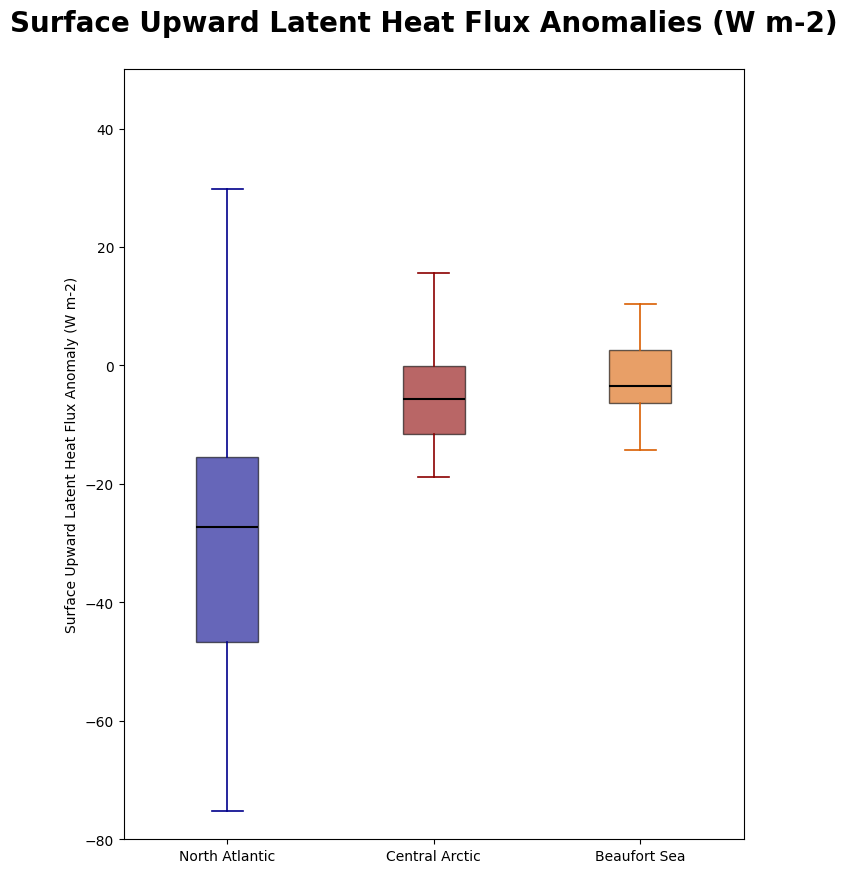

In [107]:
plot_box_years(NA_anomalies_hfls_new,CA_anomalies_hfls_new,BS_anomalies_hfls_new,f'Surface Upward Latent Heat Flux Anomalies ({data_in_hfls.units})',f'Surface Upward Latent Heat Flux Anomaly ({data_in_hfls.units})',-80,50)

In [108]:
#Get list of climatology for each domain 
var = 'hfls'
ds_clim = hfls_clim_DJF

NA_clim = ds_clim.where((ds_clim.lat>=67) & (ds_clim.lat<=80) & (ds_clim.lon>=-30) & (ds_clim.lon<=60))
CA_clim = ds_clim.where((ds_clim.lat>=80) & (ds_clim.lat<=90) & (ds_clim.lon>=-180) & (ds_clim.lon<=180))
BS_clim = ds_clim.where(
((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) &  ((ds_clim.lon >= -180) & (ds_clim.lon <= -120)) |
    ((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) & ((ds_clim.lon >= 120) & (ds_clim.lon <= 180)))

clim_list = [NA_clim, CA_clim, BS_clim]

#Save the lists as pkl files once


with open(f'{ERA5_clim_path}/shapelists/{var}_clim_list.pkl', 'wb') as f:
    pickle.dump(clim_list, f)

with open(f'{ERA5_clim_path}/shapelists/hfls_clim_list.pkl', 'rb') as f:
        hfls_clim_list = pickle.load(f)

In [109]:
with open(f'{ERA5_clim_path}/shapelists/hfls_clim_list.pkl', 'rb') as f:
        hfls_clim_list = pickle.load(f)

clim_NA = hfls_clim_list[0]['hfls'].mean(dim='time').mean(dim=('lat','lon')).values
clim_CA = hfls_clim_list[1]['hfls'].mean(dim='time').mean(dim=('lat','lon')).values
clim_BS = hfls_clim_list[2]['hfls'].mean(dim='time').mean(dim=('lat','lon')).values
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')  

 Clim NA: 54.70 
 CA: 3.88 
 BS: 1.62


 Clim NA: 54.70 
 CA: 3.88 
 BS: 1.62
NA — Mean: -28.5396, Median: -27.2336, Min: -75.2944, Max: 29.8060, Std Dev: 21.9702
CA — Mean: -5.0562, Median: -5.7398, Min: -18.8511, Max: 15.6063, Std Dev: 7.2648
BS — Mean: -2.1603, Median: -3.4422, Min: -14.2755, Max: 10.4262, Std Dev: 5.9937


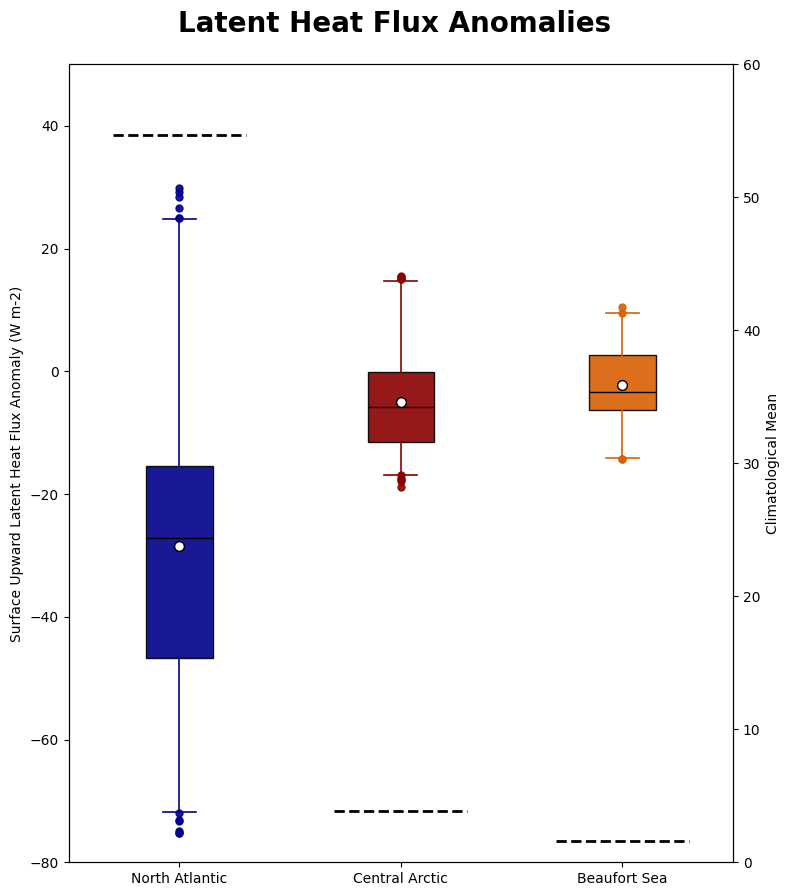

In [110]:
plot_box_years_new(NA_anomalies_hfls_new,CA_anomalies_hfls_new,BS_anomalies_hfls_new,hfls_clim_list,'hfls',f'Latent Heat Flux Anomalies',f'Surface Upward Latent Heat Flux Anomaly (W m-2)',-80,50,0,60)


#### hfss

In [111]:
#surface upward sensible heat flux
ds_hfss = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hfss/r1i1p1/hfss_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_hfss = ds_hfss.sel(lat=slice(50,None))
ds_hfss = ds_hfss.sel(time=slice("1979-01-01","2022-12-31"))

In [112]:
data_in_hfss = ds_hfss['hfss']
data_out_hfss = transform_coords_to_rot(data_in_hfss)

In [113]:
# Create shapes for each domain
NA_shapes_hfss = create_masked_lists(objs_final,ds_moaap,data_out_hfss,80, 67, 60, -30)
CA_shapes_hfss = create_masked_lists(objs_final,ds_moaap,data_out_hfss,90, 80, 180, -180)
BS_shapes_hfss = create_masked_lists(objs_final,ds_moaap,data_out_hfss,80, 70, 120, -120, True)

In [114]:
NA_shapes_hfss = [NA_shapes_hfss[i].compute() for i in range(len(NA_shapes_hfss))]
CA_shapes_hfss = [CA_shapes_hfss[i].compute() for i in range(len(CA_shapes_hfss))]
BS_shapes_hfss = [BS_shapes_hfss[i].compute() for i in range(len(BS_shapes_hfss))]

In [ ]:
plot_scatter_domains(NA_shapes_hfss,CA_shapes_hfss,BS_shapes_hfss,list_ids,f'hfss ({data_in_hfss.units})',f'Surface Upward Sensible Heat Flux ({data_in_hfss.units}) Across Domains')

In [115]:
#Climatology
hfss_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/hfss/clim/clim_day_DJF.nc')
hfss_clim_DJF_sd = hfss_clim_DJF.assign_coords(lon=((hfss_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

In [115]:
hfss_NA_clim_sd = hfss_clim_DJF_sd.where((hfss_clim_DJF_sd.lat>=67) & (hfss_clim_DJF_sd.lat<=80) & (hfss_clim_DJF_sd.lon>=-30) & (hfss_clim_DJF_sd.lon<=60))
hfss_CA_clim_sd = hfss_clim_DJF_sd.where((hfss_clim_DJF_sd.lat>=80) & (hfss_clim_DJF_sd.lat<=90) & (hfss_clim_DJF_sd.lon>=-180) & (hfss_clim_DJF_sd.lon<=180))
hfss_BS_clim_sd = hfss_clim_DJF_sd.where(
    ((hfss_clim_DJF_sd.lat >= 70) & (hfss_clim_DJF_sd.lat <= 80)) &  ((hfss_clim_DJF_sd.lon >= -180) & (hfss_clim_DJF_sd.lon <= -120)) |  ((hfss_clim_DJF_sd.lat >= 70) & (hfss_clim_DJF_sd.lat <= 80)) & ((hfss_clim_DJF_sd.lon >= 120) & (hfss_clim_DJF_sd.lon <= 180)))

In [ ]:
plot_masked_shapes_clim(NA_shapes_hfss, CA_shapes_hfss, BS_shapes_hfss,
                                   hfss_NA_clim_sd['hfss'].mean(dim=("lat","lon")),hfss_CA_clim_sd['hfss'].mean(dim=("lat","lon")),hfss_BS_clim_sd['hfss'].mean(dim=("lat","lon")),
                                   list_ids,f'hfss [{data_in_hfss.units}]', f'Surface Upward Sensible Heat Flux [{data_in_hfss.units}] Across Domains',vmin=-90,vmax=70,clim=True)


In [ ]:
# Create mean values for each domain using the shape aphfssoach
hfss_list_domains = create_masked_lists_shapes(data_out_hfss,domains)

#Plot
plot_masked_shapes_clim(hfss_list_domains[0], hfss_list_domains[1], hfss_list_domains[2],
                                   hfss_NA_clim_sd['hfss'].mean(dim=("lat","lon")),hfss_CA_clim_sd['hfss'].mean(dim=("lat","lon")),hfss_BS_clim_sd['hfss'].mean(dim=("lat","lon")),
                                   list_ids,f'hfss [{data_in_hfss.units}]', f'Surface Upward Sensible Heat Flux [{data_in_hfss.units}] Across Domains',vmin=-90,vmax=70,clim=True)


##### Anomalies

In [116]:
NA_hfss_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hfss,hfss_clim_DJF["hfss"],80, 67, 60, -30)
CA_hfss_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hfss,hfss_clim_DJF["hfss"],90, 80, 180, -180)
BS_hfss_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_hfss,hfss_clim_DJF["hfss"],80, 70, 120, -120, True)

In [117]:
NA_hfss_anomalies = [NA_hfss_anomalies[i].compute() for i in range(len(NA_hfss_anomalies))]
CA_hfss_anomalies = [CA_hfss_anomalies[i].compute() for i in range(len(CA_hfss_anomalies))]
BS_hfss_anomalies = [BS_hfss_anomalies[i].compute() for i in range(len(BS_hfss_anomalies))]

In [ ]:
plot_masked_shapes_clim(NA_hfss_anomalies,CA_hfss_anomalies,BS_hfss_anomalies,
                                   hfss_NA_clim_sd['hfss'].mean(dim=("lat","lon")),hfss_CA_clim_sd['hfss'].mean(dim=("lat","lon")),hfss_BS_clim_sd['hfss'].mean(dim=("lat","lon")),
                                   list_ids,f'hfss anomaly [{data_in_hfss.units}]',f'Surface Upward Sensible Heat Flux Anomalies [{data_in_hfss.units}] Across Domains',vmin =-100, vmax = 60,bars=False)


In [119]:
NA_anomalies_hfss_new = np.concatenate([da.values.flatten() for da in NA_hfss_anomalies if da is not None])
CA_anomalies_hfss_new = np.concatenate([da.values.flatten() for da in CA_hfss_anomalies if da is not None])
BS_anomalies_hfss_new = np.concatenate([da.values.flatten() for da in BS_hfss_anomalies if da is not None])

NA — Mean: -53.5527, Median: -56.1111, Min: -92.7202, Max: 10.0728, Std Dev: 20.2283
CA — Mean: -29.7363, Median: -31.4475, Min: -59.2550, Max: 18.8862, Std Dev: 12.2275
BS — Mean: -18.1021, Median: -18.5826, Min: -40.6214, Max: 18.1509, Std Dev: 13.2780


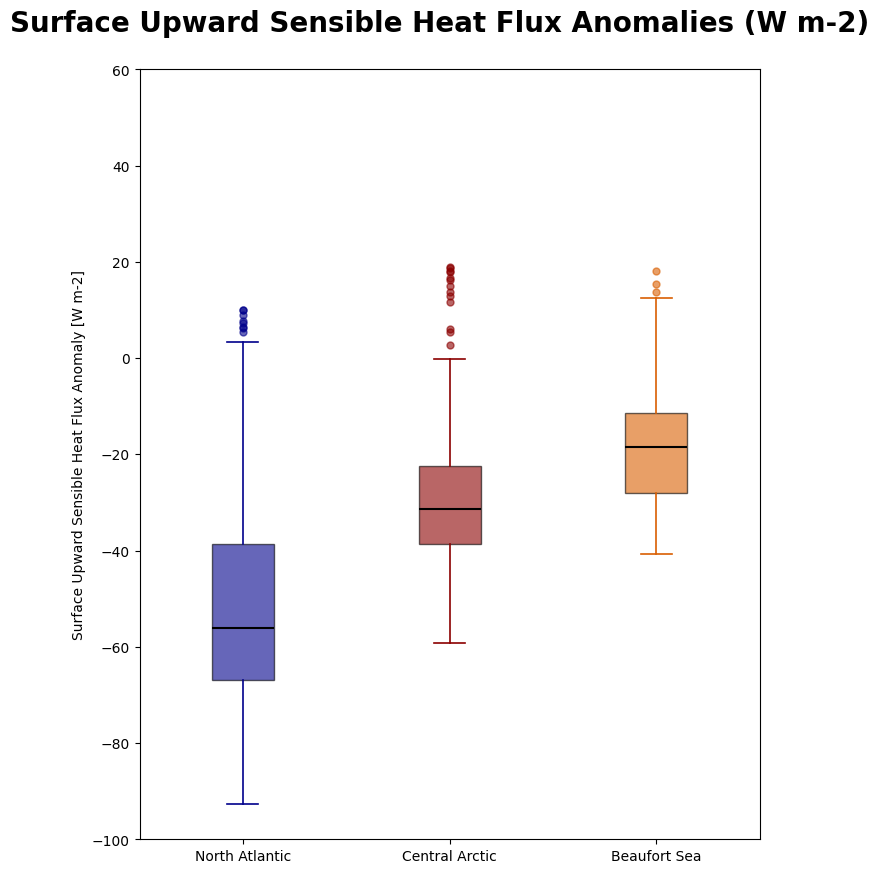

In [120]:
plot_box_years(NA_anomalies_hfss_new,CA_anomalies_hfss_new,BS_anomalies_hfss_new,f'Surface Upward Sensible Heat Flux Anomalies ({data_in_hfss.units})',f'Surface Upward Sensible Heat Flux Anomaly [{data_in_hfss.units}]',-100,60)

In [121]:
#Get list of climatology for each domain 
var = 'hfss'
ds_clim = hfss_clim_DJF

NA_clim = ds_clim.where((ds_clim.lat>=67) & (ds_clim.lat<=80) & (ds_clim.lon>=-30) & (ds_clim.lon<=60))
CA_clim = ds_clim.where((ds_clim.lat>=80) & (ds_clim.lat<=90) & (ds_clim.lon>=-180) & (ds_clim.lon<=180))
BS_clim = ds_clim.where(
((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) &  ((ds_clim.lon >= -180) & (ds_clim.lon <= -120)) |
    ((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) & ((ds_clim.lon >= 120) & (ds_clim.lon <= 180)))

clim_list = [NA_clim, CA_clim, BS_clim]

#Save the lists as pkl files once


with open(f'{ERA5_clim_path}/shapelists/{var}_clim_list.pkl', 'wb') as f:
    pickle.dump(clim_list, f)

with open(f'{ERA5_clim_path}/shapelists/hfss_clim_list.pkl', 'rb') as f:
        hfss_clim_list = pickle.load(f)

In [122]:
with open(f'{ERA5_clim_path}/shapelists/hfss_clim_list.pkl', 'rb') as f:
        hfss_clim_list = pickle.load(f)

clim_NA = hfss_clim_list[0]['hfss'].mean(dim='time').mean(dim=('lat','lon')).values
clim_CA = hfss_clim_list[1]['hfss'].mean(dim='time').mean(dim=('lat','lon')).values
clim_BS = hfss_clim_list[2]['hfss'].mean(dim='time').mean(dim=('lat','lon')).values
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')  

 Clim NA: 50.28 
 CA: 1.18 
 BS: -2.69


 Clim NA: 50.28 
 CA: 1.18 
 BS: -2.69
NA — Mean: -53.5527, Median: -56.1111, Min: -92.7202, Max: 10.0728, Std Dev: 20.2283
CA — Mean: -29.7363, Median: -31.4475, Min: -59.2550, Max: 18.8862, Std Dev: 12.2275
BS — Mean: -18.1021, Median: -18.5826, Min: -40.6214, Max: 18.1509, Std Dev: 13.2780


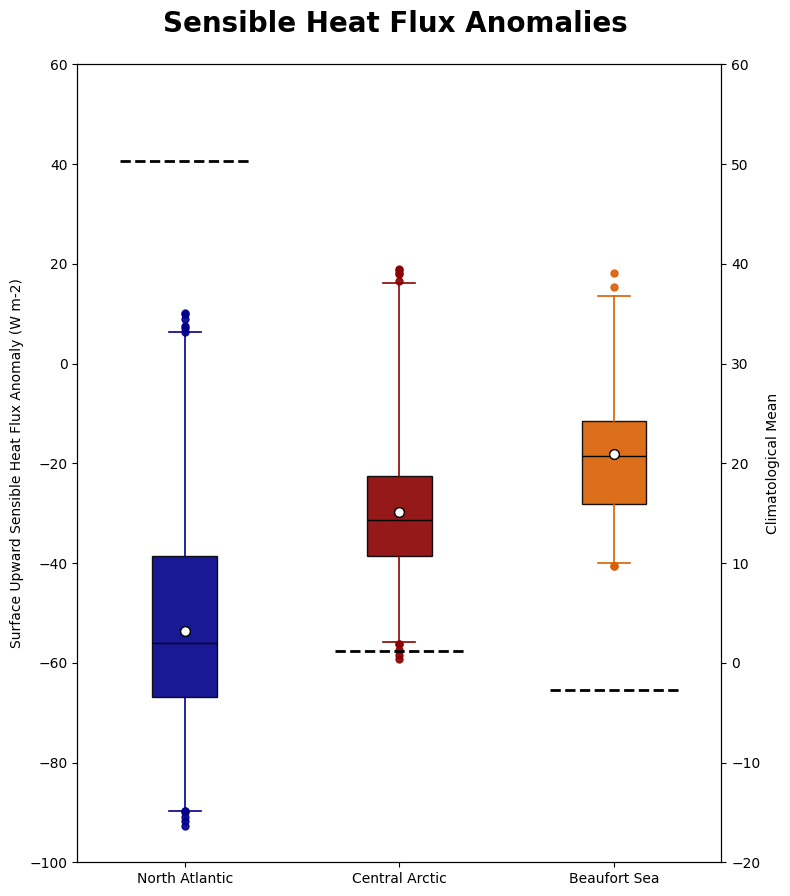

In [123]:
plot_box_years_new(NA_anomalies_hfss_new,CA_anomalies_hfss_new,BS_anomalies_hfss_new,hfss_clim_list,'hfss',f'Sensible Heat Flux Anomalies',f'Surface Upward Sensible Heat Flux Anomaly (W m-2)',-100,60,-20,60)


#### clivi

In [124]:
#ice water path
ds_clivi = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/clivi/r1i1p1/clivi_1hr_reanalysis_era5_r1i1p1_*.nc',chunks={"time":10}) 
ds_clivi = ds_clivi.sel(lat=slice(50,None))
ds_clivi = ds_clivi.sel(time=slice("1979-01-01","2022-12-31"))

data_in_clivi = ds_clivi['clivi']
data_out_clivi = transform_coords_to_rot(data_in_clivi)


In [126]:

# Create shapes for each domain
NA_shapes_clivi = create_masked_lists(objs_final,ds_moaap,data_out_clivi,80, 67, 60, -30)
CA_shapes_clivi = create_masked_lists(objs_final,ds_moaap,data_out_clivi,90, 80, 180, -180)
BS_shapes_clivi = create_masked_lists(objs_final,ds_moaap,data_out_clivi,80, 70, 120, -120, True)

#Compute lists
NA_shapes_clivi = [NA_shapes_clivi[i].compute() for i in range(len(NA_shapes_clivi))]
CA_shapes_clivi = [CA_shapes_clivi[i].compute() for i in range(len(CA_shapes_clivi))]
BS_shapes_clivi = [BS_shapes_clivi[i].compute() for i in range(len(BS_shapes_clivi))]


In [ ]:
plot_scatter_domains(NA_shapes_clivi,CA_shapes_clivi,BS_shapes_clivi,list_ids,f'clivi [{data_in_clivi.units}]',f'Ice Water Path [{data_in_clivi.units}] Across Domains')

In [127]:
clivi_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/clivi/clim/clivi_clim_day_DJF.nc')

In [58]:
#Climatology
clivi_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/clivi/clim/clivi_clim_day_DJF.nc')
clivi_clim_DJF_sd = clivi_clim_DJF.assign_coords(lon=((clivi_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

clivi_NA_clim_sd = clivi_clim_DJF_sd.where((clivi_clim_DJF_sd.lat>=67) & (clivi_clim_DJF_sd.lat<=80) & (clivi_clim_DJF_sd.lon>=-30) & (clivi_clim_DJF_sd.lon<=60))
clivi_CA_clim_sd = clivi_clim_DJF_sd.where((clivi_clim_DJF_sd.lat>=80) & (clivi_clim_DJF_sd.lat<=90) & (clivi_clim_DJF_sd.lon>=-180) & (clivi_clim_DJF_sd.lon<=180))
clivi_BS_clim_sd = clivi_clim_DJF_sd.where(
    ((clivi_clim_DJF_sd.lat >= 70) & (clivi_clim_DJF_sd.lat <= 80)) &  ((clivi_clim_DJF_sd.lon >= -180) & (clivi_clim_DJF_sd.lon <= -120)) |  ((clivi_clim_DJF_sd.lat >= 70) & (clivi_clim_DJF_sd.lat <= 80)) & ((clivi_clim_DJF_sd.lon >= 120) & (clivi_clim_DJF_sd.lon <= 180)))


In [ ]:
plot_masked_shapes_clim(NA_shapes_clivi, CA_shapes_clivi, BS_shapes_clivi,
                                   clivi_NA_clim_sd['clivi'].mean(dim=("lat","lon")),clivi_CA_clim_sd['clivi'].mean(dim=("lat","lon")),clivi_BS_clim_sd['clivi'].mean(dim=("lat","lon")),
                                   list_ids,f'clivi [{data_in_clivi.units}]', f'Ice Water Path [{data_in_clivi.units}] Across Domains',vmin=-0.08,vmax=0.25,clim=True)


##### Anomalies

In [35]:
objs_final

[]

In [129]:
NA_clivi_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_clivi,clivi_clim_DJF["clivi"],80, 67, 60, -30)
CA_clivi_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_clivi,clivi_clim_DJF["clivi"],90, 80, 180, -180)
BS_clivi_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_clivi,clivi_clim_DJF["clivi"],80, 70, 120, -120, True)

NA_clivi_anomalies = [NA_clivi_anomalies[i].compute() for i in range(len(NA_clivi_anomalies))]
CA_clivi_anomalies = [CA_clivi_anomalies[i].compute() for i in range(len(CA_clivi_anomalies))]
BS_clivi_anomalies = [BS_clivi_anomalies[i].compute() for i in range(len(BS_clivi_anomalies))]


In [ ]:
plot_masked_shapes_clim(NA_clivi_anomalies,CA_clivi_anomalies,BS_clivi_anomalies,
                                   clivi_NA_clim_sd['clivi'].mean(dim=("lat","lon")),clivi_CA_clim_sd['clivi'].mean(dim=("lat","lon")),clivi_BS_clim_sd['clivi'].mean(dim=("lat","lon")),
                                   list_ids,f'clivi anomaly [{data_in_clivi.units}]',f'Ice Water Path Anomalies [{data_in_clivi.units}] Across Domains',vmin =-0.04, vmax = 0.25,bars=False)


In [131]:
NA_anomalies_clivi_new = np.concatenate([da.values.flatten() for da in NA_clivi_anomalies if da is not None])
CA_anomalies_clivi_new = np.concatenate([da.values.flatten() for da in CA_clivi_anomalies if da is not None])
BS_anomalies_clivi_new = np.concatenate([da.values.flatten() for da in BS_clivi_anomalies if da is not None])

NA — Mean: 0.0464, Median: 0.0404, Min: -0.0219, Max: 0.1920, Std Dev: 0.0457
CA — Mean: 0.0397, Median: 0.0335, Min: -0.0105, Max: 0.1819, Std Dev: 0.0399
BS — Mean: 0.0365, Median: 0.0356, Min: -0.0107, Max: 0.1160, Std Dev: 0.0196


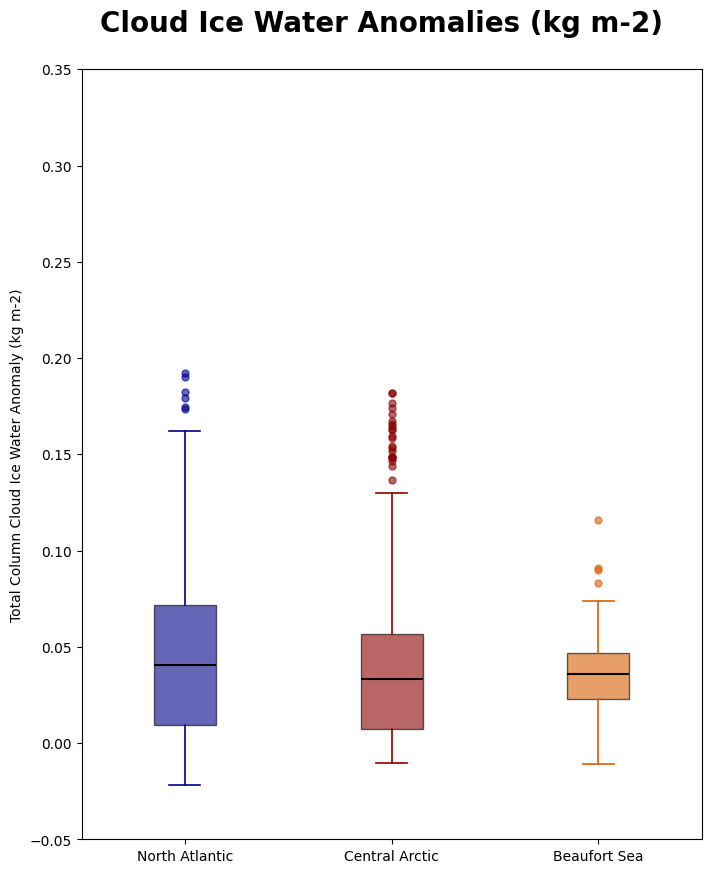

In [132]:
plot_box_years(NA_anomalies_clivi_new,CA_anomalies_clivi_new,BS_anomalies_clivi_new,f'Cloud Ice Water Anomalies ({data_in_clivi.units})',f'Total Column Cloud Ice Water Anomaly ({data_in_clivi.units})',-0.05,0.35)

In [133]:
#Get list of climatology for each domain 
var = 'clivi'
ds_clim = clivi_clim_DJF

NA_clim = ds_clim.where((ds_clim.lat>=67) & (ds_clim.lat<=80) & (ds_clim.lon>=-30) & (ds_clim.lon<=60))
CA_clim = ds_clim.where((ds_clim.lat>=80) & (ds_clim.lat<=90) & (ds_clim.lon>=-180) & (ds_clim.lon<=180))
BS_clim = ds_clim.where(
((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) &  ((ds_clim.lon >= -180) & (ds_clim.lon <= -120)) |
    ((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) & ((ds_clim.lon >= 120) & (ds_clim.lon <= 180)))

clim_list = [NA_clim, CA_clim, BS_clim]

#Save the lists as pkl files once


with open(f'{ERA5_clim_path}/shapelists/{var}_clim_list.pkl', 'wb') as f:
    pickle.dump(clim_list, f)

with open(f'{ERA5_clim_path}/shapelists/clivi_clim_list.pkl', 'rb') as f:
        clivi_clim_list = pickle.load(f)

In [134]:
with open(f'{ERA5_clim_path}/shapelists/clivi_clim_list.pkl', 'rb') as f:
        clivi_clim_list = pickle.load(f)

clim_NA = clivi_clim_list[0]['clivi'].mean(dim='time').mean(dim=('lat','lon')).values
clim_CA = clivi_clim_list[1]['clivi'].mean(dim='time').mean(dim=('lat','lon')).values
clim_BS = clivi_clim_list[2]['clivi'].mean(dim='time').mean(dim=('lat','lon')).values
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')  

 Clim NA: 0.04 
 CA: 0.02 
 BS: 0.02


 Clim NA: 0.04 
 CA: 0.02 
 BS: 0.02
NA — Mean: 0.0464, Median: 0.0404, Min: -0.0219, Max: 0.1920, Std Dev: 0.0457
CA — Mean: 0.0397, Median: 0.0335, Min: -0.0105, Max: 0.1819, Std Dev: 0.0399
BS — Mean: 0.0365, Median: 0.0356, Min: -0.0107, Max: 0.1160, Std Dev: 0.0196


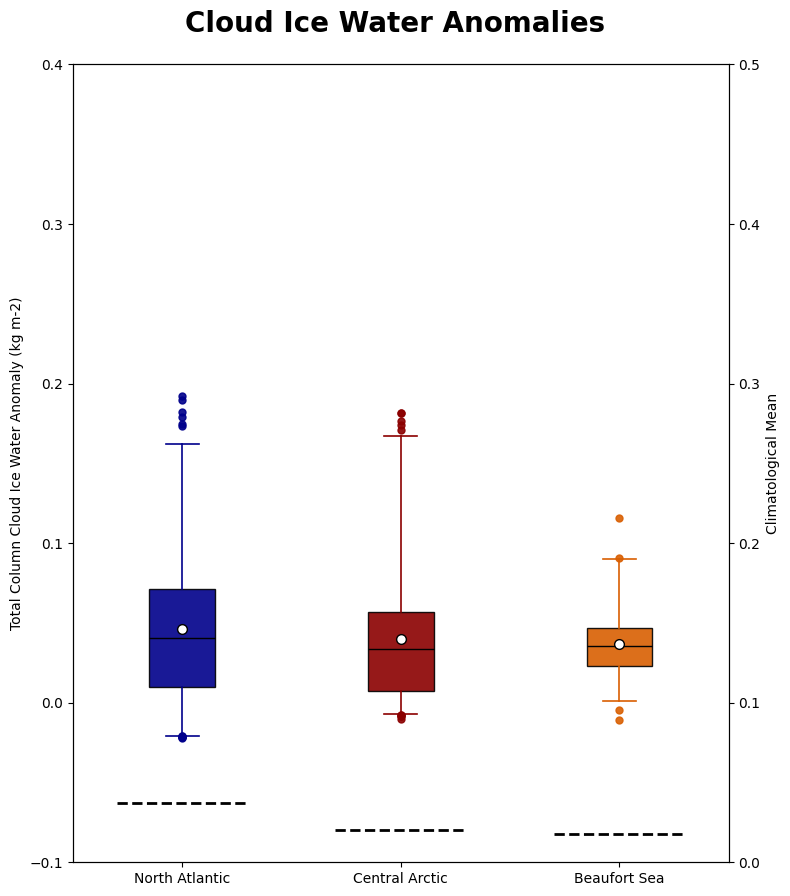

In [135]:
plot_box_years_new(NA_anomalies_clivi_new,CA_anomalies_clivi_new,BS_anomalies_clivi_new,clivi_clim_list,'clivi',f'Cloud Ice Water Anomalies',f'Total Column Cloud Ice Water Anomaly (kg m-2)',-0.1,0.4,0,0.5)


#### clwvi

In [136]:
#condensed water path
ds_clwvi = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/clwvi/r1i1p1/clwvi_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10}) 
ds_clwvi = ds_clwvi.sel(lat=slice(50,None))
ds_clwvi = ds_clwvi.sel(time=slice("1979-01-01","2022-12-31")) 
data_in_clwvi = ds_clwvi['clwvi']
data_out_clwvi = transform_coords_to_rot(data_in_clwvi)


In [137]:
# Create shapes for each domain
NA_shapes_clwvi = create_masked_lists(objs_final,ds_moaap,data_out_clwvi,80, 67, 60, -30)
CA_shapes_clwvi = create_masked_lists(objs_final,ds_moaap,data_out_clwvi,90, 80, 180, -180)
BS_shapes_clwvi = create_masked_lists(objs_final,ds_moaap,data_out_clwvi,80, 70, 120, -120, True)

#Compute lists
NA_shapes_clwvi = [NA_shapes_clwvi[i].compute() for i in range(len(NA_shapes_clwvi))]
CA_shapes_clwvi = [CA_shapes_clwvi[i].compute() for i in range(len(CA_shapes_clwvi))]
BS_shapes_clwvi = [BS_shapes_clwvi[i].compute() for i in range(len(BS_shapes_clwvi))]


In [ ]:
plot_scatter_domains(NA_shapes_clwvi,CA_shapes_clwvi,BS_shapes_clwvi,list_ids,f'clwvi ({data_in_clwvi.units})',f'Condensed Water Path ({data_in_clwvi.units}) Across Domains')

In [ ]:
#Climatology
clwvi_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/clwvi/clim/clwvi_clim_day_DJF.nc')
clwvi_clim_DJF_sd = clwvi_clim_DJF.assign_coords(lon=((clwvi_clim_DJF.lon + 180) % 360) - 180).sortby(['lat','lon'])

clwvi_NA_clim_sd = clwvi_clim_DJF_sd.where((clwvi_clim_DJF_sd.lat>=67) & (clwvi_clim_DJF_sd.lat<=80) & (clwvi_clim_DJF_sd.lon>=-30) & (clwvi_clim_DJF_sd.lon<=60))
clwvi_CA_clim_sd = clwvi_clim_DJF_sd.where((clwvi_clim_DJF_sd.lat>=80) & (clwvi_clim_DJF_sd.lat<=90) & (clwvi_clim_DJF_sd.lon>=-180) & (clwvi_clim_DJF_sd.lon<=180))
clwvi_BS_clim_sd = clwvi_clim_DJF_sd.where(
    ((clwvi_clim_DJF_sd.lat >= 70) & (clwvi_clim_DJF_sd.lat <= 80)) &  ((clwvi_clim_DJF_sd.lon >= -180) & (clwvi_clim_DJF_sd.lon <= -120)) |  ((clwvi_clim_DJF_sd.lat >= 70) & (clwvi_clim_DJF_sd.lat <= 80)) & ((clwvi_clim_DJF_sd.lon >= 120) & (clwvi_clim_DJF_sd.lon <= 180)))


In [138]:
clwvi_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/clwvi/clim/clwvi_clim_day_DJF.nc')

In [ ]:
plot_masked_shapes_clim(NA_shapes_clwvi, CA_shapes_clwvi, BS_shapes_clwvi,
                                   clwvi_NA_clim_sd['clwvi'].mean(dim=("lat","lon")),clwvi_CA_clim_sd['clwvi'].mean(dim=("lat","lon")),clwvi_BS_clim_sd['clwvi'].mean(dim=("lat","lon")),
                                   list_ids,f'clwvi [{data_in_clwvi.units}]', f'Condensed Water Path [{data_in_clwvi.units}] Across Domains',vmin=-0.15,vmax=0.5,clim=True)


##### Anomalies

In [139]:
NA_clwvi_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_clwvi,clwvi_clim_DJF["clwvi"],80, 67, 60, -30)
CA_clwvi_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_clwvi,clwvi_clim_DJF["clwvi"],90, 80, 180, -180)
BS_clwvi_anomalies = create_masked_lists_anomalies(objs_final,ds_moaap,data_out_clwvi,clwvi_clim_DJF["clwvi"],80, 70, 120, -120, True)

NA_clwvi_anomalies = [NA_clwvi_anomalies[i].compute() for i in range(len(NA_clwvi_anomalies))]
CA_clwvi_anomalies = [CA_clwvi_anomalies[i].compute() for i in range(len(CA_clwvi_anomalies))]
BS_clwvi_anomalies = [BS_clwvi_anomalies[i].compute() for i in range(len(BS_clwvi_anomalies))]


In [ ]:
plot_masked_shapes_clim(NA_clwvi_anomalies,CA_clwvi_anomalies,BS_clwvi_anomalies,
                                   clwvi_NA_clim_sd['clwvi'].mean(dim=("lat","lon")),clwvi_CA_clim_sd['clwvi'].mean(dim=("lat","lon")),clwvi_BS_clim_sd['clwvi'].mean(dim=("lat","lon")),
                                   list_ids,f'clwvi anomaly [{data_in_clwvi.units}]',f'Condensed Water Path Anomalies [{data_in_clwvi.units}] Across Domains',vmin =-0.05, vmax =0.35,bars=False) 


In [140]:
NA_anomalies_clwvi_new = np.concatenate([da.values.flatten() for da in NA_clwvi_anomalies if da is not None])
CA_anomalies_clwvi_new = np.concatenate([da.values.flatten() for da in CA_clwvi_anomalies if da is not None])
BS_anomalies_clwvi_new = np.concatenate([da.values.flatten() for da in BS_clwvi_anomalies if da is not None])

NA — Mean: 0.0710, Median: 0.0569, Min: 0.0012, Max: 0.3208, Std Dev: 0.0500
CA — Mean: 0.0476, Median: 0.0440, Min: 0.0034, Max: 0.1192, Std Dev: 0.0235
BS — Mean: 0.0199, Median: 0.0186, Min: -0.0034, Max: 0.0850, Std Dev: 0.0181


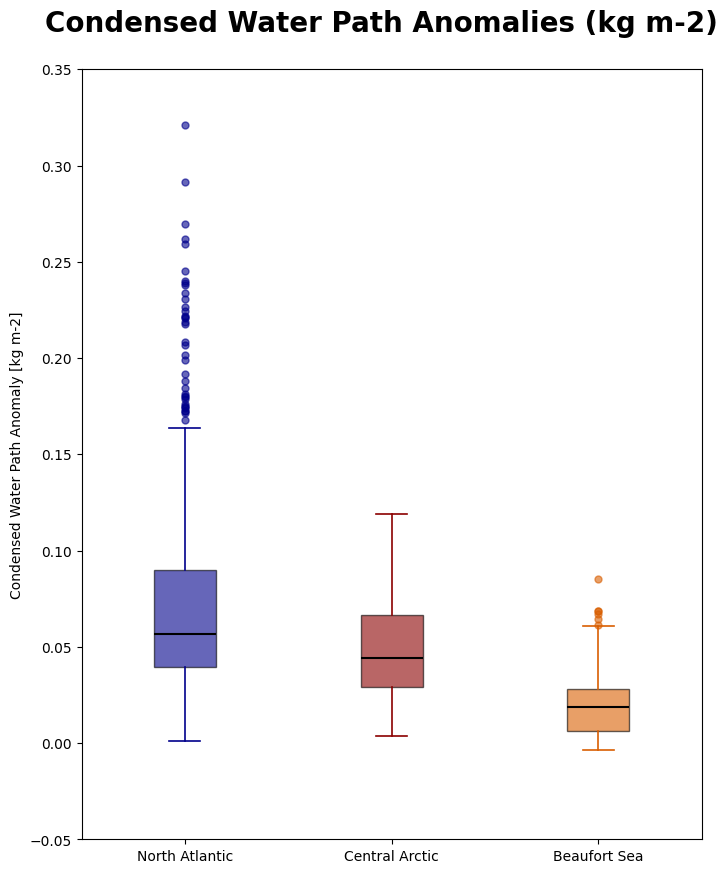

In [141]:
plot_box_years(NA_anomalies_clwvi_new,CA_anomalies_clwvi_new,BS_anomalies_clwvi_new,f'Condensed Water Path Anomalies ({data_in_clwvi.units})',f'Condensed Water Path Anomaly [{data_in_clwvi.units}]',-0.05,0.35)

In [142]:
#Get list of climatology for each domain 
var = 'clwvi'
ds_clim = clwvi_clim_DJF

NA_clim = ds_clim.where((ds_clim.lat>=67) & (ds_clim.lat<=80) & (ds_clim.lon>=-30) & (ds_clim.lon<=60))
CA_clim = ds_clim.where((ds_clim.lat>=80) & (ds_clim.lat<=90) & (ds_clim.lon>=-180) & (ds_clim.lon<=180))
BS_clim = ds_clim.where(
((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) &  ((ds_clim.lon >= -180) & (ds_clim.lon <= -120)) |
    ((ds_clim.lat >= 70) & (ds_clim.lat <= 80)) & ((ds_clim.lon >= 120) & (ds_clim.lon <= 180)))

clim_list = [NA_clim, CA_clim, BS_clim]

#Save the lists as pkl files once


with open(f'{ERA5_clim_path}/shapelists/{var}_clim_list.pkl', 'wb') as f:
    pickle.dump(clim_list, f)

with open(f'{ERA5_clim_path}/shapelists/clwvi_clim_list.pkl', 'rb') as f:
        clwvi_clim_list = pickle.load(f)

In [143]:
with open(f'{ERA5_clim_path}/shapelists/clwvi_clim_list.pkl', 'rb') as f:
        clwvi_clim_list = pickle.load(f)

clim_NA = clwvi_clim_list[0]['clwvi'].mean(dim='time').mean(dim=('lat','lon')).values
clim_CA = clwvi_clim_list[1]['clwvi'].mean(dim='time').mean(dim=('lat','lon')).values
clim_BS = clwvi_clim_list[2]['clwvi'].mean(dim='time').mean(dim=('lat','lon')).values
print(f' Clim NA: {clim_NA:.2f} \n CA: {clim_CA:.2f} \n BS: {clim_BS:.2f}')  

 Clim NA: 0.03 
 CA: 0.01 
 BS: 0.00


 Clim NA: 0.03 
 CA: 0.01 
 BS: 0.00
NA — Mean: 0.0710, Median: 0.0569, Min: 0.0012, Max: 0.3208, Std Dev: 0.0500
CA — Mean: 0.0476, Median: 0.0440, Min: 0.0034, Max: 0.1192, Std Dev: 0.0235
BS — Mean: 0.0199, Median: 0.0186, Min: -0.0034, Max: 0.0850, Std Dev: 0.0181


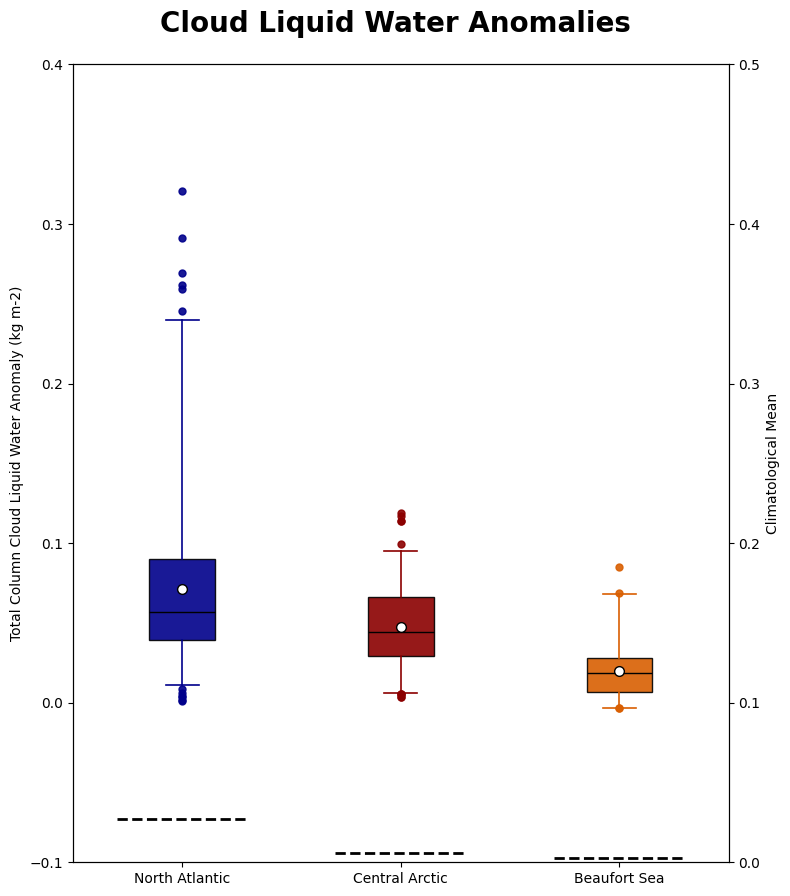

In [144]:
plot_box_years_new(NA_anomalies_clwvi_new,CA_anomalies_clwvi_new,BS_anomalies_clwvi_new,clwvi_clim_list,'clwvi',f'Cloud Liquid Water Anomalies',f'Total Column Cloud Liquid Water Anomaly (kg m-2)',-0.1,0.4,0,0.5)

In [202]:
ua = ds_wind_u.ua.sel(time=objs_final[2].times[50],method='nearest').assign_coords(lon=((vardata.lon + 180) % 360) - 180).sortby(['lat','lon'])
uv = ds_wind_v.va.sel(time=objs_final[2].times[50],method='nearest').assign_coords(lon=((vardata.lon + 180) % 360) - 180).sortby(['lat','lon'])

### Metrics

In [62]:
objs_final[0]

<xarray.Dataset>
Dimensions:          (times: 124)
Coordinates:
  * times            (times) datetime64[ns] 1983-02-25T02:00:00 ... 1983-03-0...
Data variables: (12/17)
    id_              <U5 '40554'
    exp              object <class 'src.Experiments_infos.ERA5'>
    size             (times) float64 5.915e+05 5.838e+05 ... 7.333e+04 1.111e+04
    total_IVT        (times) float32 1.924e+05 1.955e+05 ... 6.677e+03 1.005e+03
    mean_IVT         (times) float32 308.9 317.8 319.1 ... 102.2 101.2 100.5
    max_IVT          (times) float32 425.0 430.5 436.1 ... 105.3 103.2 101.3
    ...               ...
    gridpoints       (times) object [RotatedGridPoint(lat=28.600000381469727,...
    clusters         (times) float64 nan nan nan nan nan ... nan nan nan nan nan
    lat              (times) float32 31.3 31.3 31.3 31.0 ... -1.4 -1.4 -1.1 -1.4
    lon              (times) float32 15.4 15.4 15.1 14.8 ... 9.7 10.3 10.6 11.2
    geo_lat          (times) float64 61.36 61.36 61.5 61.89 ... 77.0 76.94 76.28
    geo_lon          (times) float64 -28.26 -28.26 -27.81 ... -125.5 -125.0

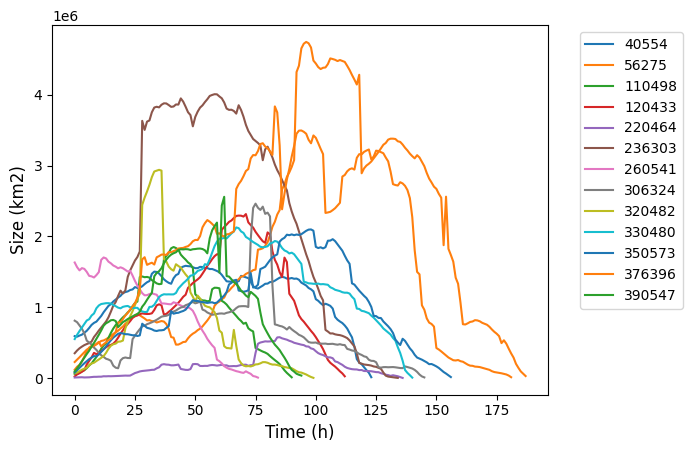

In [98]:
for i in range(len(objs_final)):
    size = objs_final[i].size
    time = np.arange(len(objs_final[i].size))

    plt.plot(time,size,label=f'{objs_final[i].id_.values}')
    plt.xlabel('Time (h)', fontsize=12)
    plt.ylabel('Size (km2)', fontsize=12)

    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')



/tmp/ipykernel_51158/4060939938.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20b', len(objs_final))


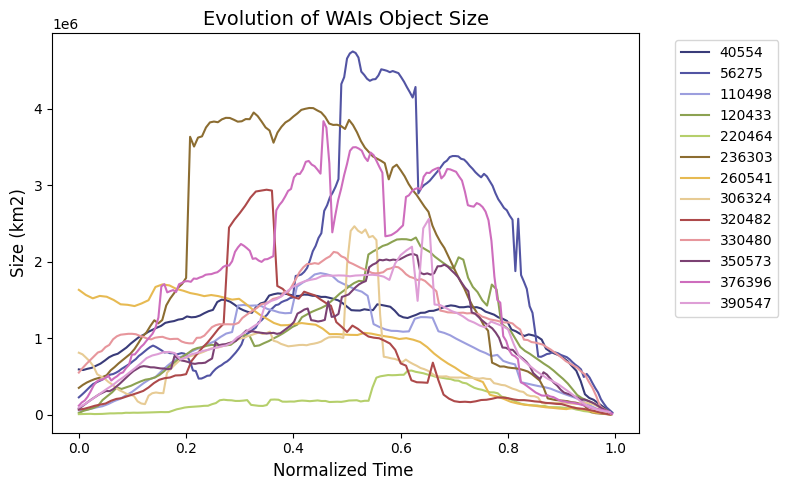

In [95]:
import matplotlib
plt.figure(figsize=(8, 5))

# pick a colormap and generate distinct colors
colors = cm.get_cmap('tab20b', len(objs_final))


for i in range(len(objs_final)):
    size = objs_final[i].size      # number of elements
    time = np.arange(len(objs_final[i].size))    # proper time axis

    # normalize time to [0, 1]
    time_normalized = time / len(time)

    plt.plot(time_normalized, size, label=f'{objs_final[i].id_.values}',color = colors(i))

# Labels and formatting
plt.xlabel('Normalized Time ', fontsize=12)
plt.ylabel('Size (km2)', fontsize=12)
plt.title('Evolution of WAIs Object Size', fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
#plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


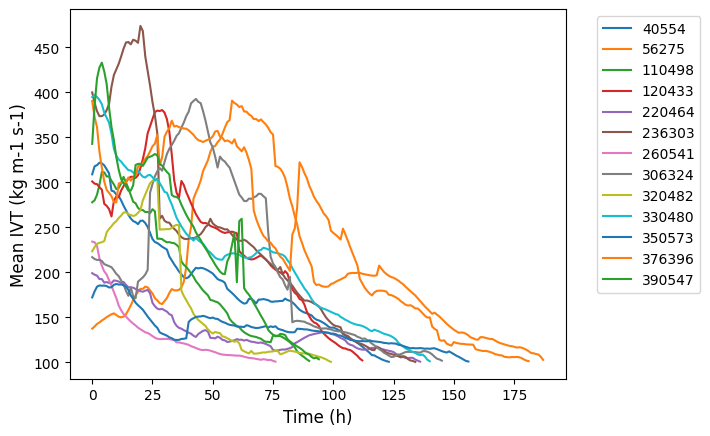

In [100]:
for i in range(len(objs_final)):
    mean_IVT = objs_final[i].mean_IVT
    time = np.arange(len(objs_final[i].mean_IVT))

    plt.plot(time,mean_IVT,label=f'{objs_final[i].id_.values}')
    plt.xlabel('Time (h)', fontsize=12)
    plt.ylabel('Mean IVT (kg m-1 s-1)', fontsize=12)

    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')





/tmp/ipykernel_51158/2006277637.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20b', len(objs_final))


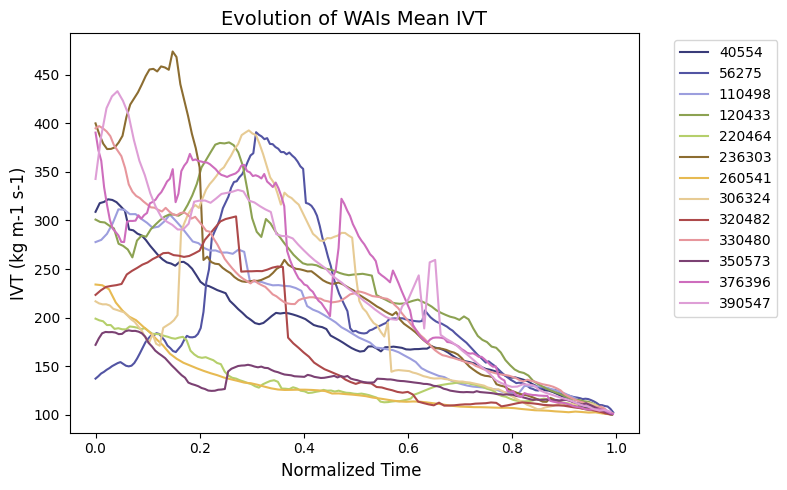

In [94]:
import matplotlib
plt.figure(figsize=(8, 5))

# pick a colormap and generate distinct colors
colors = cm.get_cmap('tab20b', len(objs_final))


for i in range(len(objs_final)):
    IVT = objs_final[i].mean_IVT     # number of elements
    time = np.arange(len(objs_final[i].mean_IVT))    # proper time axis

    # normalize time to [0, 1]
    time_normalized = time / len(time)

    plt.plot(time_normalized, IVT, label=f'{objs_final[i].id_.values}',color = colors(i))

# Labels and formatting
plt.xlabel('Normalized Time ', fontsize=12)
plt.ylabel('IVT (kg m-1 s-1)', fontsize=12)
plt.title('Evolution of WAIs Mean IVT', fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
#plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


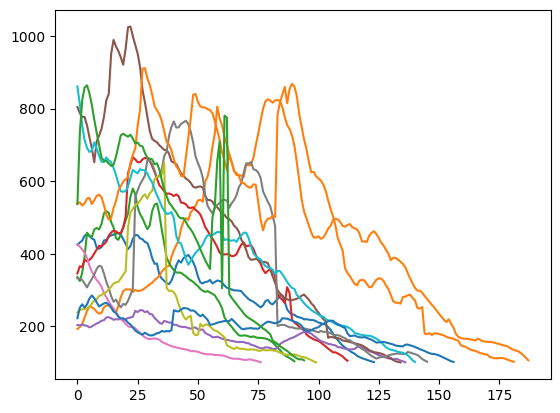

In [68]:
for i in range(len(objs_final)):
    mean_IVT = objs_final[i].max_IVT
    time = np.arange(len(objs_final[i].max_IVT))

    plt.plot(time,mean_IVT)



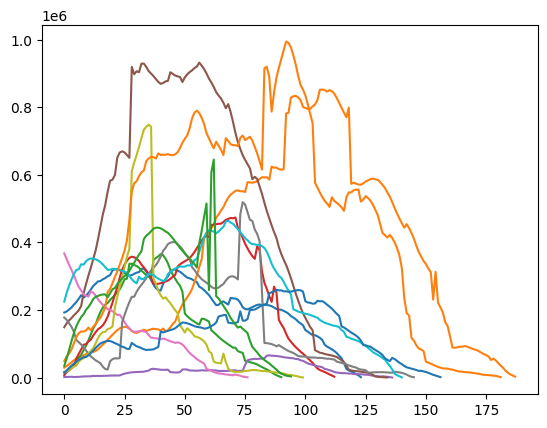

In [71]:
for i in range(len(objs_final)):
    mean_IVT = objs_final[i].total_IVT
    time = np.arange(len(objs_final[i].total_IVT))

    plt.plot(time,mean_IVT)

